In [8]:
import torch
from torch import nn
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
from tqdm.auto import tqdm
from torchvision.utils import make_grid
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!


def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

In [9]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN, 
        corresponding to a transposed convolution, a batchnorm (except for in the last layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''

        #     Steps:
        #       1) Do a transposed convolution using the given parameters.
        #       2) Do a batchnorm, except for the last layer.
        #       3) Follow each batchnorm with a ReLU activation.
        #       4) If its the final layer, use a Tanh activation after the deconvolution.

        # Build the neural block
        if not final_layer:
            return nn.Sequential(
                
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size=kernel_size, stride=stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True)
                
            )
        else: # Final Layer
            return nn.Sequential(
                
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh()
                
            )

    def unsqueeze_noise(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns a copy of that noise with width and height = 1 and channels = z_dim.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        return noise.view(len(noise), self.z_dim, 1, 1)

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = self.unsqueeze_noise(noise)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

In [10]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
    hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=16):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of DCGAN, 
        corresponding to a convolution, a batchnorm (except for in the last layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        #     Steps:
        #       1) Add a convolutional layer using the given parameters.
        #       2) Do a batchnorm, except for the last layer.
        #       3) Follow each batchnorm with a LeakyReLU activation with slope 0.2.
        
        # Build the neural block
        if not final_layer:
            return nn.Sequential(
                
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True)
                
            )
        else: # Final Layer
            return nn.Sequential(
                
                nn.Conv2d(input_channels, output_channels, kernel_size, stride)
                
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_dim)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

In [21]:
criterion = nn.BCEWithLogitsLoss()
z_dim = 64
display_step = 500
batch_size = 4
# A learning rate of 0.0002 works well on DCGAN
lr = 0.0002
# Replace height and width with your desired dimensions, e.g., 64, 64
height, width = 256, 256
beta_1 = 0.5 
beta_2 = 0.999
device = 'cuda'

# Define the transformation
transform = transforms.Compose([
    transforms.Resize((height, width)),  # Resize to desired dimensions
    transforms.Grayscale(num_output_channels=1),  # Convert to single channel (grayscale)
    transforms.ToTensor(),  # Convert the image to a tensor
    transforms.Normalize((0.5,), (0.5,)),  # Normalize to range [-1, 1]
])

# Load dataset
dataset = datasets.ImageFolder(root='images', transform=transform)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

In [22]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
disc = Discriminator().to(device) 
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr, betas=(beta_1, beta_2))

# You initialize the weights to the normal distribution
# with mean 0 and standard deviation 0.02
def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

 47%|████▋     | 160/338 [00:04<00:05, 33.91it/s]

Epoch 1, step 500: Generator loss: 0.7076221157312393, discriminator loss: 0.6498613094091416


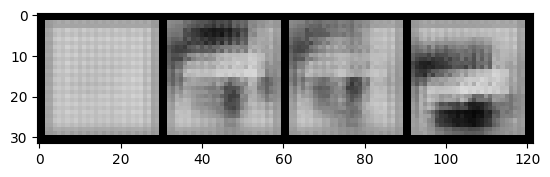

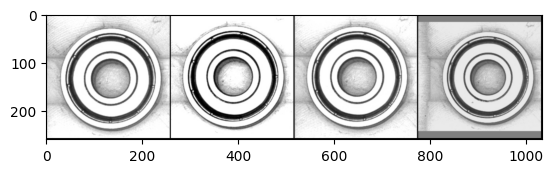

 96%|█████████▌| 324/338 [00:09<00:00, 34.06it/s]

Epoch 2, step 1000: Generator loss: 0.715331050038337, discriminator loss: 0.6740558472871782


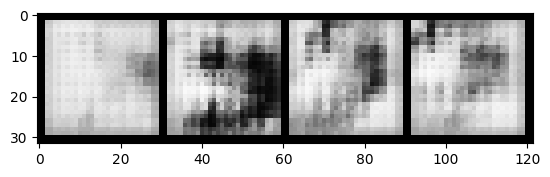

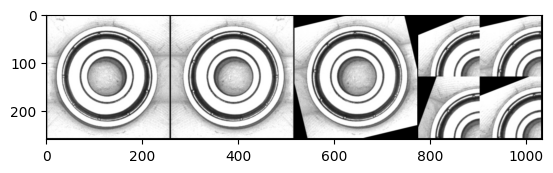

 44%|████▍     | 148/338 [00:04<00:05, 35.71it/s]

Epoch 4, step 1500: Generator loss: 0.7303315618038179, discriminator loss: 0.6747324663400649


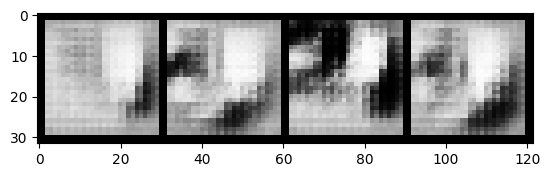

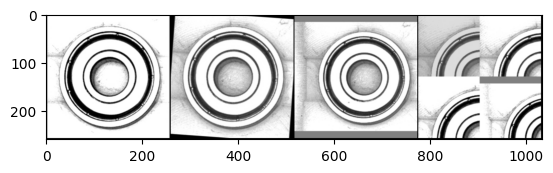

 91%|█████████ | 308/338 [00:08<00:00, 34.10it/s]

Epoch 5, step 2000: Generator loss: 0.7352415066957475, discriminator loss: 0.679008961200714


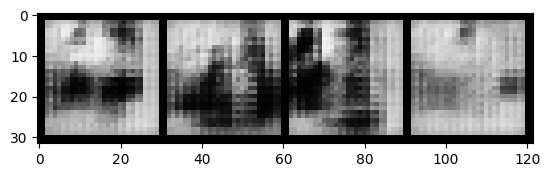

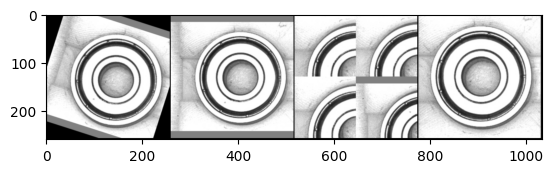

 39%|███▉      | 132/338 [00:03<00:05, 34.88it/s]

Epoch 7, step 2500: Generator loss: 0.735809092283249, discriminator loss: 0.6736546958684931


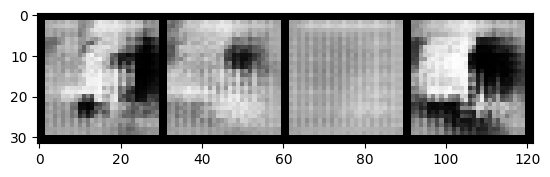

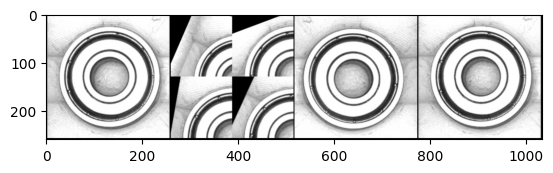

 88%|████████▊ | 296/338 [00:08<00:01, 33.56it/s]

Epoch 8, step 3000: Generator loss: 0.7383198611736291, discriminator loss: 0.6732857557535172


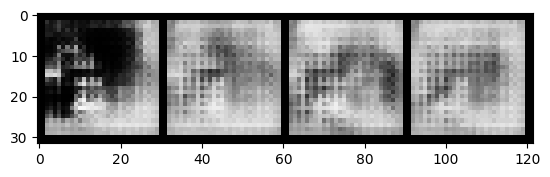

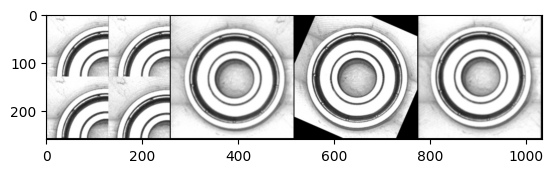

 36%|███▌      | 120/338 [00:03<00:06, 32.51it/s]

Epoch 10, step 3500: Generator loss: 0.726233227491379, discriminator loss: 0.6796475640535351


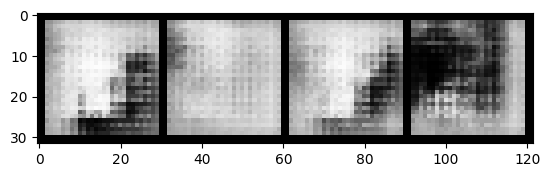

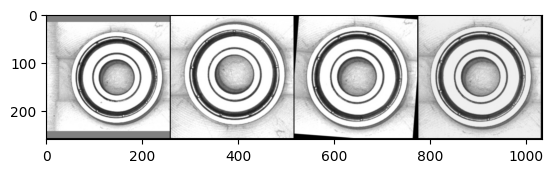

 83%|████████▎ | 280/338 [00:08<00:01, 33.77it/s]

Epoch 11, step 4000: Generator loss: 0.7322005198001854, discriminator loss: 0.6717635627984997


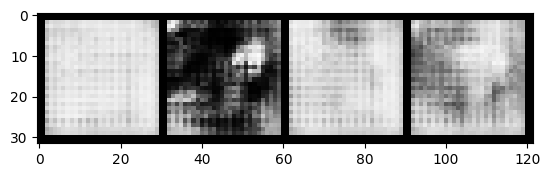

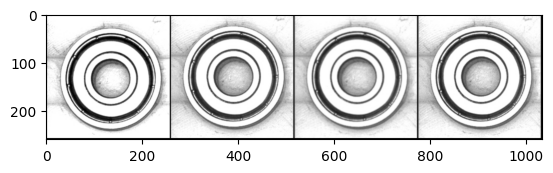

 31%|███       | 104/338 [00:03<00:06, 34.07it/s]

Epoch 13, step 4500: Generator loss: 0.7389784733057021, discriminator loss: 0.6650520824193957


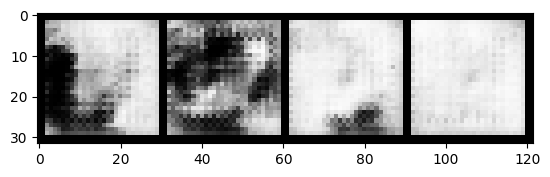

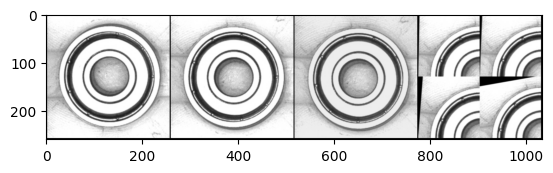

 79%|███████▉  | 268/338 [00:07<00:02, 33.91it/s]

Epoch 14, step 5000: Generator loss: 0.7491601070165639, discriminator loss: 0.6510586361885069


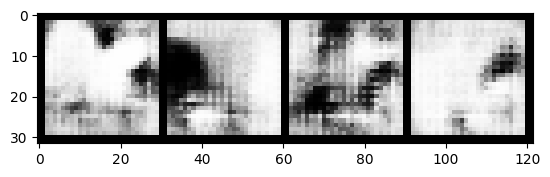

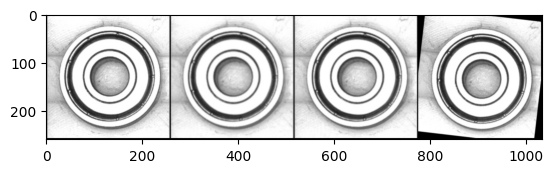

 27%|██▋       | 90/338 [00:02<00:07, 31.11it/s]

Epoch 16, step 5500: Generator loss: 0.7643267960548403, discriminator loss: 0.6475955352783205


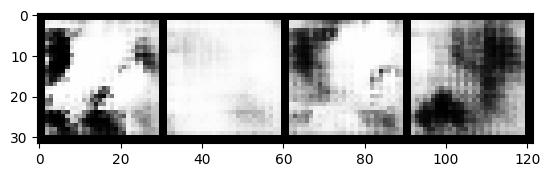

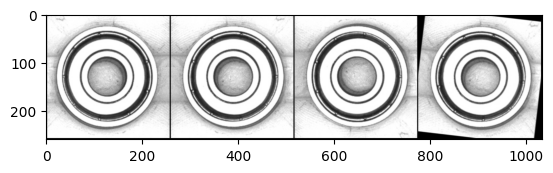

 75%|███████▍  | 252/338 [00:07<00:02, 33.84it/s]

Epoch 17, step 6000: Generator loss: 0.7782751028537748, discriminator loss: 0.6328163727521905


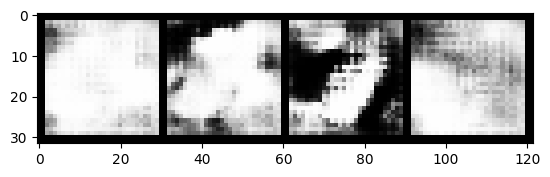

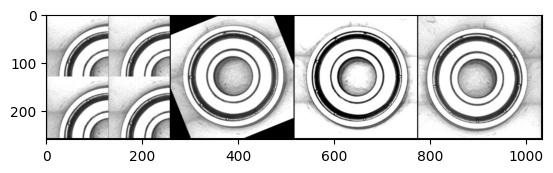

 22%|██▏       | 76/338 [00:02<00:07, 33.46it/s]

Epoch 19, step 6500: Generator loss: 0.8143084250688558, discriminator loss: 0.6124534740447999


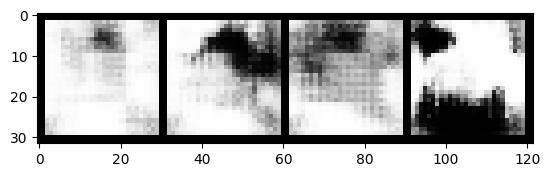

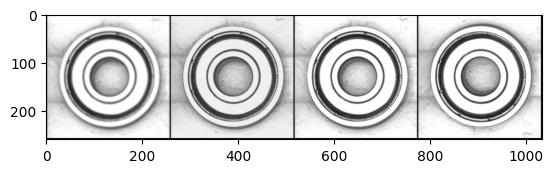

 71%|███████   | 240/338 [00:07<00:03, 31.86it/s]

Epoch 20, step 7000: Generator loss: 0.8464376071691518, discriminator loss: 0.5935559895038606


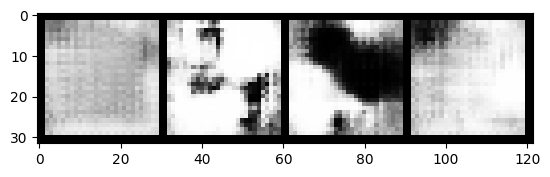

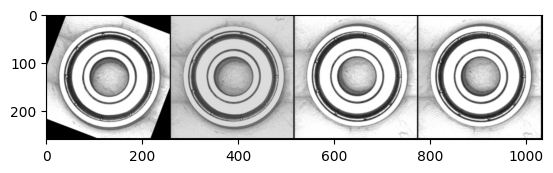

 19%|█▉        | 64/338 [00:01<00:08, 33.21it/s]

Epoch 22, step 7500: Generator loss: 0.8756651178598401, discriminator loss: 0.5810587136745451


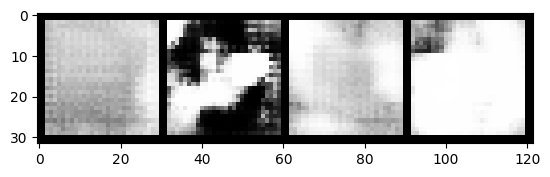

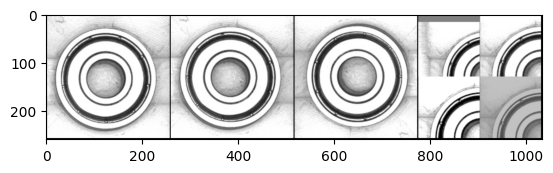

 67%|██████▋   | 226/338 [00:07<00:03, 29.11it/s]

Epoch 23, step 8000: Generator loss: 0.9051257240772246, discriminator loss: 0.5596569303274151


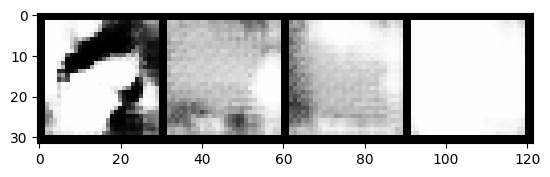

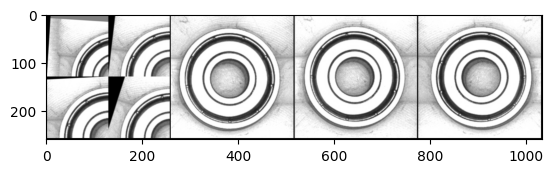

 14%|█▍        | 49/338 [00:01<00:09, 31.03it/s]

Epoch 25, step 8500: Generator loss: 0.9315826746225355, discriminator loss: 0.5442943546772007


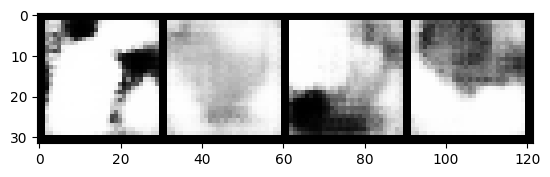

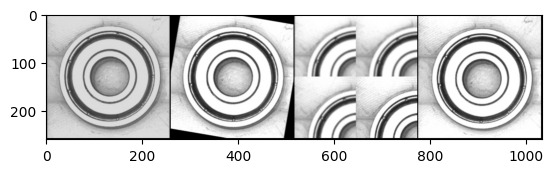

 62%|██████▏   | 209/338 [00:06<00:03, 33.92it/s]

Epoch 26, step 9000: Generator loss: 0.9649275037050249, discriminator loss: 0.5364735532999045


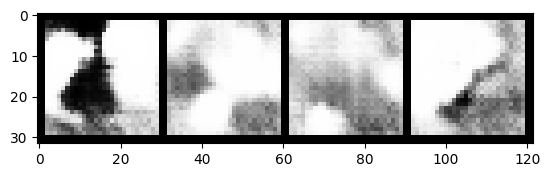

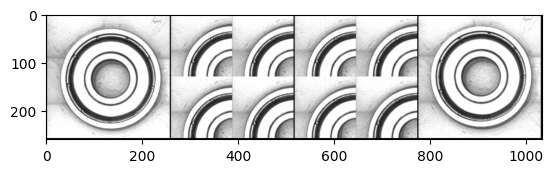

 11%|█         | 36/338 [00:01<00:09, 32.98it/s]

Epoch 28, step 9500: Generator loss: 0.9952942479848859, discriminator loss: 0.5251524850726131


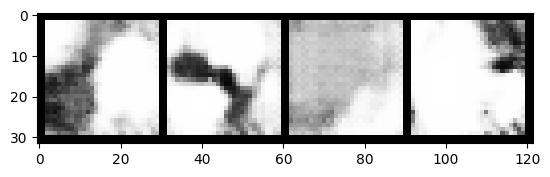

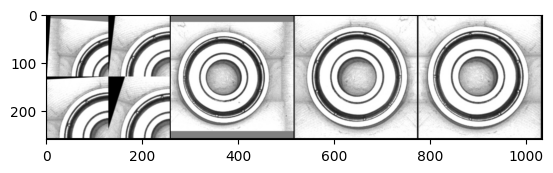

 58%|█████▊    | 196/338 [00:07<00:05, 27.36it/s]

Epoch 29, step 10000: Generator loss: 1.0072988113164896, discriminator loss: 0.5085525650978091


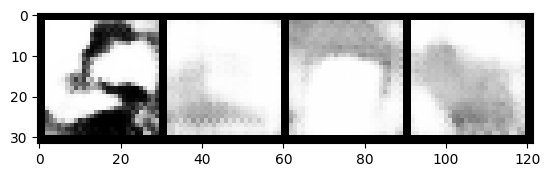

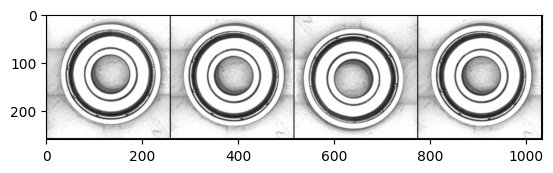

  6%|▌         | 20/338 [00:00<00:09, 33.49it/s]

Epoch 31, step 10500: Generator loss: 1.0517169436216351, discriminator loss: 0.4948267506361009


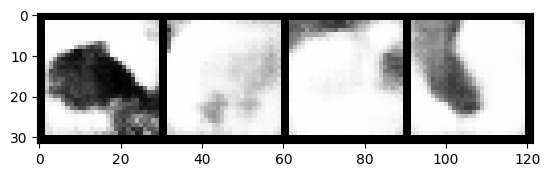

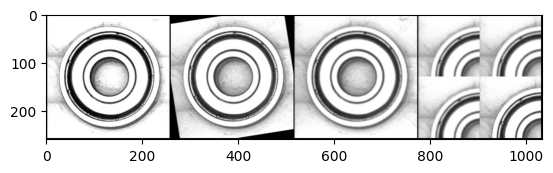

 54%|█████▍    | 184/338 [00:05<00:04, 34.22it/s]

Epoch 32, step 11000: Generator loss: 1.0762167928218829, discriminator loss: 0.48080191957950585


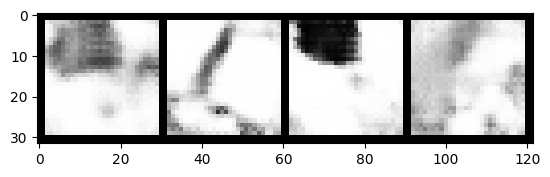

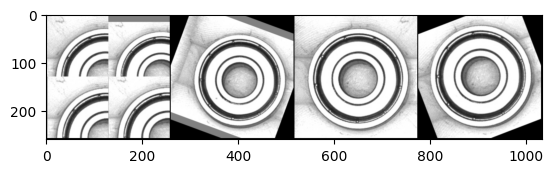

  2%|▏         | 8/338 [00:00<00:09, 34.08it/s]

Epoch 34, step 11500: Generator loss: 1.1284708412885665, discriminator loss: 0.4722409840822219


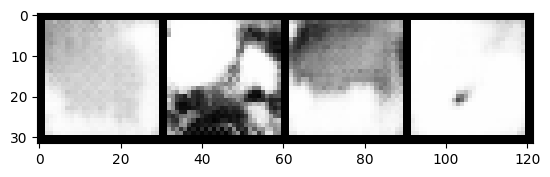

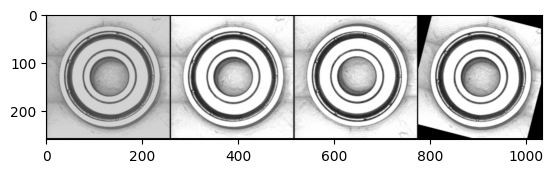

 50%|████▉     | 168/338 [00:04<00:05, 33.19it/s]

Epoch 35, step 12000: Generator loss: 1.1529150044918066, discriminator loss: 0.46089232772588734


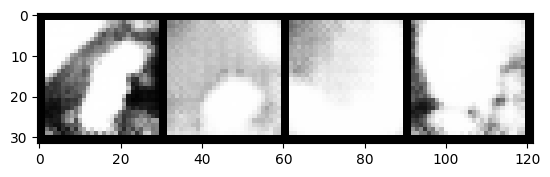

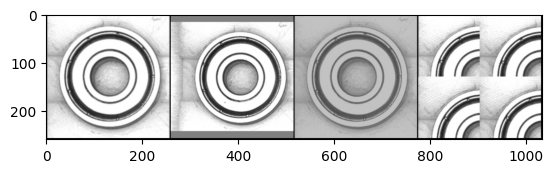

 98%|█████████▊| 332/338 [00:09<00:00, 34.29it/s]

Epoch 36, step 12500: Generator loss: 1.1816260596513752, discriminator loss: 0.4509197572469712


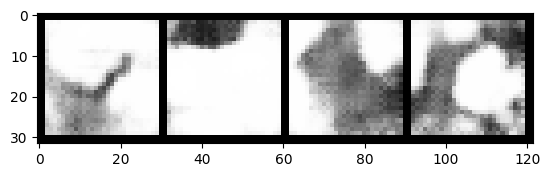

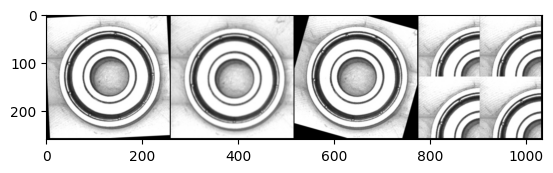

 46%|████▌     | 156/338 [00:04<00:05, 34.45it/s]

Epoch 38, step 13000: Generator loss: 1.202612484216691, discriminator loss: 0.44235365068912513


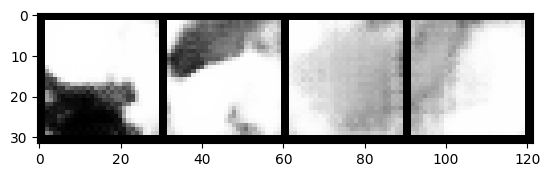

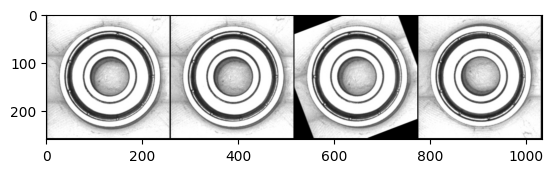

 93%|█████████▎| 316/338 [00:09<00:00, 35.34it/s]

Epoch 39, step 13500: Generator loss: 1.2142365462779996, discriminator loss: 0.42930935293436046


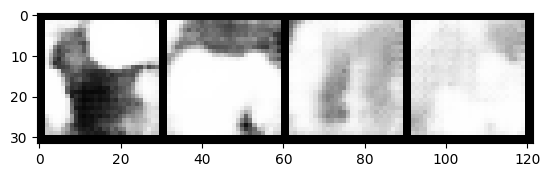

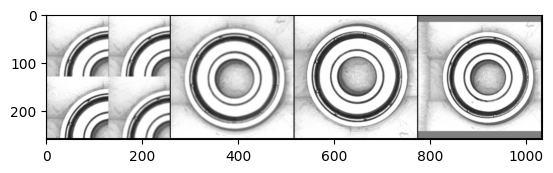

 41%|████▏     | 140/338 [00:04<00:06, 31.44it/s]

Epoch 41, step 14000: Generator loss: 1.2617384473085398, discriminator loss: 0.43555654841661384


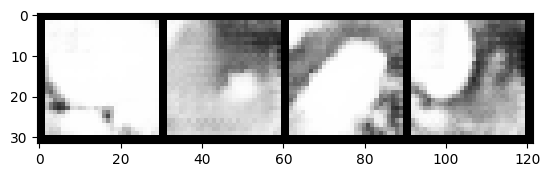

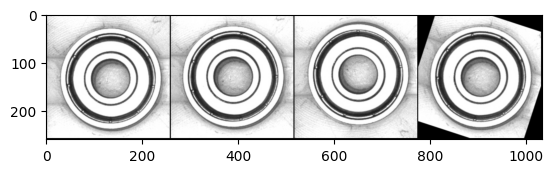

 90%|████████▉ | 304/338 [00:08<00:01, 32.69it/s]

Epoch 42, step 14500: Generator loss: 1.2895972286462791, discriminator loss: 0.4292364216446876


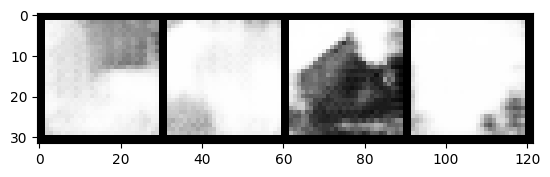

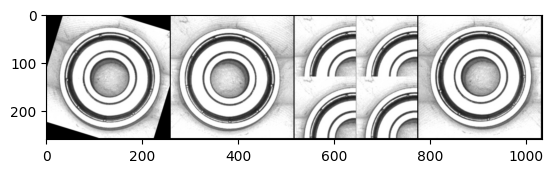

 38%|███▊      | 128/338 [00:03<00:06, 33.71it/s]

Epoch 44, step 15000: Generator loss: 1.2989143546819697, discriminator loss: 0.4283636806607247


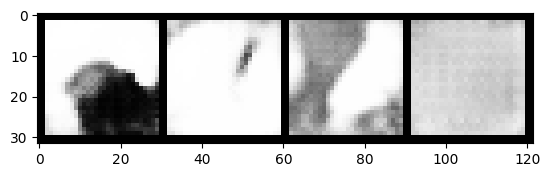

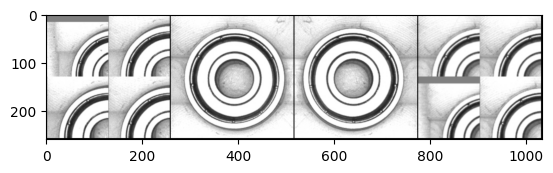

 85%|████████▌ | 288/338 [00:08<00:01, 35.14it/s]

Epoch 45, step 15500: Generator loss: 1.3173207896947872, discriminator loss: 0.42192892971634893


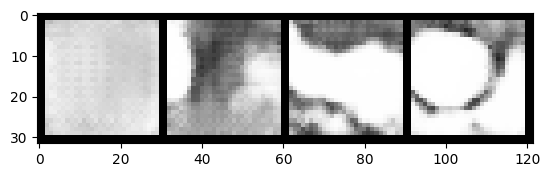

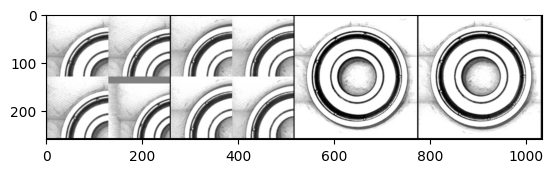

 33%|███▎      | 112/338 [00:03<00:06, 33.41it/s]

Epoch 47, step 16000: Generator loss: 1.325205349206925, discriminator loss: 0.4125303364992141


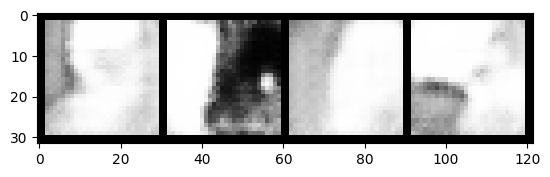

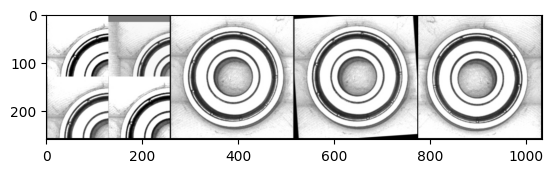

 82%|████████▏ | 276/338 [00:08<00:01, 35.67it/s]

Epoch 48, step 16500: Generator loss: 1.3454972108602532, discriminator loss: 0.4130669466257094


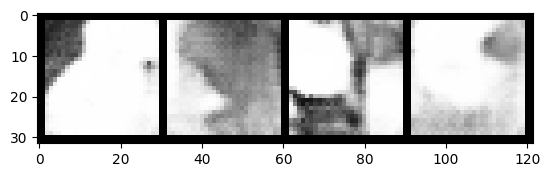

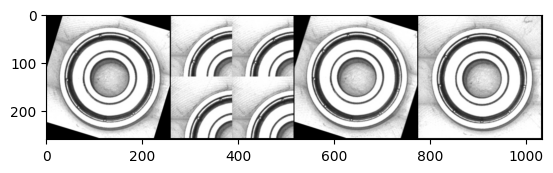

 30%|██▉       | 100/338 [00:02<00:06, 34.88it/s]

Epoch 50, step 17000: Generator loss: 1.3599560182094577, discriminator loss: 0.40564970490336405


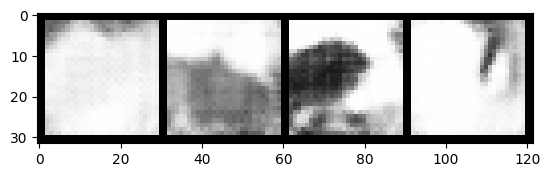

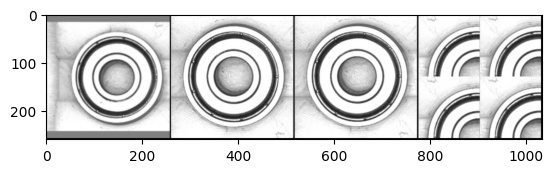

 77%|███████▋  | 260/338 [00:07<00:02, 34.78it/s]

Epoch 51, step 17500: Generator loss: 1.3921827727556233, discriminator loss: 0.4094576764702799


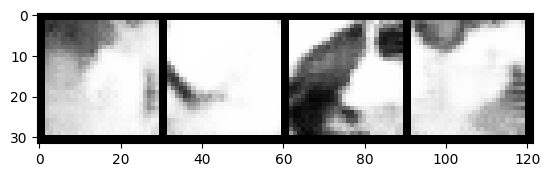

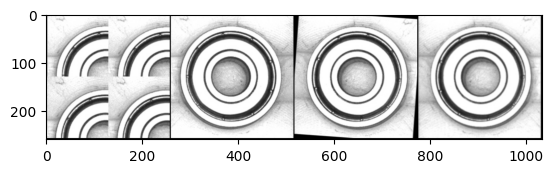

 25%|██▍       | 84/338 [00:02<00:07, 34.86it/s]

Epoch 53, step 18000: Generator loss: 1.4026754274368294, discriminator loss: 0.4045278147757052


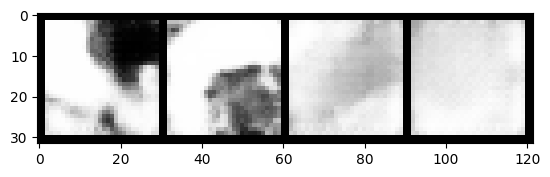

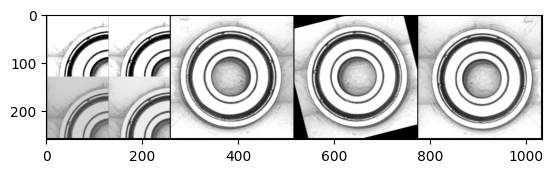

 73%|███████▎  | 248/338 [00:07<00:02, 32.52it/s]

Epoch 54, step 18500: Generator loss: 1.4142534863948832, discriminator loss: 0.39932026046514585


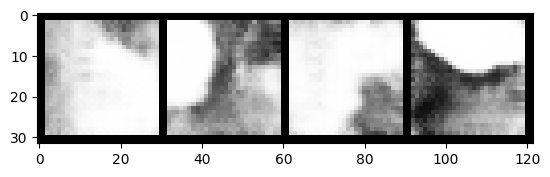

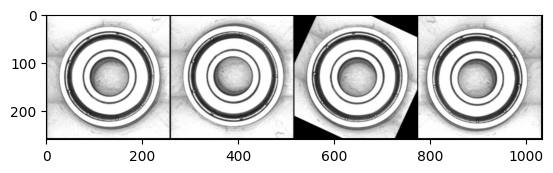

 21%|██▏       | 72/338 [00:02<00:07, 34.42it/s]

Epoch 56, step 19000: Generator loss: 1.4123959980010976, discriminator loss: 0.39064621469378474


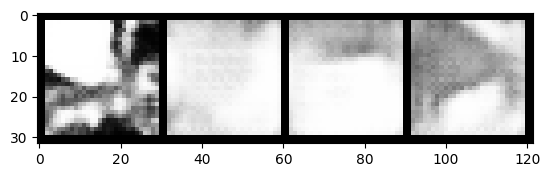

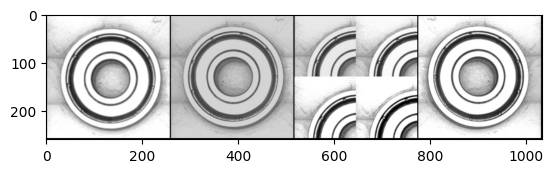

 69%|██████▉   | 234/338 [00:07<00:03, 31.91it/s]

Epoch 57, step 19500: Generator loss: 1.44246038633585, discriminator loss: 0.3836939611136914


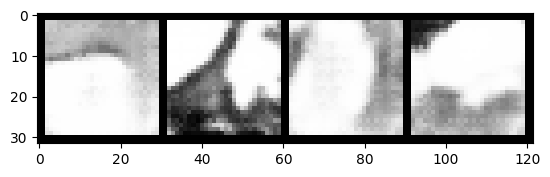

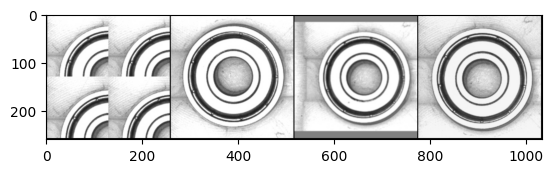

 17%|█▋        | 56/338 [00:01<00:07, 35.82it/s]

Epoch 59, step 20000: Generator loss: 1.4541897447109229, discriminator loss: 0.38902519565820703


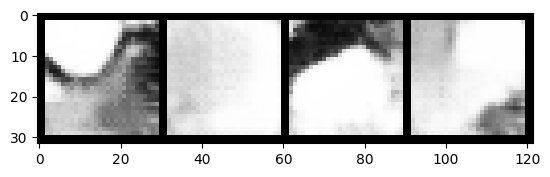

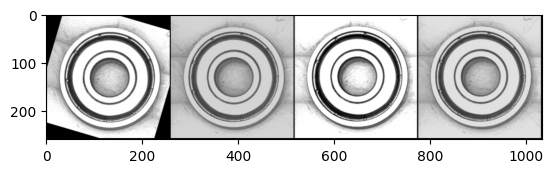

 65%|██████▌   | 220/338 [00:06<00:03, 37.25it/s]

Epoch 60, step 20500: Generator loss: 1.489255172848702, discriminator loss: 0.3766028783321379


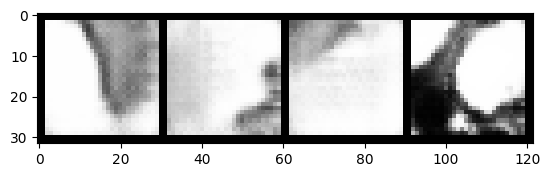

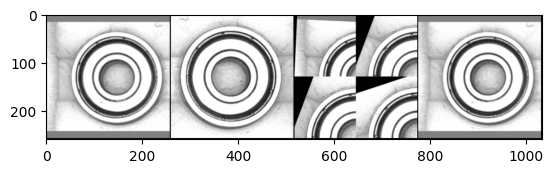

 13%|█▎        | 44/338 [00:01<00:07, 37.17it/s]

Epoch 62, step 21000: Generator loss: 1.4840278624296188, discriminator loss: 0.38404308608174353


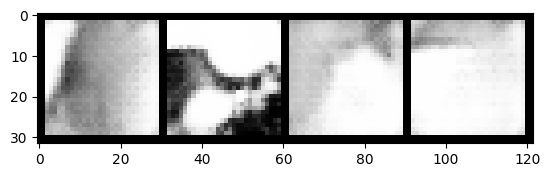

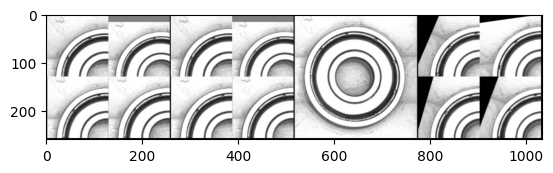

 61%|██████    | 205/338 [00:05<00:03, 35.90it/s]

Epoch 63, step 21500: Generator loss: 1.5149950451850893, discriminator loss: 0.37724703544378285


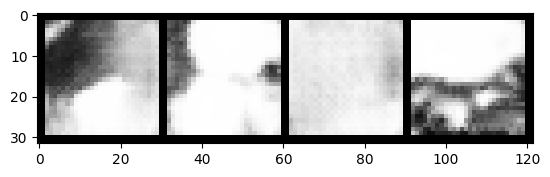

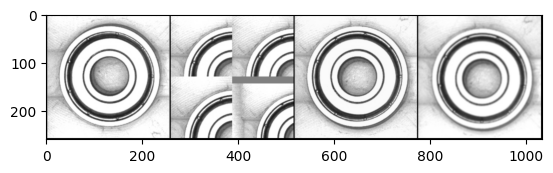

  8%|▊         | 28/338 [00:00<00:08, 35.91it/s]

Epoch 65, step 22000: Generator loss: 1.5351932326555262, discriminator loss: 0.3672299124896523


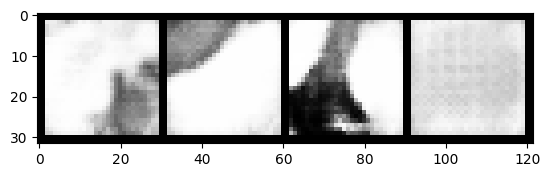

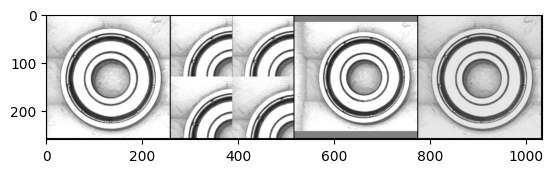

 57%|█████▋    | 192/338 [00:05<00:04, 33.64it/s]

Epoch 66, step 22500: Generator loss: 1.5333695905208595, discriminator loss: 0.3707732043564318


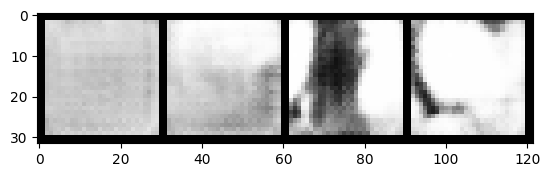

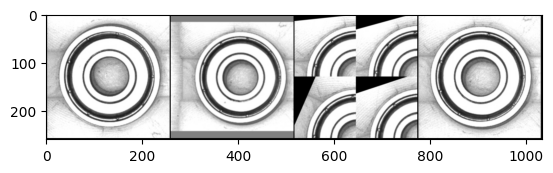

  5%|▍         | 16/338 [00:00<00:09, 35.34it/s]

Epoch 68, step 23000: Generator loss: 1.5349344538450238, discriminator loss: 0.3610833084881303


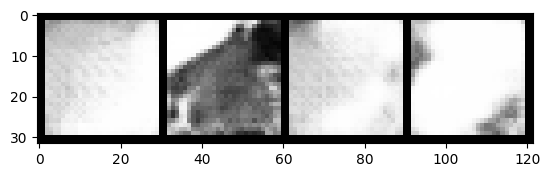

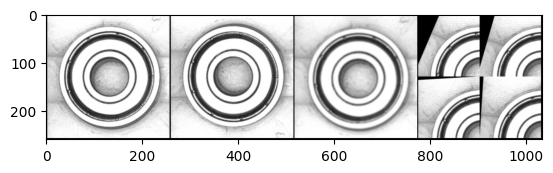

 52%|█████▏    | 177/338 [00:04<00:04, 36.34it/s]

Epoch 69, step 23500: Generator loss: 1.557555388808252, discriminator loss: 0.3589909503757953


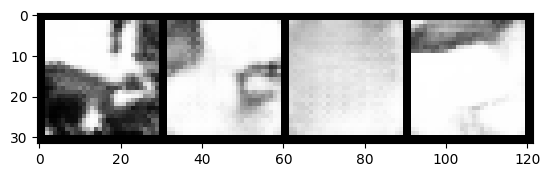

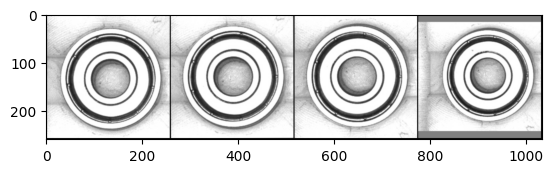

  0%|          | 0/338 [00:00<?, ?it/s]

Epoch 71, step 24000: Generator loss: 1.6072422341108317, discriminator loss: 0.36259364488720874


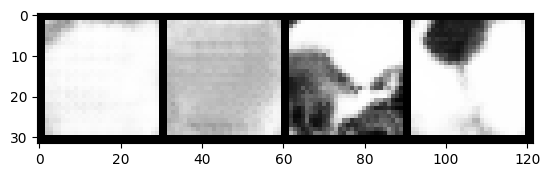

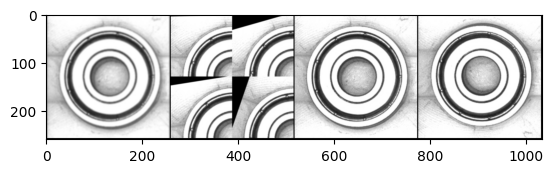

 49%|████▊     | 164/338 [00:04<00:04, 37.36it/s]

Epoch 72, step 24500: Generator loss: 1.5768594146966923, discriminator loss: 0.3610536123514173


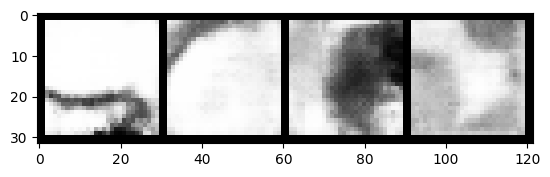

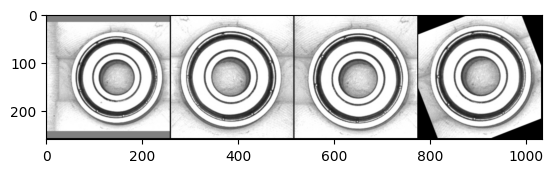

 96%|█████████▋| 326/338 [00:08<00:00, 37.03it/s]

Epoch 73, step 25000: Generator loss: 1.649475350379943, discriminator loss: 0.36061187401413886


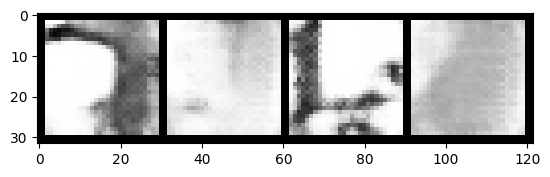

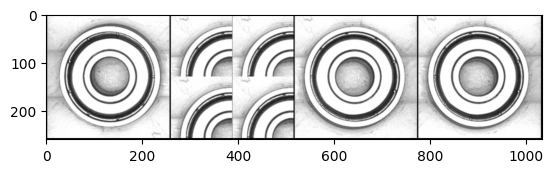

 44%|████▍     | 148/338 [00:04<00:05, 37.27it/s]

Epoch 75, step 25500: Generator loss: 1.6707205456495284, discriminator loss: 0.3533933598399162


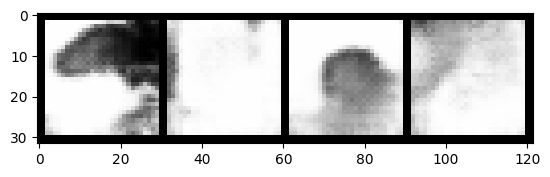

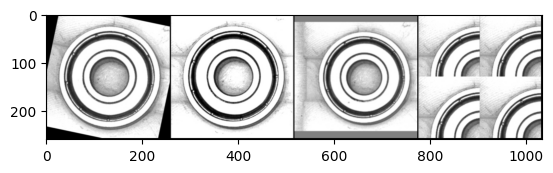

 92%|█████████▏| 312/338 [00:08<00:00, 36.94it/s]

Epoch 76, step 26000: Generator loss: 1.6803337894678103, discriminator loss: 0.3447471789419648


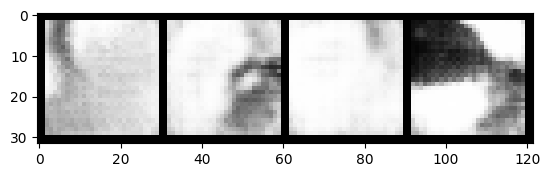

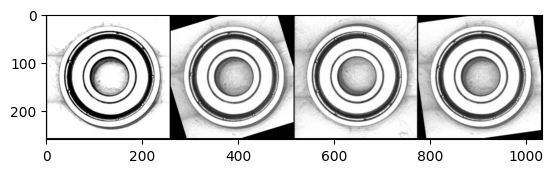

 40%|████      | 136/338 [00:03<00:05, 36.70it/s]

Epoch 78, step 26500: Generator loss: 1.6777680042982097, discriminator loss: 0.3554121313095092


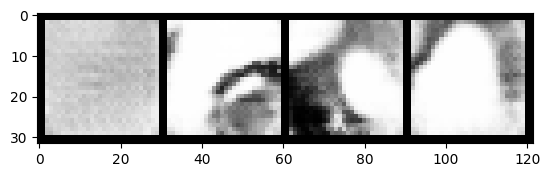

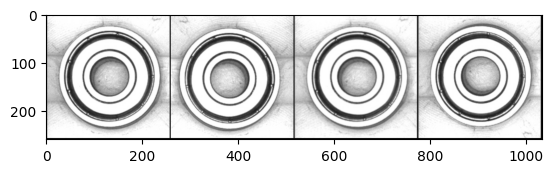

 88%|████████▊ | 296/338 [00:08<00:01, 37.25it/s]

Epoch 79, step 27000: Generator loss: 1.714443351387979, discriminator loss: 0.3451870032548905


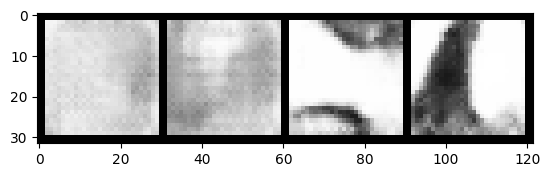

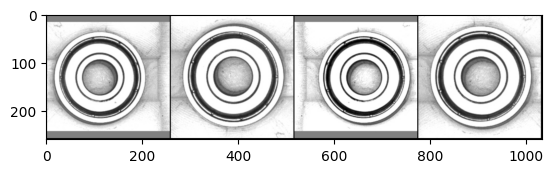

 36%|███▌      | 120/338 [00:03<00:06, 34.27it/s]

Epoch 81, step 27500: Generator loss: 1.7142716145515438, discriminator loss: 0.34579923895001385


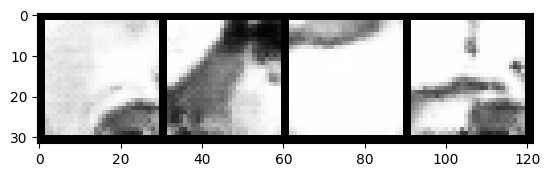

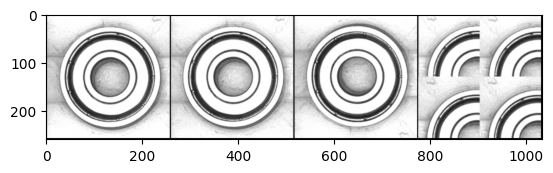

 84%|████████▍ | 284/338 [00:07<00:01, 36.43it/s]

Epoch 82, step 28000: Generator loss: 1.7088753850460057, discriminator loss: 0.33913055878877635


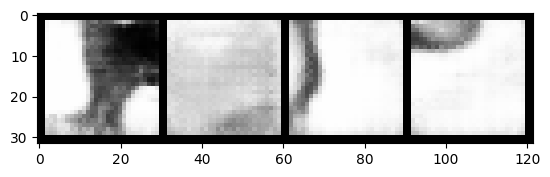

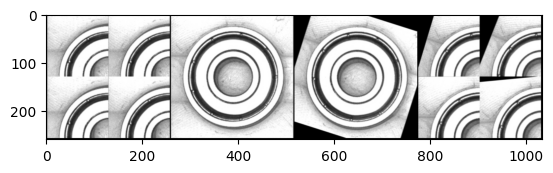

 32%|███▏      | 108/338 [00:02<00:06, 38.02it/s]

Epoch 84, step 28500: Generator loss: 1.74797005802393, discriminator loss: 0.33645513001084293


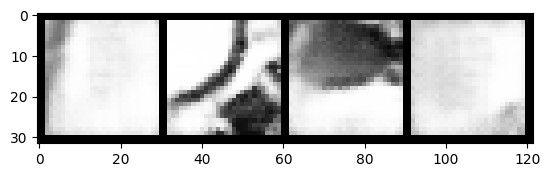

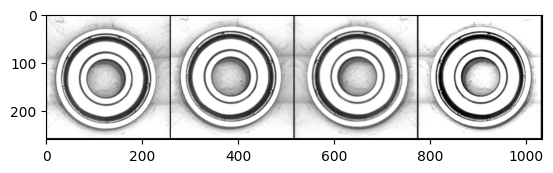

 80%|███████▉  | 269/338 [00:07<00:01, 36.33it/s]

Epoch 85, step 29000: Generator loss: 1.7666974471807493, discriminator loss: 0.3391038249135015


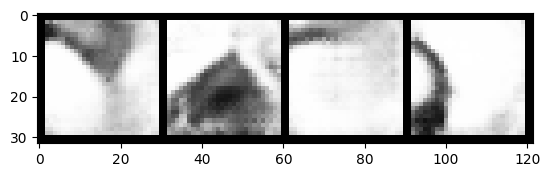

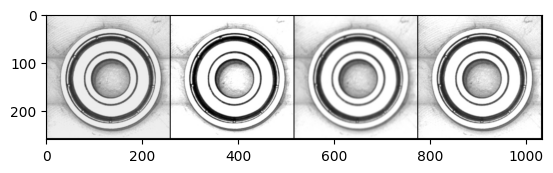

 28%|██▊       | 94/338 [00:02<00:06, 37.97it/s]

Epoch 87, step 29500: Generator loss: 1.8004084624052052, discriminator loss: 0.33700403398275397


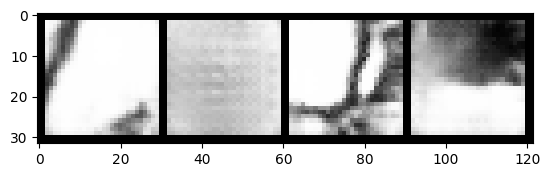

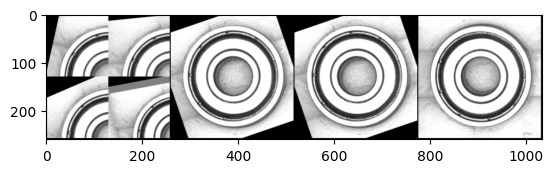

 75%|███████▌  | 254/338 [00:06<00:02, 37.64it/s]

Epoch 88, step 30000: Generator loss: 1.8118722186088543, discriminator loss: 0.3264873221814633


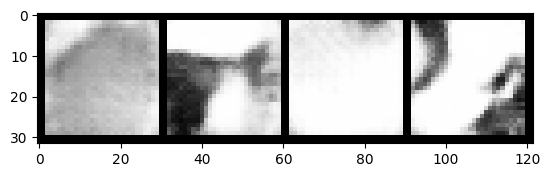

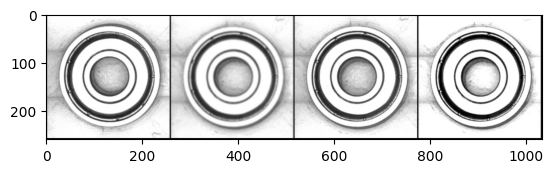

 24%|██▎       | 80/338 [00:02<00:07, 36.66it/s]

Epoch 90, step 30500: Generator loss: 1.8239379685521127, discriminator loss: 0.3270589263737202


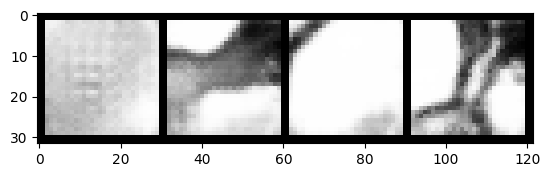

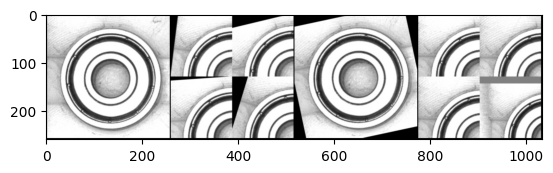

 71%|███████▏  | 241/338 [00:06<00:02, 36.35it/s]

Epoch 91, step 31000: Generator loss: 1.8337785632610306, discriminator loss: 0.32898030015826246


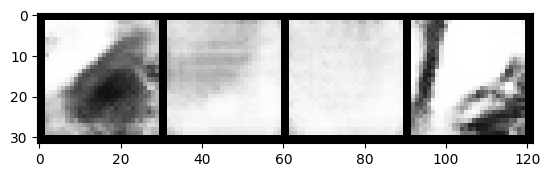

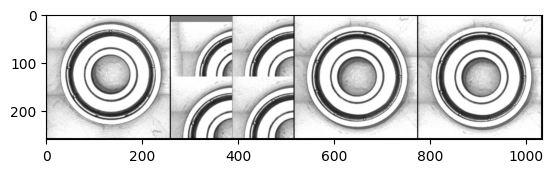

 19%|█▉        | 64/338 [00:01<00:07, 35.68it/s]

Epoch 93, step 31500: Generator loss: 1.8712204519510258, discriminator loss: 0.3225559446513651


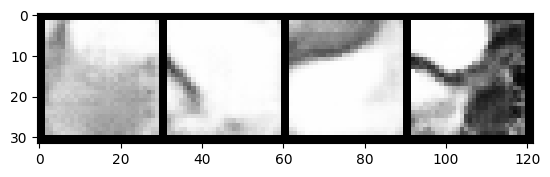

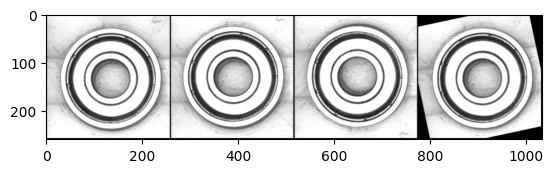

 67%|██████▋   | 228/338 [00:06<00:03, 36.15it/s]

Epoch 94, step 32000: Generator loss: 1.8711529014110584, discriminator loss: 0.32051783725619315


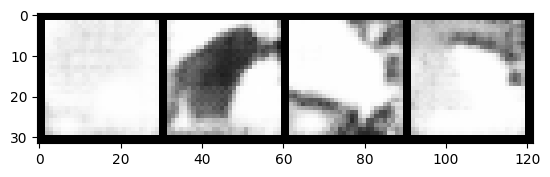

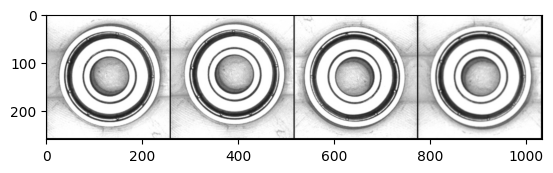

 15%|█▌        | 52/338 [00:01<00:07, 35.91it/s]

Epoch 96, step 32500: Generator loss: 1.9194223052263266, discriminator loss: 0.3160782201290134


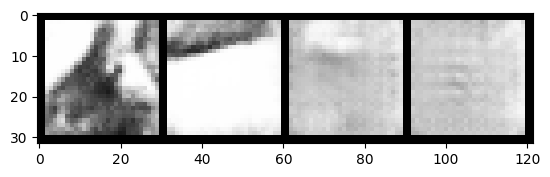

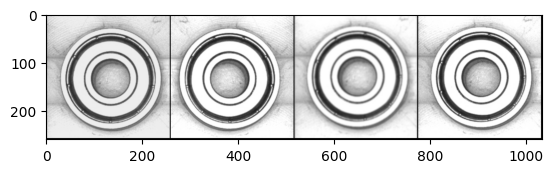

 63%|██████▎   | 212/338 [00:05<00:03, 36.23it/s]

Epoch 97, step 33000: Generator loss: 1.9648255522251121, discriminator loss: 0.31017635342478744


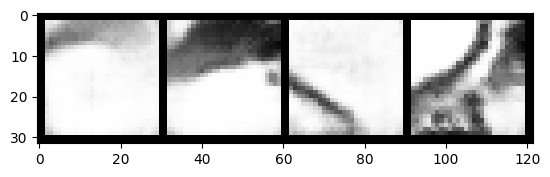

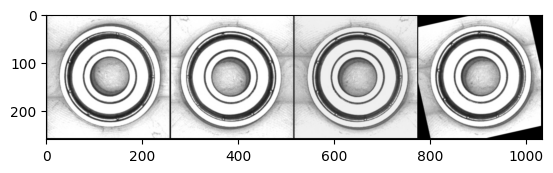

 11%|█         | 36/338 [00:01<00:08, 35.38it/s]

Epoch 99, step 33500: Generator loss: 1.9016319321393944, discriminator loss: 0.311025685340166


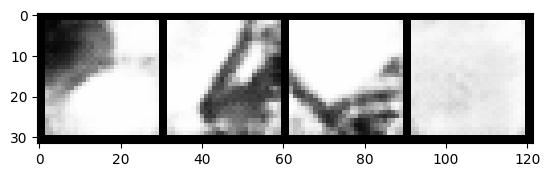

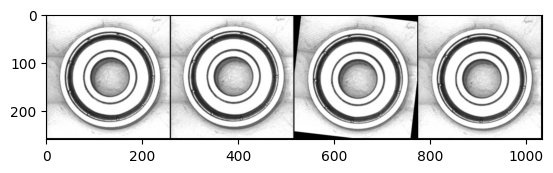

 59%|█████▉    | 200/338 [00:05<00:03, 36.64it/s]

Epoch 100, step 34000: Generator loss: 1.9825093793869033, discriminator loss: 0.30259833227097976


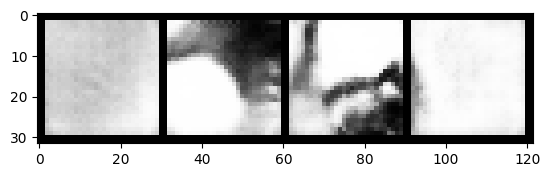

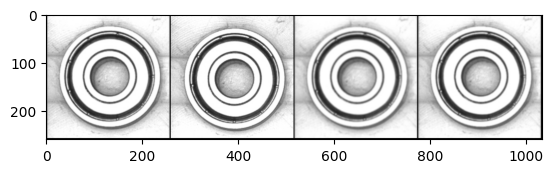

  7%|▋         | 24/338 [00:00<00:08, 36.55it/s]

Epoch 102, step 34500: Generator loss: 2.000068197011947, discriminator loss: 0.3043847803771499


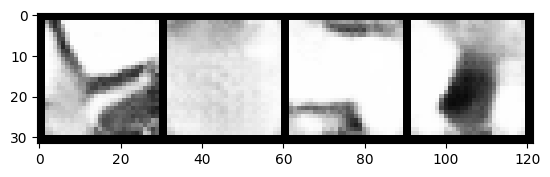

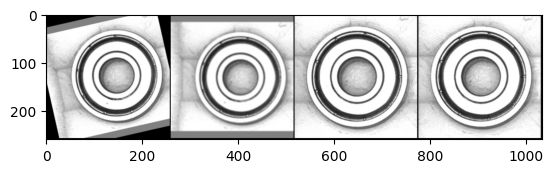

 54%|█████▍    | 184/338 [00:05<00:04, 36.17it/s]

Epoch 103, step 35000: Generator loss: 2.0081850942373256, discriminator loss: 0.2880072195082904


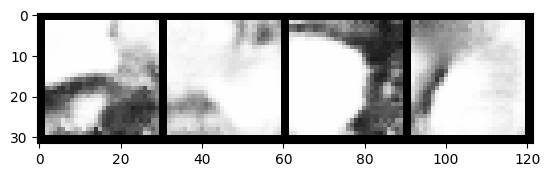

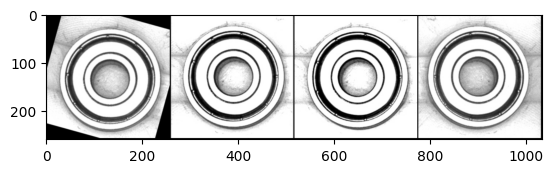

  2%|▏         | 8/338 [00:00<00:09, 35.73it/s]

Epoch 105, step 35500: Generator loss: 1.9876230155229584, discriminator loss: 0.2991943592876195


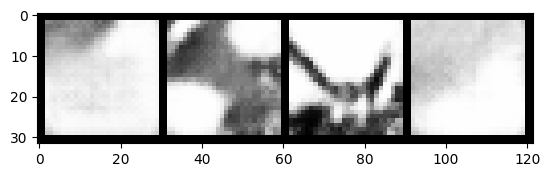

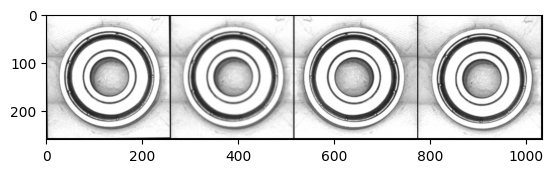

 51%|█████     | 172/338 [00:04<00:04, 36.65it/s]

Epoch 106, step 36000: Generator loss: 2.0397713571786893, discriminator loss: 0.2999682289958003


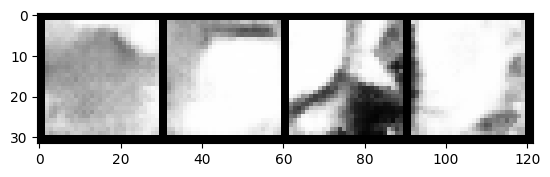

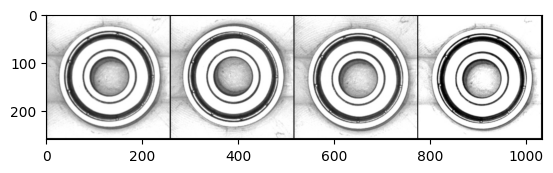

 98%|█████████▊| 332/338 [00:09<00:00, 35.78it/s]

Epoch 107, step 36500: Generator loss: 2.060184220910074, discriminator loss: 0.2979723176956177


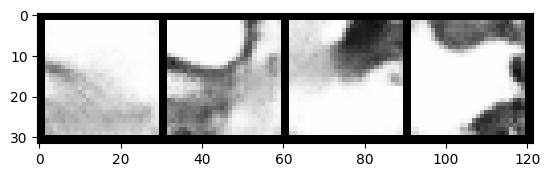

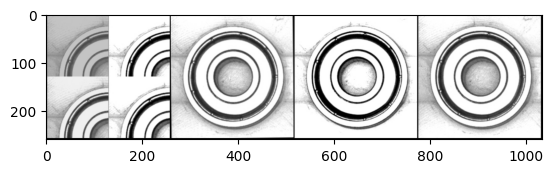

 46%|████▌     | 156/338 [00:04<00:05, 36.03it/s]

Epoch 109, step 37000: Generator loss: 2.020131180644035, discriminator loss: 0.28797995677590355


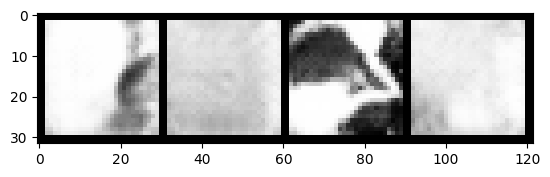

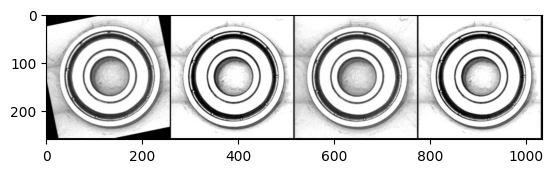

 95%|█████████▍| 320/338 [00:08<00:00, 35.63it/s]

Epoch 110, step 37500: Generator loss: 2.0537426418066023, discriminator loss: 0.2931042992621659


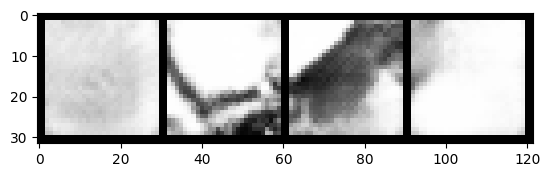

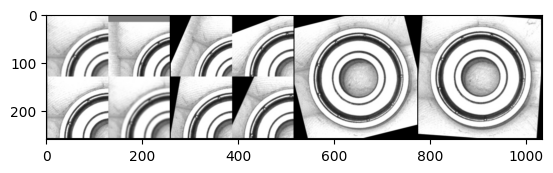

 43%|████▎     | 144/338 [00:04<00:05, 34.91it/s]

Epoch 112, step 38000: Generator loss: 2.0717806663513194, discriminator loss: 0.2806590720117093


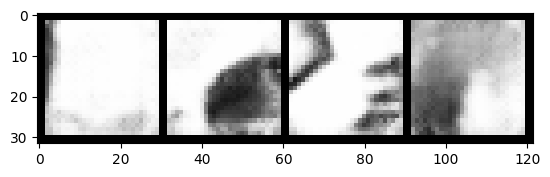

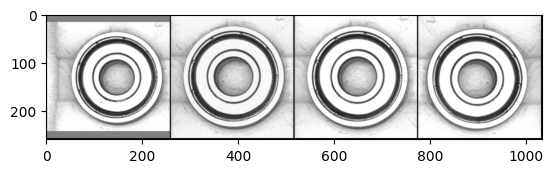

 90%|████████▉ | 304/338 [00:08<00:00, 36.76it/s]

Epoch 113, step 38500: Generator loss: 2.126927222013473, discriminator loss: 0.2886226317286489


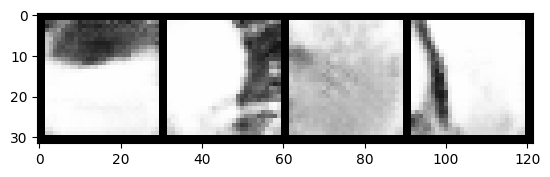

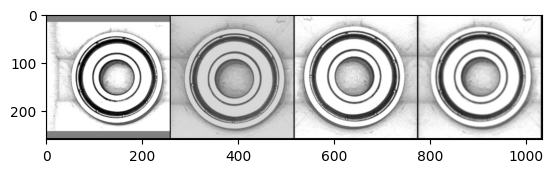

 38%|███▊      | 128/338 [00:03<00:05, 36.56it/s]

Epoch 115, step 39000: Generator loss: 2.152094566464426, discriminator loss: 0.28238582420349095


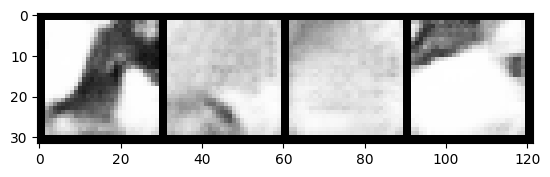

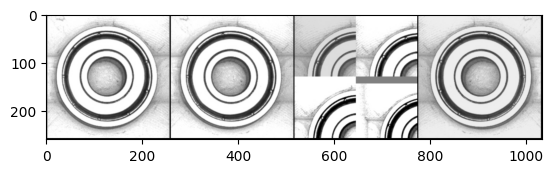

 86%|████████▋ | 292/338 [00:08<00:01, 36.66it/s]

Epoch 116, step 39500: Generator loss: 2.116571320891381, discriminator loss: 0.2821817519962787


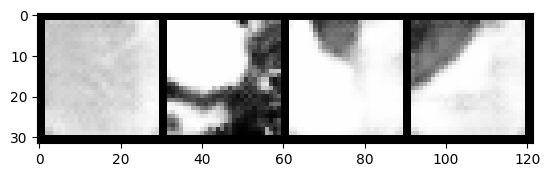

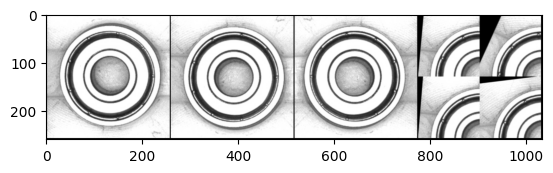

 34%|███▍      | 116/338 [00:03<00:06, 36.11it/s]

Epoch 118, step 40000: Generator loss: 2.112747878432274, discriminator loss: 0.26839614386856536


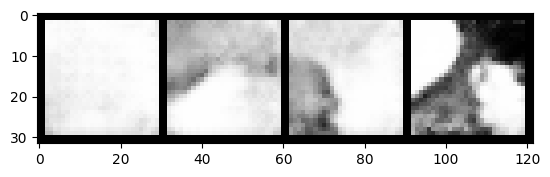

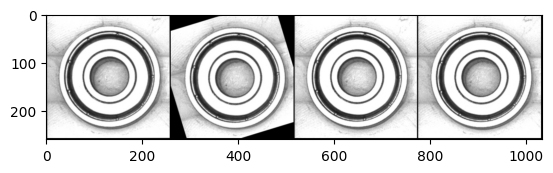

 82%|████████▏ | 276/338 [00:07<00:01, 36.12it/s]

Epoch 119, step 40500: Generator loss: 2.17340916097164, discriminator loss: 0.27652197590470307


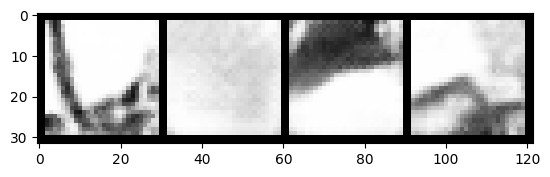

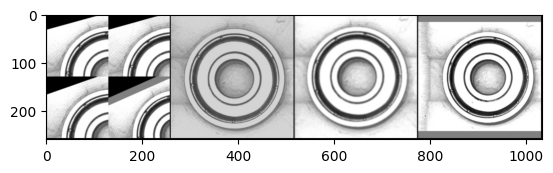

 30%|██▉       | 100/338 [00:02<00:06, 36.00it/s]

Epoch 121, step 41000: Generator loss: 2.222014268159867, discriminator loss: 0.27850969220697874


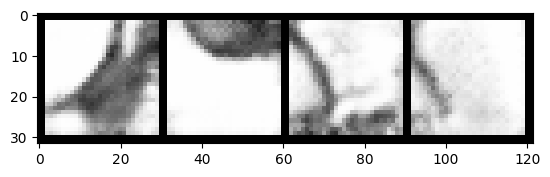

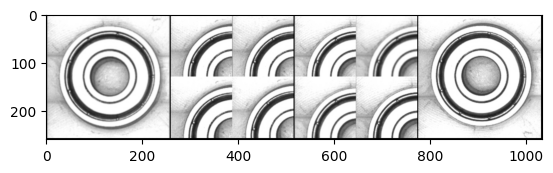

 78%|███████▊  | 264/338 [00:07<00:02, 36.71it/s]

Epoch 122, step 41500: Generator loss: 2.217742758095267, discriminator loss: 0.26865153177082524


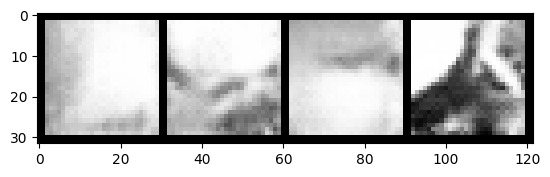

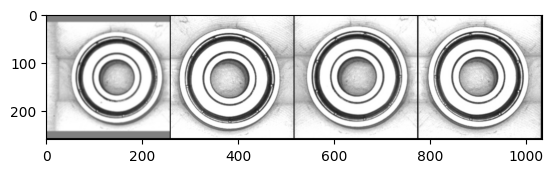

 26%|██▌       | 88/338 [00:02<00:07, 35.38it/s]

Epoch 124, step 42000: Generator loss: 2.204842458963392, discriminator loss: 0.28162521255016304


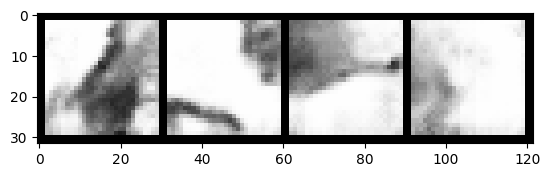

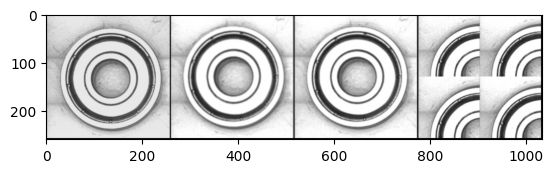

 73%|███████▎  | 248/338 [00:06<00:02, 34.76it/s]

Epoch 125, step 42500: Generator loss: 2.2061136656999576, discriminator loss: 0.273337891846895


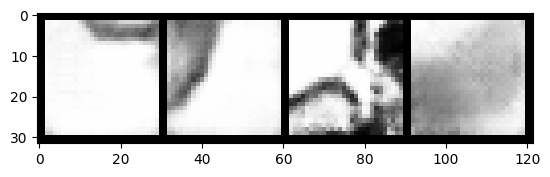

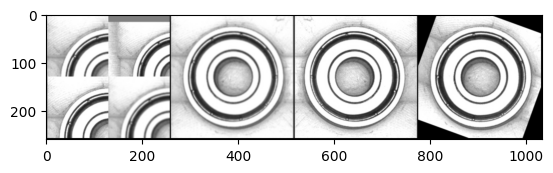

 21%|██▏       | 72/338 [00:01<00:07, 36.11it/s]

Epoch 127, step 43000: Generator loss: 2.2082511121034636, discriminator loss: 0.27316078959405427


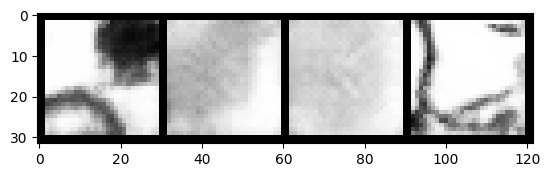

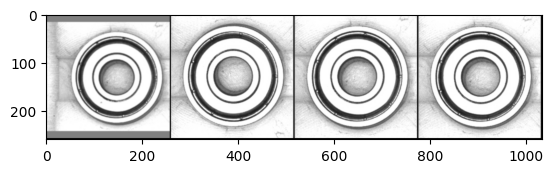

 69%|██████▉   | 233/338 [00:06<00:02, 37.79it/s]

Epoch 128, step 43500: Generator loss: 2.2587360093593594, discriminator loss: 0.28154733870923543


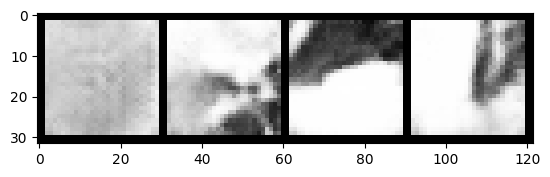

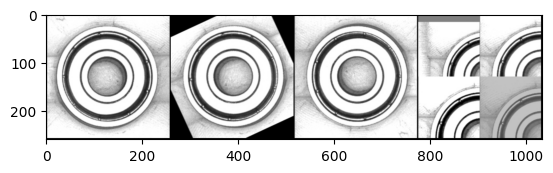

 18%|█▊        | 60/338 [00:01<00:07, 36.22it/s]

Epoch 130, step 44000: Generator loss: 2.2104946320056906, discriminator loss: 0.2573572771549228


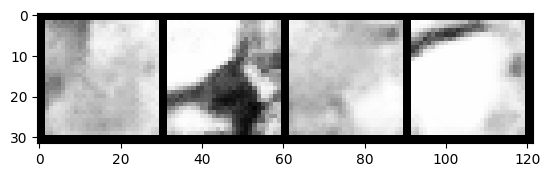

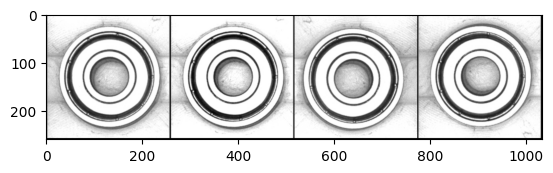

 65%|██████▌   | 220/338 [00:05<00:03, 36.63it/s]

Epoch 131, step 44500: Generator loss: 2.226689024090768, discriminator loss: 0.2623460827171802


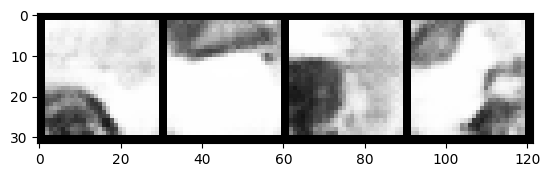

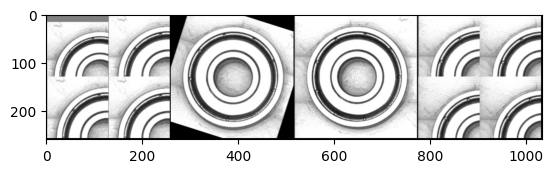

 13%|█▎        | 44/338 [00:01<00:07, 36.79it/s]

Epoch 133, step 45000: Generator loss: 2.273931733727454, discriminator loss: 0.2643824540376665


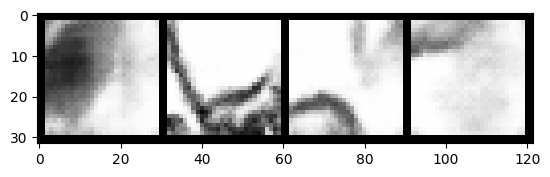

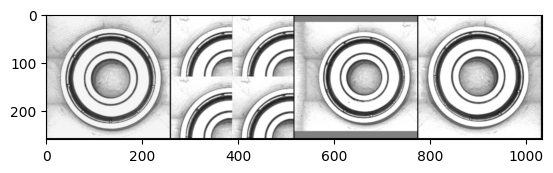

 61%|██████    | 205/338 [00:05<00:03, 36.59it/s]

Epoch 134, step 45500: Generator loss: 2.282616280436514, discriminator loss: 0.2713667320758103


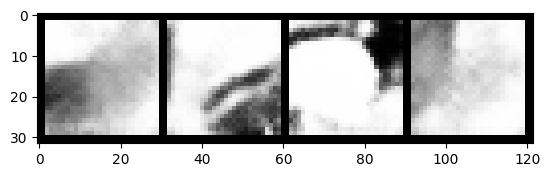

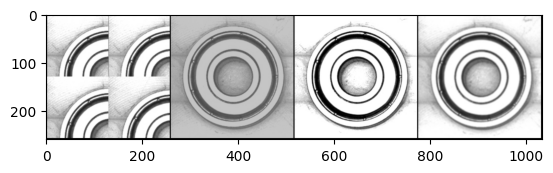

  9%|▉         | 32/338 [00:00<00:08, 37.12it/s]

Epoch 136, step 46000: Generator loss: 2.2164241348505036, discriminator loss: 0.26680372910201566


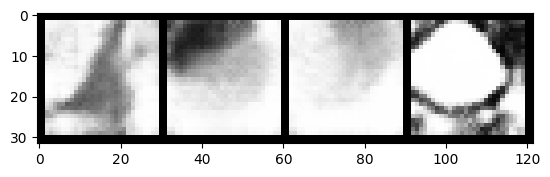

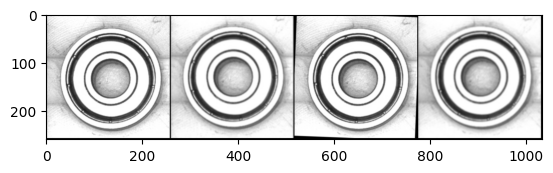

 57%|█████▋    | 192/338 [00:05<00:04, 36.29it/s]

Epoch 137, step 46500: Generator loss: 2.3622223310470565, discriminator loss: 0.26787433218955975


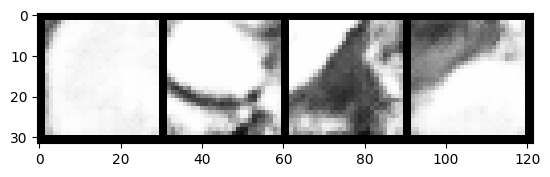

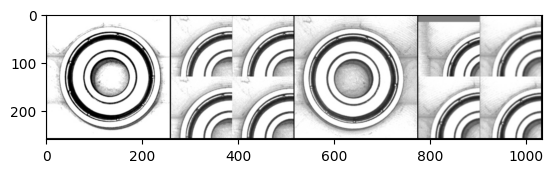

  5%|▍         | 16/338 [00:00<00:08, 36.56it/s]

Epoch 139, step 47000: Generator loss: 2.263625853657723, discriminator loss: 0.2611131689697505


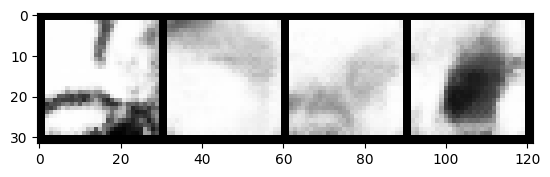

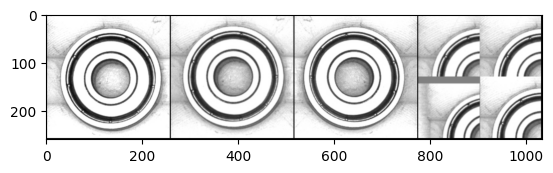

 52%|█████▏    | 177/338 [00:05<00:04, 35.83it/s]

Epoch 140, step 47500: Generator loss: 2.3471154426336303, discriminator loss: 0.2675216605216264


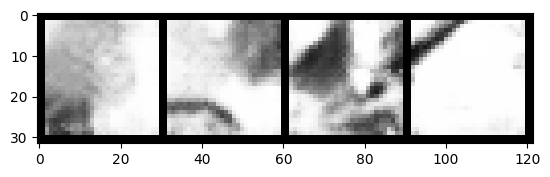

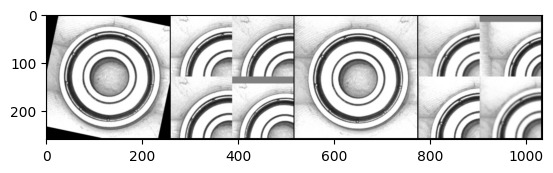

  1%|          | 4/338 [00:00<00:08, 38.20it/s]

Epoch 142, step 48000: Generator loss: 2.393501409769059, discriminator loss: 0.2704971307516096


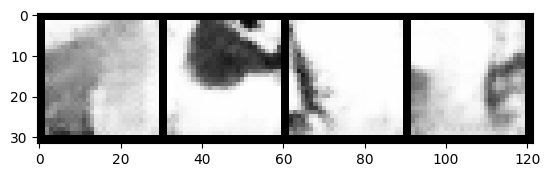

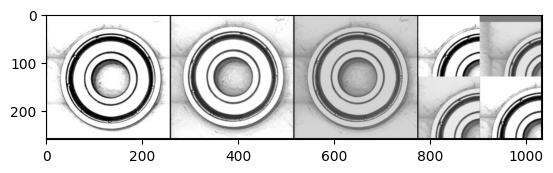

 49%|████▊     | 164/338 [00:04<00:04, 36.29it/s]

Epoch 143, step 48500: Generator loss: 2.363963025331496, discriminator loss: 0.26315315331518685


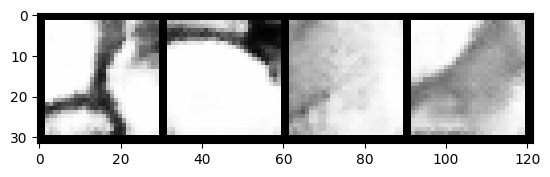

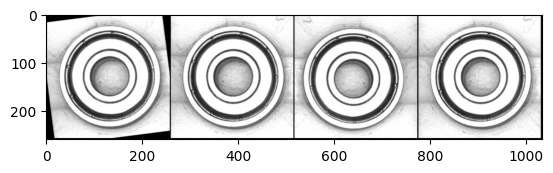

 97%|█████████▋| 328/338 [00:08<00:00, 36.94it/s]

Epoch 144, step 49000: Generator loss: 2.322498411417009, discriminator loss: 0.2697476720809936


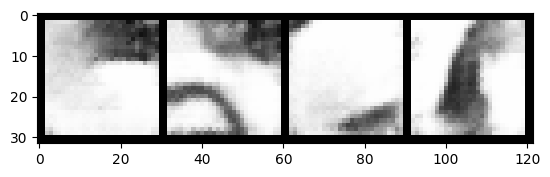

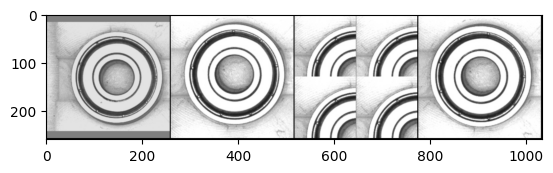

 44%|████▍     | 150/338 [00:04<00:05, 36.09it/s]

Epoch 146, step 49500: Generator loss: 2.387066039204596, discriminator loss: 0.2658695807456971


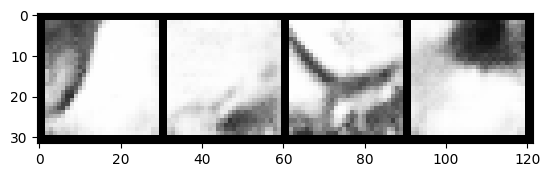

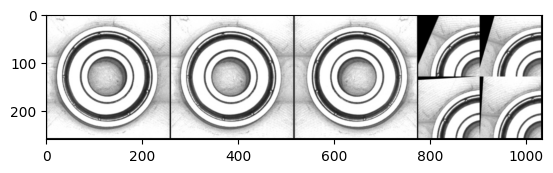

 92%|█████████▏| 312/338 [00:08<00:00, 37.29it/s]

Epoch 147, step 50000: Generator loss: 2.368774939417841, discriminator loss: 0.25282621198892585


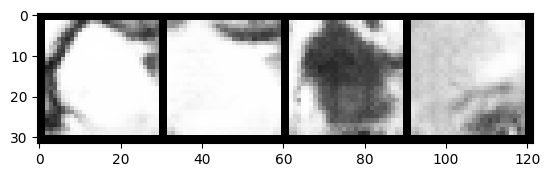

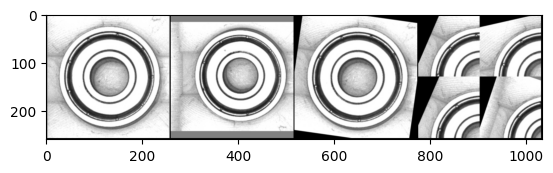

 40%|████      | 136/338 [00:04<00:06, 33.38it/s]

Epoch 149, step 50500: Generator loss: 2.3924543211460083, discriminator loss: 0.2563518943488597


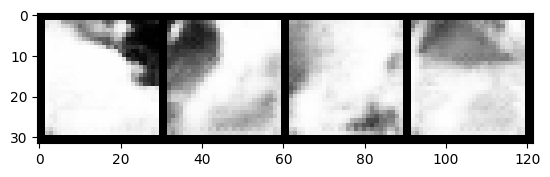

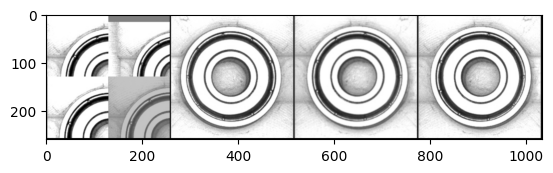

 89%|████████▉ | 300/338 [00:08<00:01, 36.20it/s]

Epoch 150, step 51000: Generator loss: 2.4330642825365074, discriminator loss: 0.25816844002902517


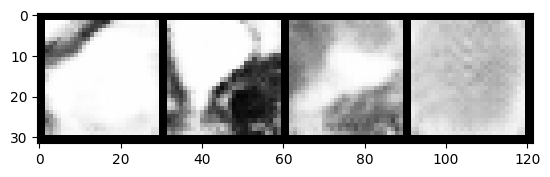

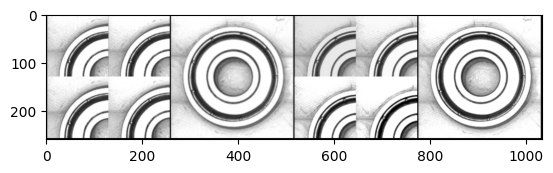

 36%|███▌      | 122/338 [00:03<00:05, 36.94it/s]

Epoch 152, step 51500: Generator loss: 2.4003908301591883, discriminator loss: 0.2509563864171506


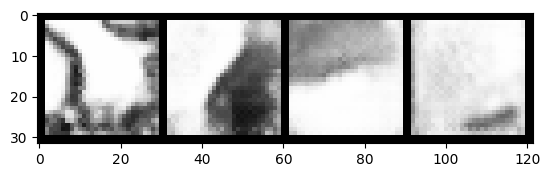

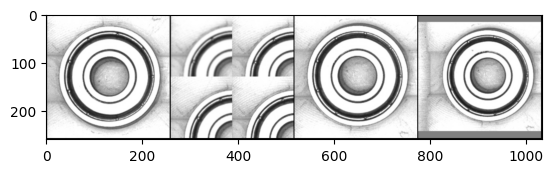

 85%|████████▍ | 286/338 [00:07<00:01, 37.20it/s]

Epoch 153, step 52000: Generator loss: 2.3813306288719183, discriminator loss: 0.25563375979661934


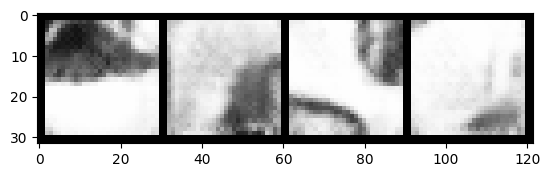

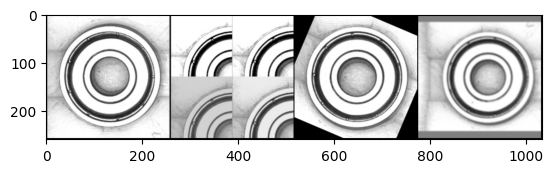

 32%|███▏      | 109/338 [00:02<00:05, 38.29it/s]

Epoch 155, step 52500: Generator loss: 2.4895336329936986, discriminator loss: 0.2522186820060014


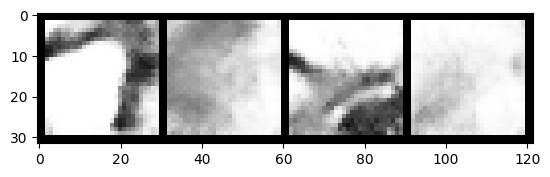

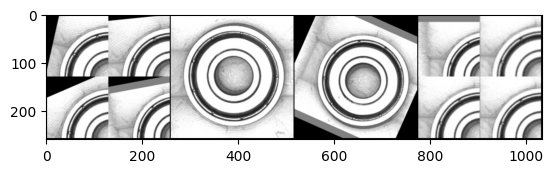

 80%|████████  | 272/338 [00:07<00:01, 35.62it/s]

Epoch 156, step 53000: Generator loss: 2.4279531519412982, discriminator loss: 0.24683932493627067


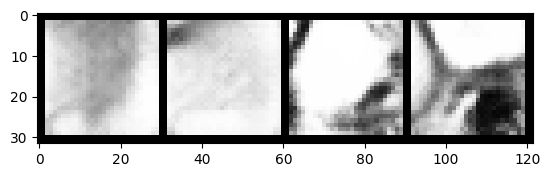

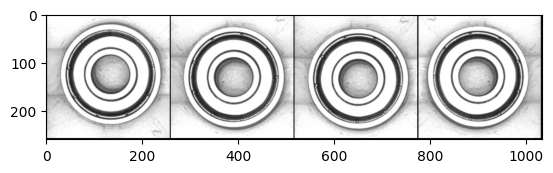

 28%|██▊       | 96/338 [00:02<00:07, 32.16it/s]

Epoch 158, step 53500: Generator loss: 2.444144557595251, discriminator loss: 0.2630674529969692


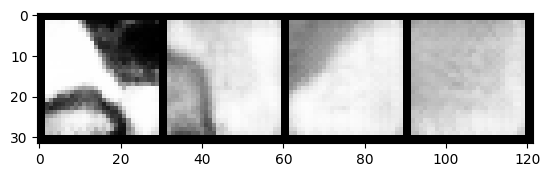

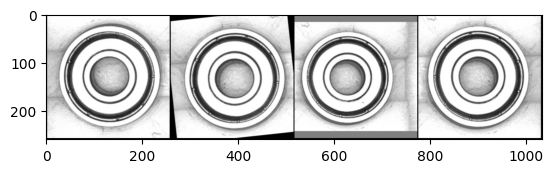

 76%|███████▌  | 257/338 [00:06<00:02, 36.82it/s]

Epoch 159, step 54000: Generator loss: 2.4213606926202793, discriminator loss: 0.2428740564286708


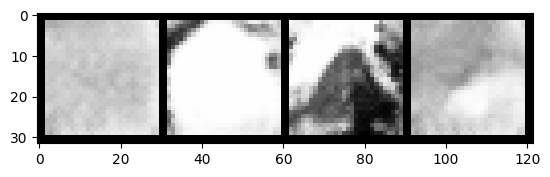

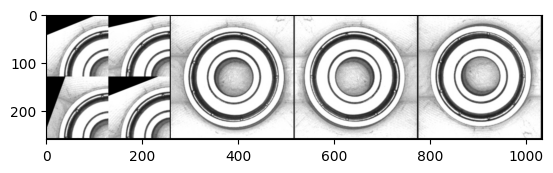

 24%|██▍       | 81/338 [00:02<00:06, 38.26it/s]

Epoch 161, step 54500: Generator loss: 2.592905476450921, discriminator loss: 0.2567586369216442


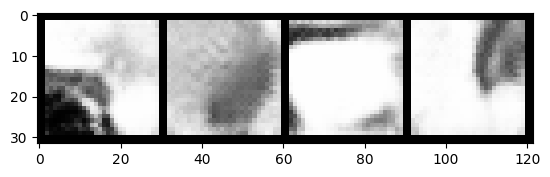

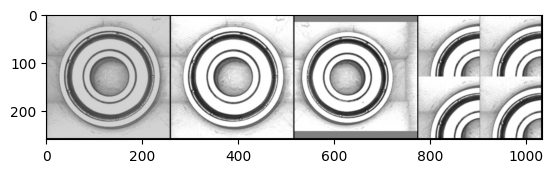

 72%|███████▏  | 244/338 [00:06<00:02, 36.89it/s]

Epoch 162, step 55000: Generator loss: 2.5289694800376887, discriminator loss: 0.24953874801099302


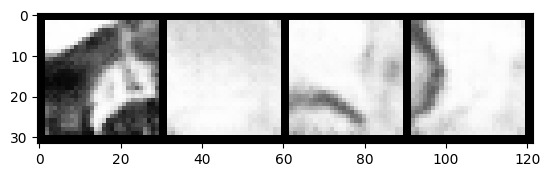

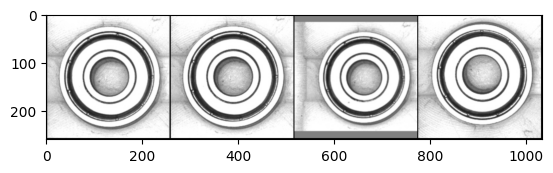

 20%|██        | 68/338 [00:01<00:07, 37.74it/s]

Epoch 164, step 55500: Generator loss: 2.53405553770065, discriminator loss: 0.24941155368089674


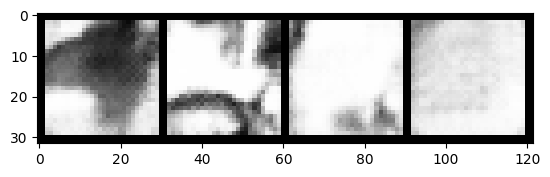

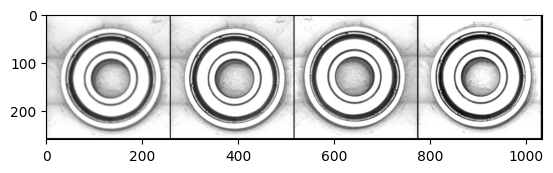

 68%|██████▊   | 229/338 [00:05<00:02, 38.36it/s]

Epoch 165, step 56000: Generator loss: 2.4776937621831903, discriminator loss: 0.24664166361093504


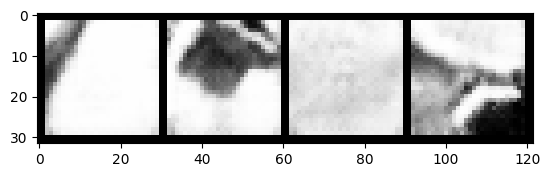

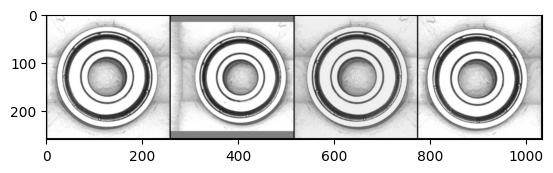

 15%|█▌        | 52/338 [00:01<00:07, 38.58it/s]

Epoch 167, step 56500: Generator loss: 2.554103339076044, discriminator loss: 0.2449673325717447


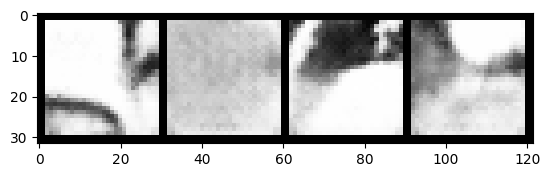

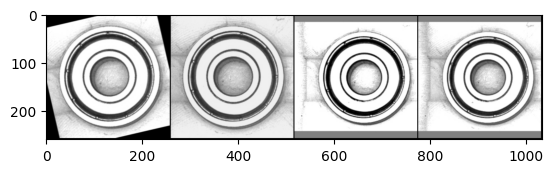

 63%|██████▎   | 214/338 [00:05<00:03, 36.40it/s]

Epoch 168, step 57000: Generator loss: 2.5417653236389177, discriminator loss: 0.2516955701559784


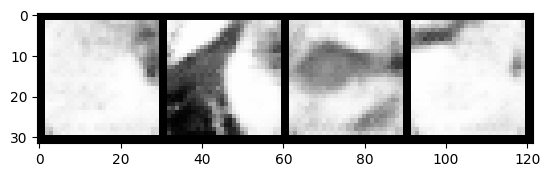

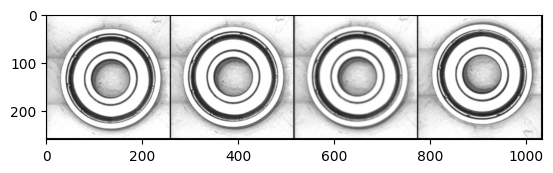

 11%|█         | 37/338 [00:00<00:08, 37.05it/s]

Epoch 170, step 57500: Generator loss: 2.5410747994184515, discriminator loss: 0.2514044065326453


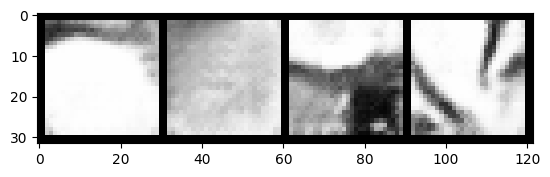

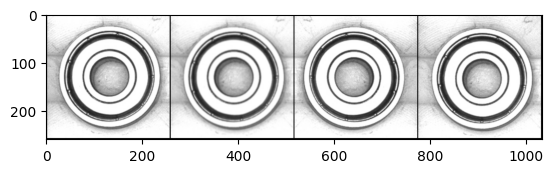

 60%|█████▉    | 202/338 [00:05<00:03, 38.15it/s]

Epoch 171, step 58000: Generator loss: 2.5054501005411147, discriminator loss: 0.24937998577952383


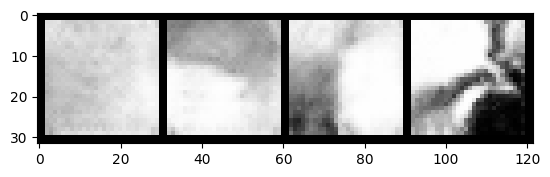

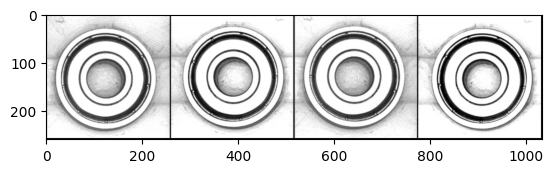

  7%|▋         | 24/338 [00:00<00:08, 35.82it/s]

Epoch 173, step 58500: Generator loss: 2.6383060739040367, discriminator loss: 0.2452438638955355


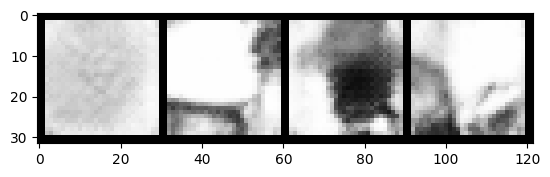

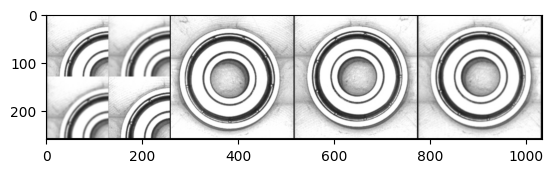

 55%|█████▍    | 185/338 [00:04<00:04, 38.05it/s]

Epoch 174, step 59000: Generator loss: 2.642225718379018, discriminator loss: 0.24352118287980545


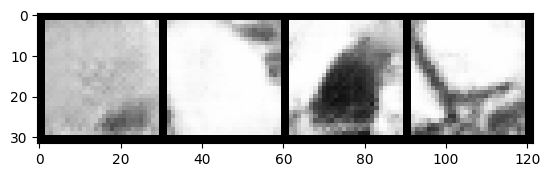

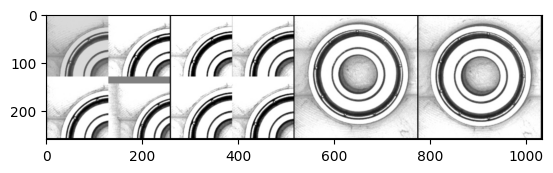

  4%|▎         | 12/338 [00:00<00:08, 37.80it/s]

Epoch 176, step 59500: Generator loss: 2.596172854542732, discriminator loss: 0.23973678766191


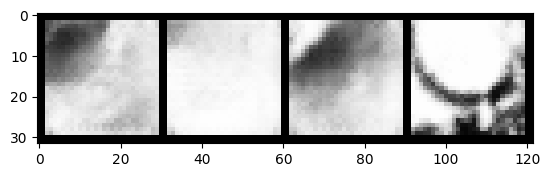

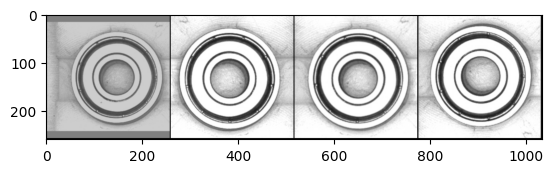

 51%|█████     | 171/338 [00:05<00:04, 33.46it/s]

Epoch 177, step 60000: Generator loss: 2.5964914394617082, discriminator loss: 0.23551053343713277


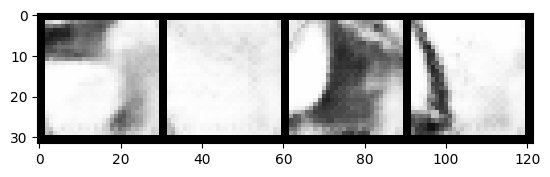

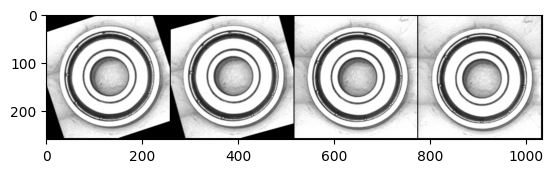

 99%|█████████▉| 336/338 [00:09<00:00, 34.24it/s]

Epoch 178, step 60500: Generator loss: 2.6166558024883275, discriminator loss: 0.2301459160298109


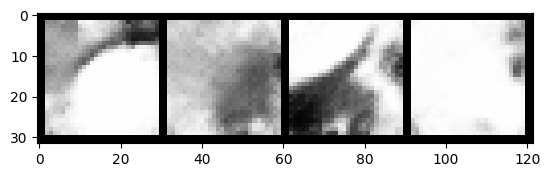

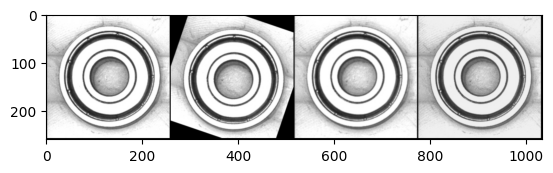

 47%|████▋     | 160/338 [16:11:08<01:57,  1.51it/s]      

Epoch 180, step 61000: Generator loss: 2.653180676221849, discriminator loss: 0.23668580368161185


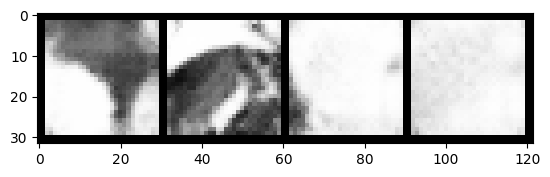

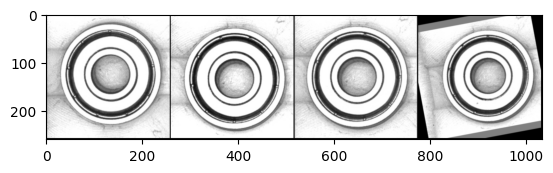

 95%|█████████▍| 321/338 [00:11<00:00, 32.29it/s]

Epoch 181, step 61500: Generator loss: 2.704780243635178, discriminator loss: 0.22975397057831293


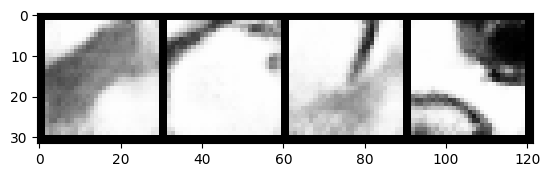

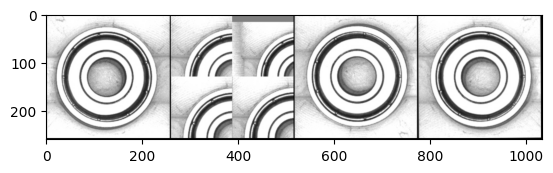

 43%|████▎     | 144/338 [00:04<00:05, 33.31it/s]

Epoch 183, step 62000: Generator loss: 2.6655150573253685, discriminator loss: 0.23228238461911663


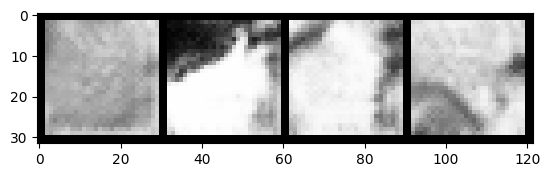

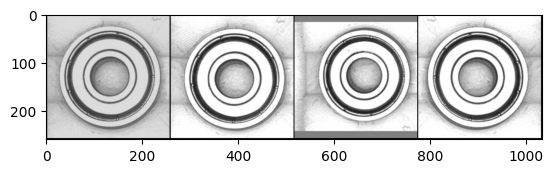

 91%|█████████ | 308/338 [00:08<00:00, 35.17it/s]

Epoch 184, step 62500: Generator loss: 2.6546397228240948, discriminator loss: 0.23276502306759364


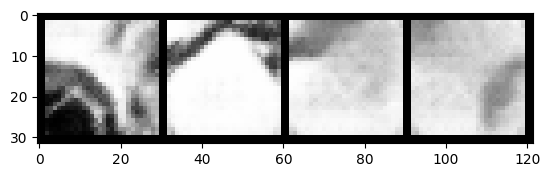

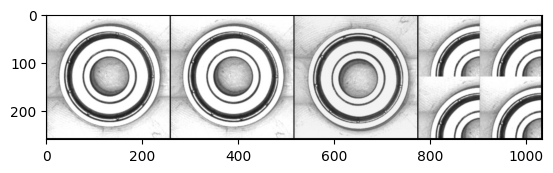

 39%|███▉      | 132/338 [00:03<00:06, 31.61it/s]

Epoch 186, step 63000: Generator loss: 2.6254462393522253, discriminator loss: 0.2297506699711086


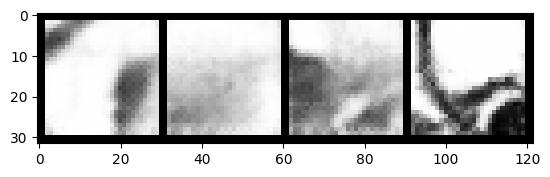

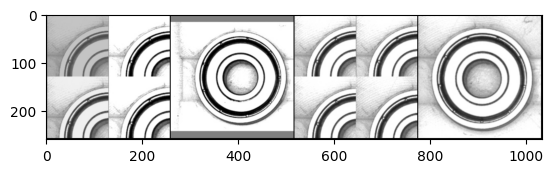

 86%|████████▋ | 292/338 [00:08<00:01, 34.96it/s]

Epoch 187, step 63500: Generator loss: 2.806092893600462, discriminator loss: 0.23895265088975448


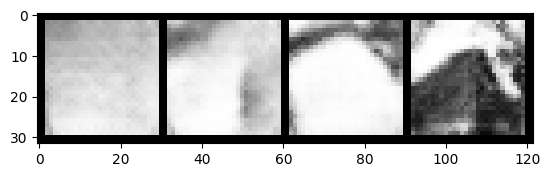

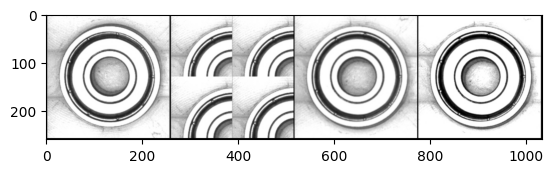

 34%|███▍      | 116/338 [00:03<00:06, 33.26it/s]

Epoch 189, step 64000: Generator loss: 2.7349623838663133, discriminator loss: 0.2391995184719561


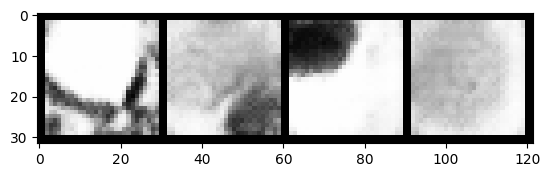

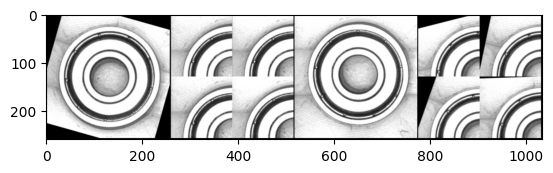

 83%|████████▎ | 280/338 [00:08<00:01, 33.41it/s]

Epoch 190, step 64500: Generator loss: 2.69839868140221, discriminator loss: 0.23030259959399696


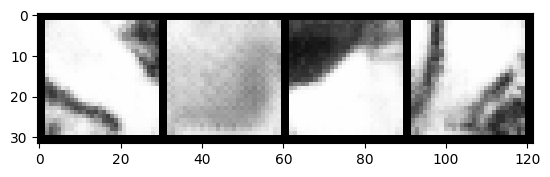

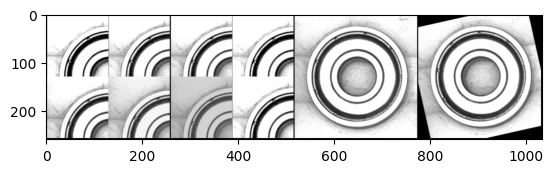

 31%|███       | 104/338 [00:03<00:06, 33.57it/s]

Epoch 192, step 65000: Generator loss: 2.6064475058317167, discriminator loss: 0.22721850147843353


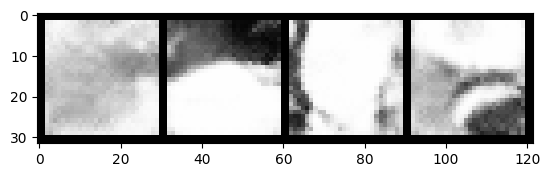

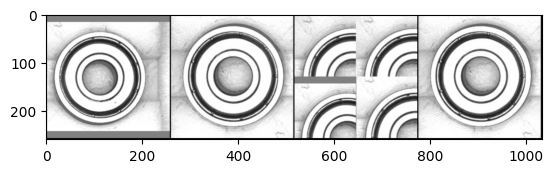

 78%|███████▊  | 264/338 [00:07<00:02, 33.45it/s]

Epoch 193, step 65500: Generator loss: 2.7255815148353557, discriminator loss: 0.22796206800639657


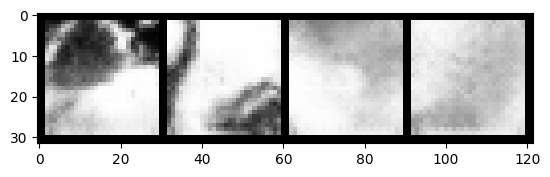

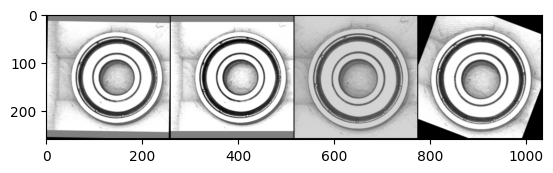

 26%|██▌       | 87/338 [00:02<00:07, 33.69it/s]

Epoch 195, step 66000: Generator loss: 2.805156883001326, discriminator loss: 0.22857505130767822


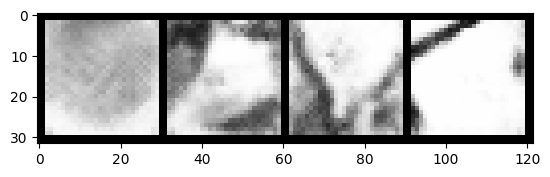

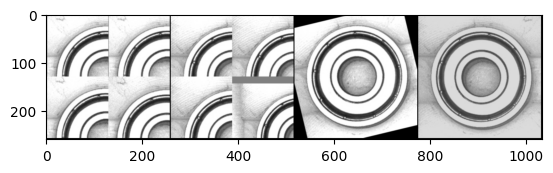

 75%|███████▍  | 252/338 [00:07<00:02, 33.99it/s]

Epoch 196, step 66500: Generator loss: 2.7720625971555672, discriminator loss: 0.22849996425211427


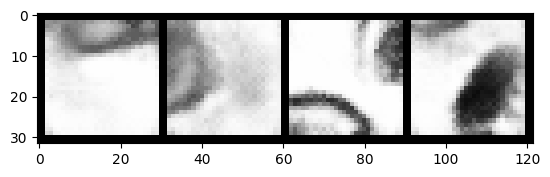

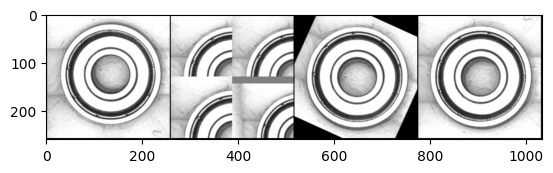

 22%|██▏       | 76/338 [00:02<00:07, 34.33it/s]

Epoch 198, step 67000: Generator loss: 2.774202248215675, discriminator loss: 0.22893554766476157


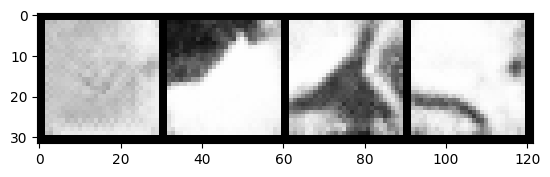

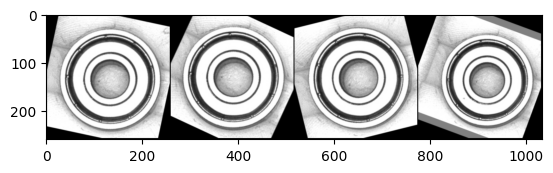

 70%|██████▉   | 236/338 [00:06<00:02, 34.49it/s]

Epoch 199, step 67500: Generator loss: 2.7830567477941512, discriminator loss: 0.22542260858416552


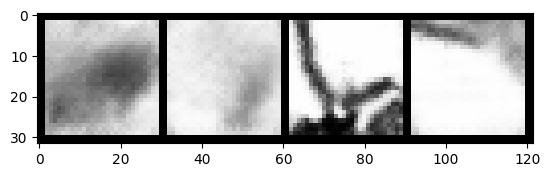

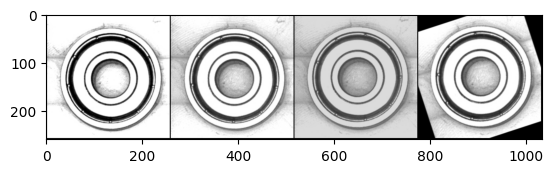

 18%|█▊        | 60/338 [00:01<00:08, 33.21it/s]

Epoch 201, step 68000: Generator loss: 2.766056888341904, discriminator loss: 0.21937210072577015


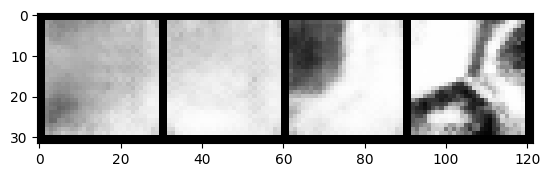

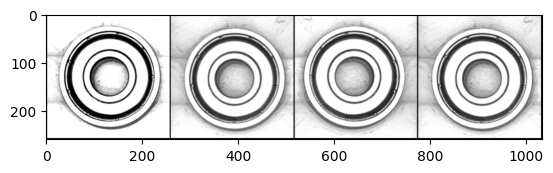

 66%|██████▋   | 224/338 [00:06<00:03, 31.46it/s]

Epoch 202, step 68500: Generator loss: 2.789000927448271, discriminator loss: 0.21414547573029985


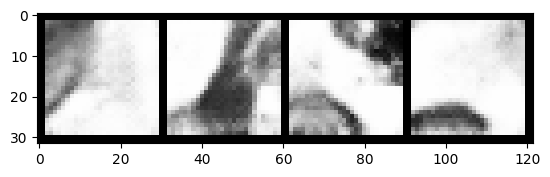

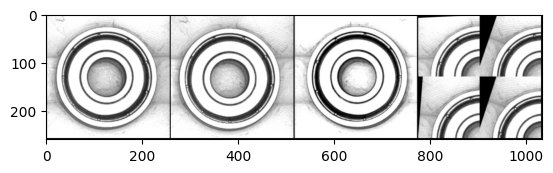

 14%|█▍        | 48/338 [00:01<00:08, 35.24it/s]

Epoch 204, step 69000: Generator loss: 2.720441554665567, discriminator loss: 0.2266529804319143


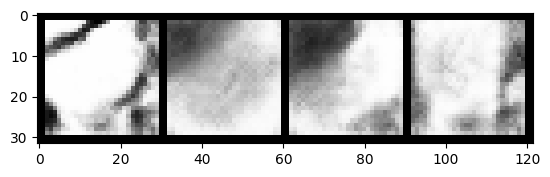

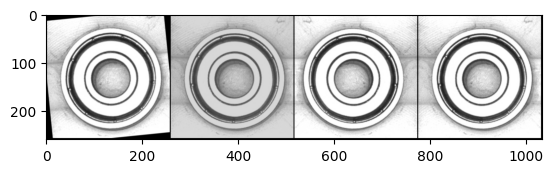

 62%|██████▏   | 208/338 [00:06<00:03, 32.55it/s]

Epoch 205, step 69500: Generator loss: 2.8490161516666417, discriminator loss: 0.22677300026267783


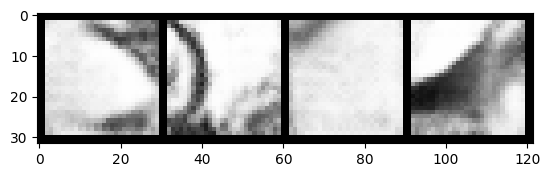

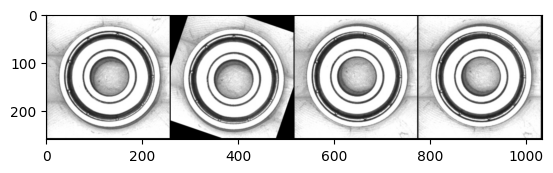

  9%|▉         | 32/338 [00:00<00:09, 32.61it/s]

Epoch 207, step 70000: Generator loss: 2.914807634234428, discriminator loss: 0.20624451767653224


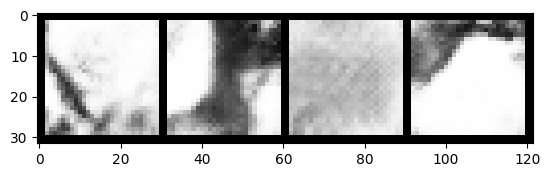

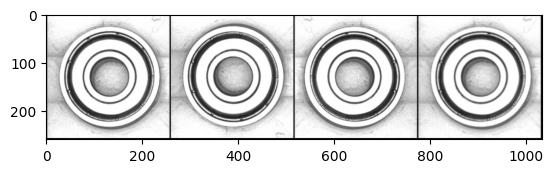

 58%|█████▊    | 196/338 [00:05<00:04, 34.58it/s]

Epoch 208, step 70500: Generator loss: 2.8078237358331695, discriminator loss: 0.22234677473455675


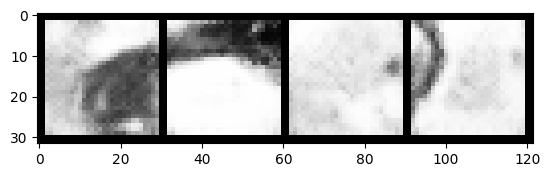

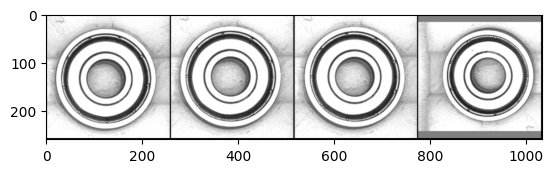

  6%|▌         | 20/338 [00:00<00:09, 33.51it/s]

Epoch 210, step 71000: Generator loss: 2.82520072185993, discriminator loss: 0.21908036926388744


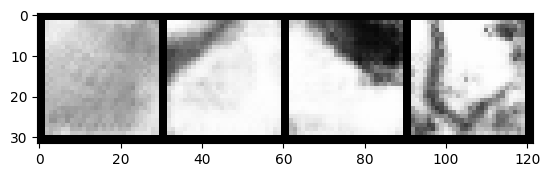

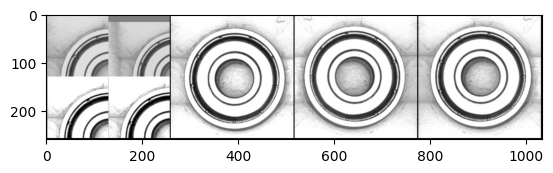

 53%|█████▎    | 180/338 [00:05<00:04, 32.38it/s]

Epoch 211, step 71500: Generator loss: 2.8692148792743684, discriminator loss: 0.22093491333723092


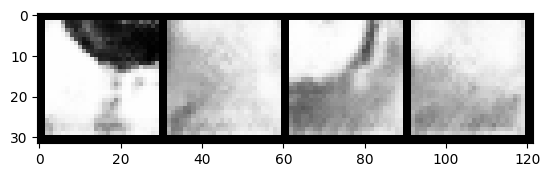

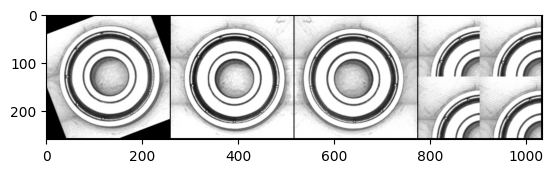

  2%|▏         | 6/338 [00:00<00:13, 25.27it/s]

Epoch 213, step 72000: Generator loss: 2.7815138483047526, discriminator loss: 0.2162199860662222


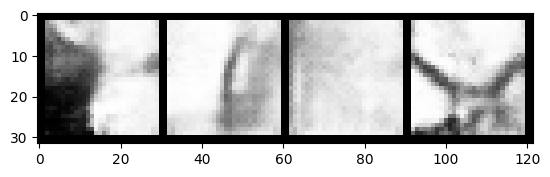

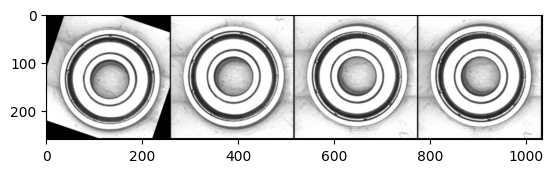

 50%|████▉     | 168/338 [00:05<00:04, 34.29it/s]

Epoch 214, step 72500: Generator loss: 2.8368065943717933, discriminator loss: 0.2190561920702457


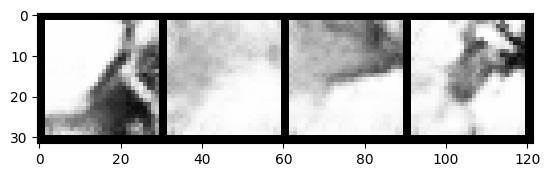

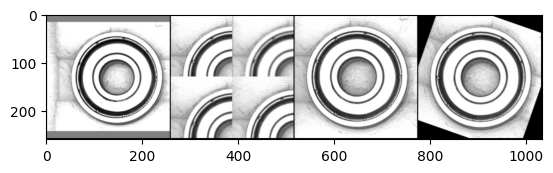

 97%|█████████▋| 328/338 [00:09<00:00, 33.98it/s]

Epoch 215, step 73000: Generator loss: 2.8641349563598633, discriminator loss: 0.2124388697445392


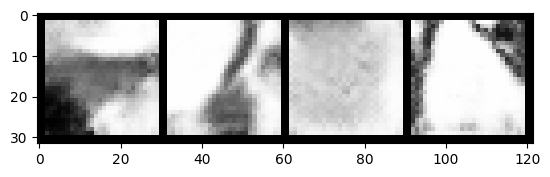

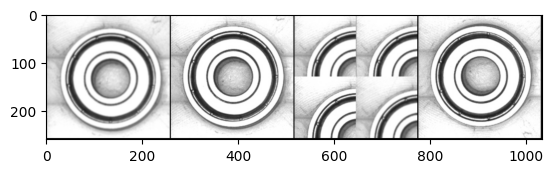

 45%|████▍     | 152/338 [00:04<00:05, 34.56it/s]

Epoch 217, step 73500: Generator loss: 2.881998735070225, discriminator loss: 0.21306985722482194


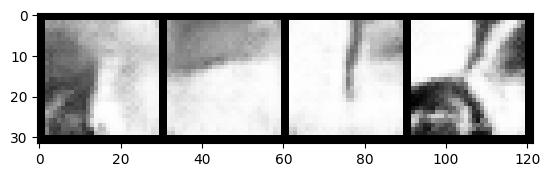

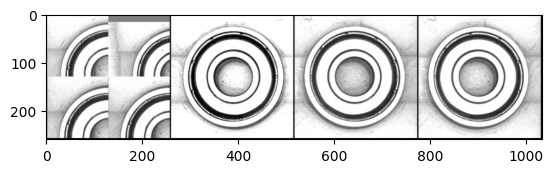

 93%|█████████▎| 316/338 [00:09<00:00, 34.20it/s]

Epoch 218, step 74000: Generator loss: 2.9118521554470056, discriminator loss: 0.20333171514421708


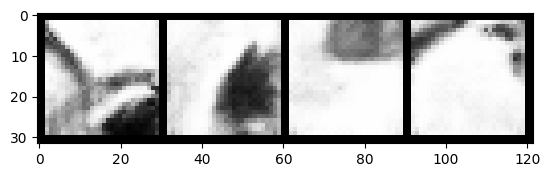

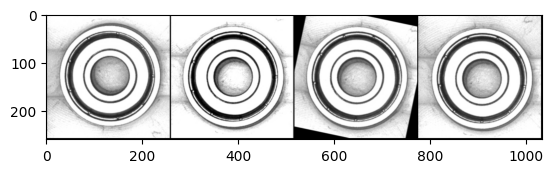

 41%|████▏     | 140/338 [00:04<00:05, 34.06it/s]

Epoch 220, step 74500: Generator loss: 2.922946470022202, discriminator loss: 0.21313103949278586


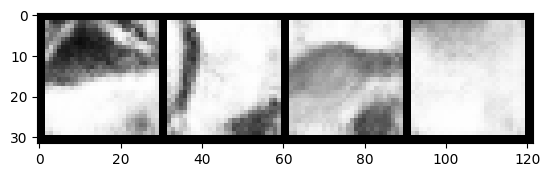

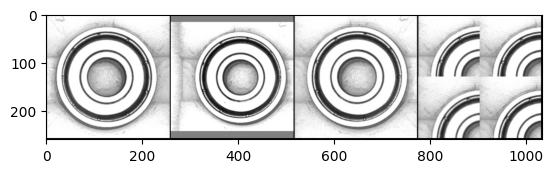

 89%|████████▉ | 300/338 [00:08<00:01, 34.69it/s]

Epoch 221, step 75000: Generator loss: 2.91728278923035, discriminator loss: 0.2262606618851422


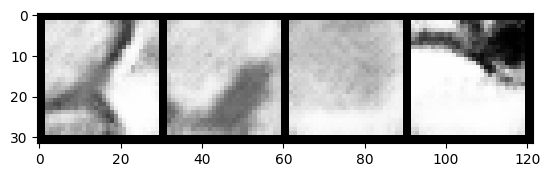

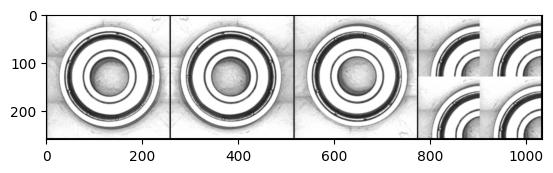

 37%|███▋      | 124/338 [00:03<00:06, 34.34it/s]

Epoch 223, step 75500: Generator loss: 2.8972311853170365, discriminator loss: 0.20540861956030132


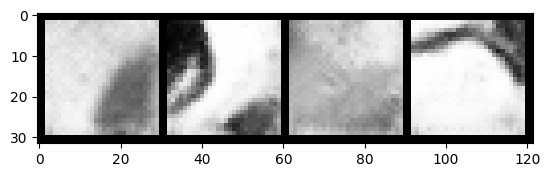

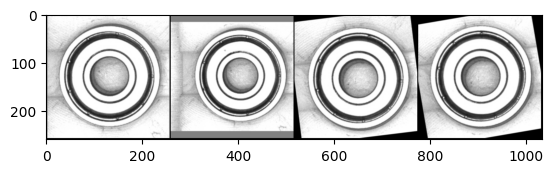

 85%|████████▌ | 288/338 [00:08<00:01, 33.93it/s]

Epoch 224, step 76000: Generator loss: 2.954134419202804, discriminator loss: 0.20825481946766372


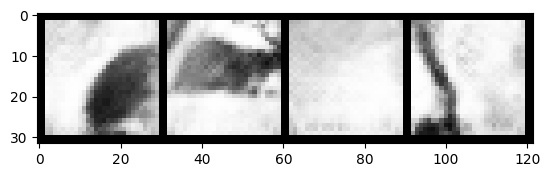

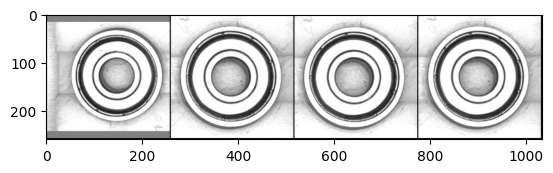

 33%|███▎      | 112/338 [00:03<00:06, 33.23it/s]

Epoch 226, step 76500: Generator loss: 2.922587338805201, discriminator loss: 0.21515042901784182


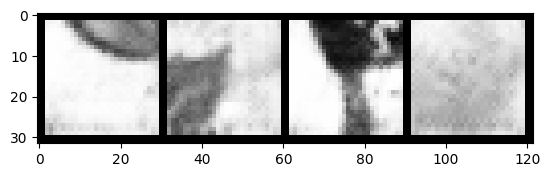

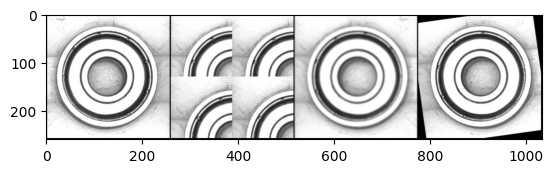

 80%|████████  | 272/338 [00:07<00:01, 33.38it/s]

Epoch 227, step 77000: Generator loss: 3.0009809669256207, discriminator loss: 0.21091028401255615


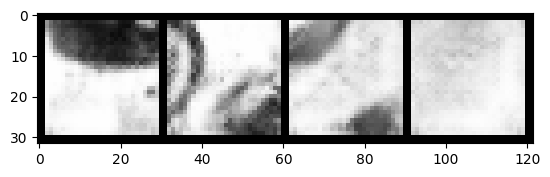

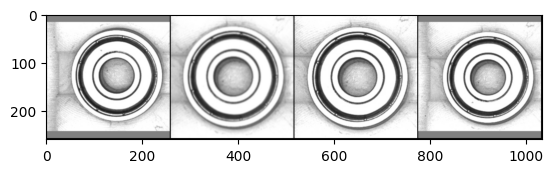

 28%|██▊       | 96/338 [00:02<00:07, 33.86it/s]

Epoch 229, step 77500: Generator loss: 3.02643268609047, discriminator loss: 0.2025346460044385


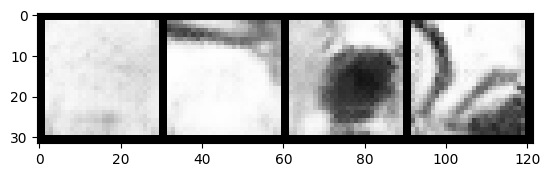

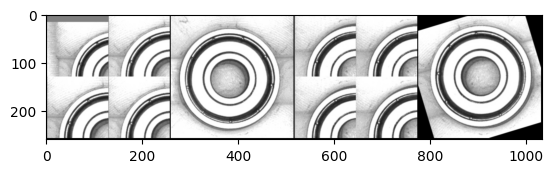

 77%|███████▋  | 260/338 [00:07<00:02, 33.53it/s]

Epoch 230, step 78000: Generator loss: 3.0072675315141715, discriminator loss: 0.20821370248496532


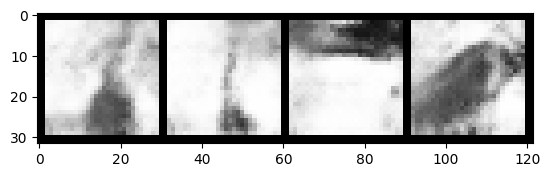

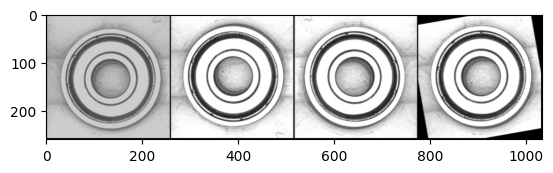

 25%|██▍       | 84/338 [00:02<00:07, 34.09it/s]

Epoch 232, step 78500: Generator loss: 2.9786446900367722, discriminator loss: 0.20944527280330663


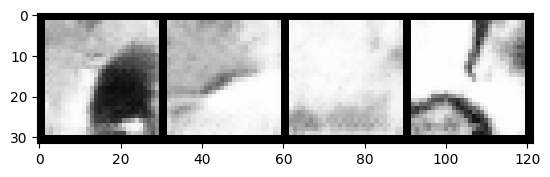

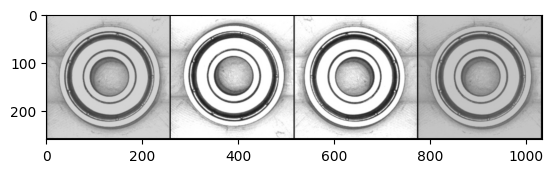

 72%|███████▏  | 244/338 [00:07<00:02, 34.06it/s]

Epoch 233, step 79000: Generator loss: 3.0238275159597414, discriminator loss: 0.2123757051452996


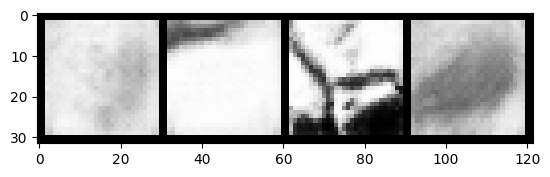

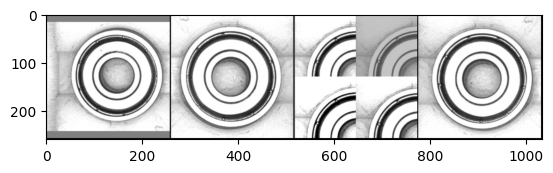

 20%|██        | 68/338 [00:02<00:07, 34.38it/s]

Epoch 235, step 79500: Generator loss: 3.0020752500295664, discriminator loss: 0.19606226352602232


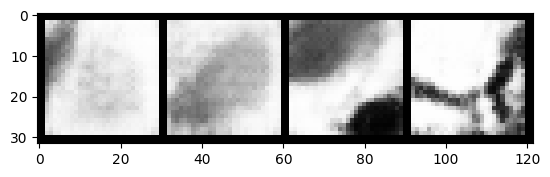

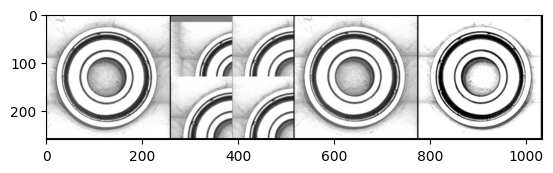

 69%|██████▊   | 232/338 [00:06<00:03, 34.65it/s]

Epoch 236, step 80000: Generator loss: 3.0024243878126176, discriminator loss: 0.20360821753740319


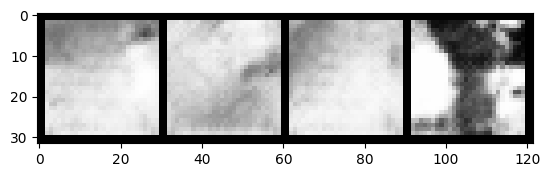

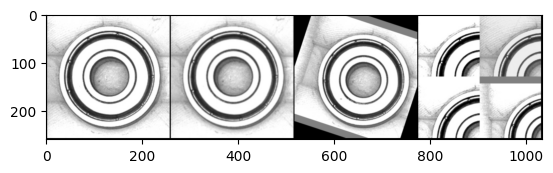

 17%|█▋        | 56/338 [00:01<00:08, 34.23it/s]

Epoch 238, step 80500: Generator loss: 2.976496294617651, discriminator loss: 0.20613213654607507


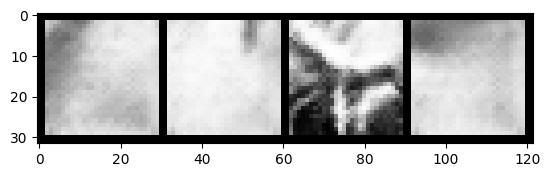

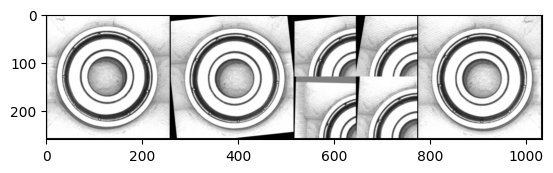

 64%|██████▍   | 216/338 [00:06<00:03, 33.79it/s]

Epoch 239, step 81000: Generator loss: 3.0710761187076585, discriminator loss: 0.20907471142709233


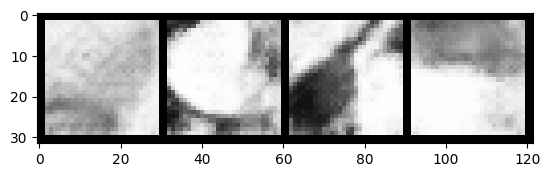

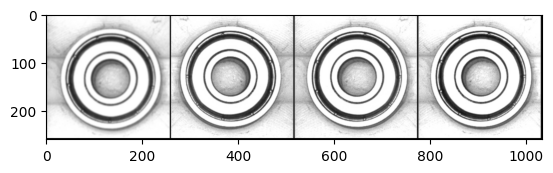

 12%|█▏        | 40/338 [00:01<00:08, 34.24it/s]

Epoch 241, step 81500: Generator loss: 3.0229580972194663, discriminator loss: 0.2117394407764079


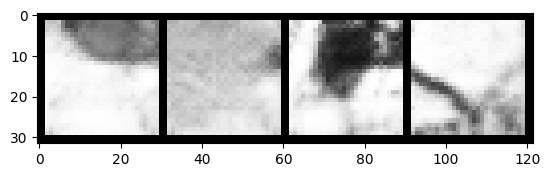

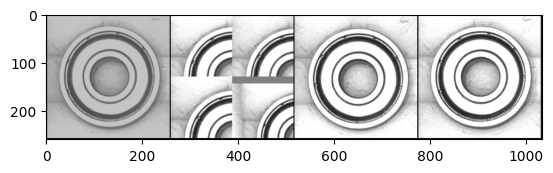

 60%|██████    | 204/338 [00:06<00:04, 30.92it/s]

Epoch 242, step 82000: Generator loss: 3.0728118313550934, discriminator loss: 0.20003952111303813


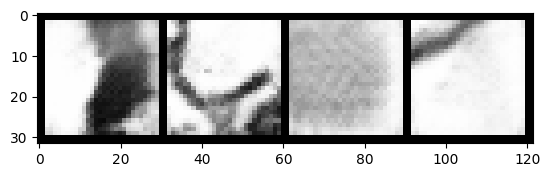

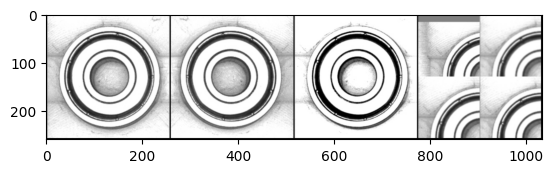

  8%|▊         | 28/338 [00:00<00:09, 33.99it/s]

Epoch 244, step 82500: Generator loss: 3.0862252502441416, discriminator loss: 0.21773270595073696


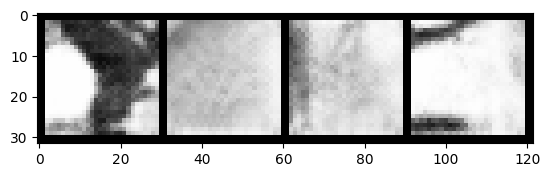

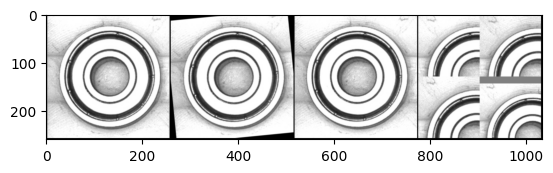

 56%|█████▌    | 188/338 [00:05<00:04, 34.59it/s]

Epoch 245, step 83000: Generator loss: 3.0437042610645277, discriminator loss: 0.2173087535202503


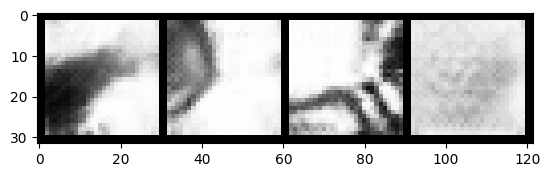

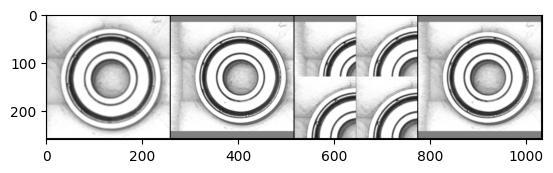

  4%|▎         | 12/338 [00:00<00:09, 35.49it/s]

Epoch 247, step 83500: Generator loss: 3.0571171848773977, discriminator loss: 0.21492737980186946


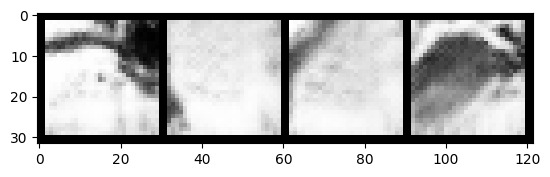

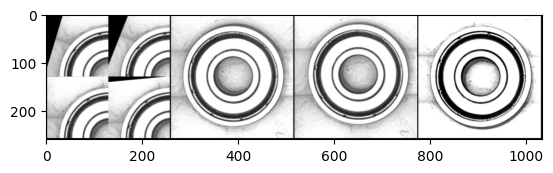

 52%|█████▏    | 176/338 [00:05<00:04, 35.46it/s]

Epoch 248, step 84000: Generator loss: 3.0278534671068216, discriminator loss: 0.20710044179111725


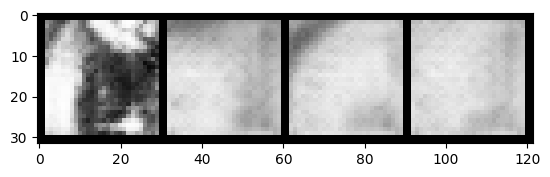

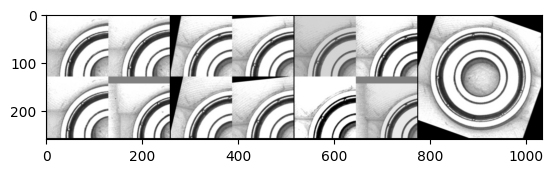

  0%|          | 0/338 [00:00<?, ?it/s]

Epoch 250, step 84500: Generator loss: 2.983948394060134, discriminator loss: 0.19688167622685437


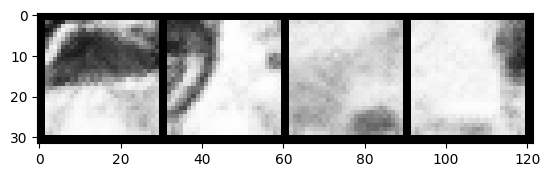

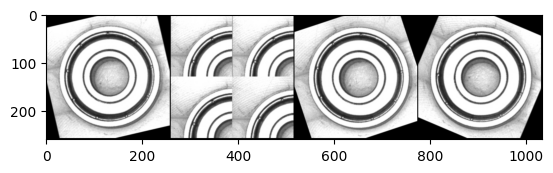

 47%|████▋     | 160/338 [00:04<00:05, 34.94it/s]

Epoch 251, step 85000: Generator loss: 3.0387949191331876, discriminator loss: 0.20313874471187593


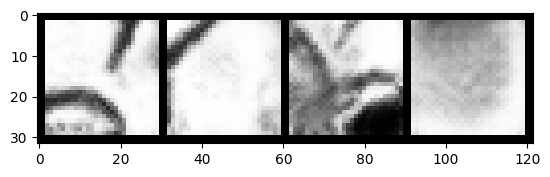

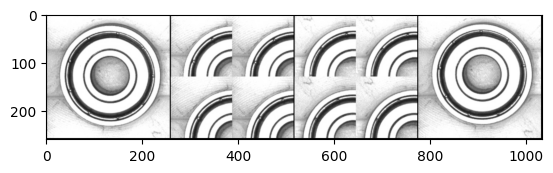

 96%|█████████▌| 324/338 [00:09<00:00, 34.43it/s]

Epoch 252, step 85500: Generator loss: 2.9994937136173205, discriminator loss: 0.2090467916354538


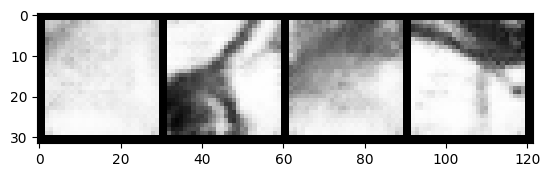

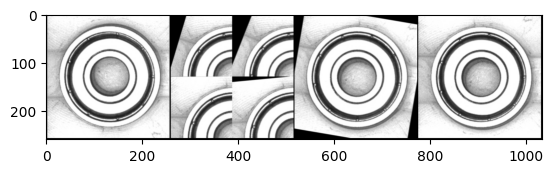

 44%|████▍     | 148/338 [00:04<00:05, 35.01it/s]

Epoch 254, step 86000: Generator loss: 3.040302523851394, discriminator loss: 0.20374657957255835


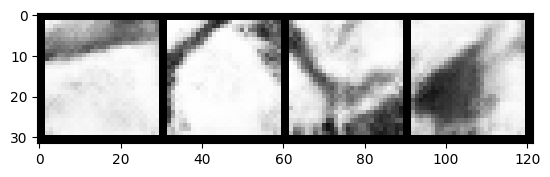

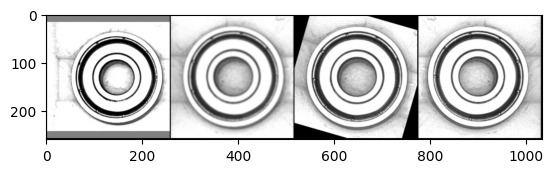

 91%|█████████ | 308/338 [00:09<00:00, 34.60it/s]

Epoch 255, step 86500: Generator loss: 3.012748027801513, discriminator loss: 0.21339100797474383


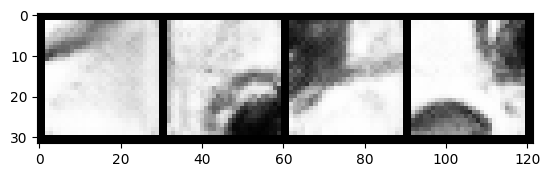

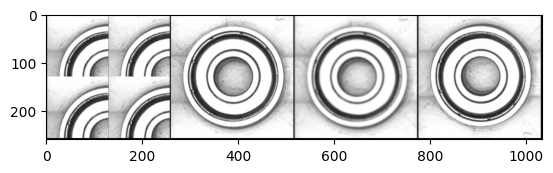

 39%|███▉      | 132/338 [00:03<00:06, 34.14it/s]

Epoch 257, step 87000: Generator loss: 3.137559193372725, discriminator loss: 0.2107976507395504


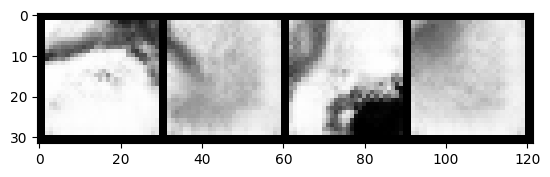

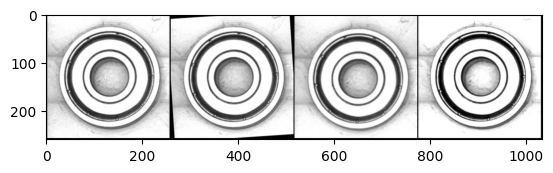

 88%|████████▊ | 296/338 [00:08<00:01, 32.75it/s]

Epoch 258, step 87500: Generator loss: 2.9557114560604107, discriminator loss: 0.21240897521376595


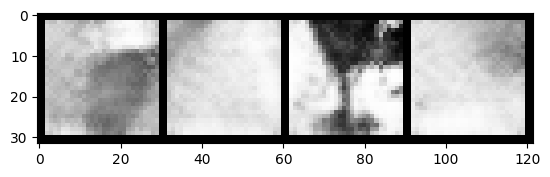

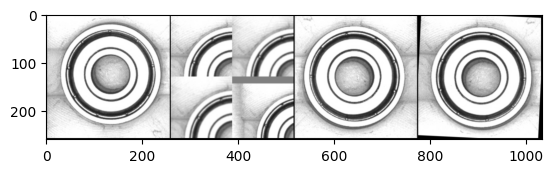

 36%|███▌      | 120/338 [00:03<00:06, 34.05it/s]

Epoch 260, step 88000: Generator loss: 3.027454083204266, discriminator loss: 0.21363940986245866


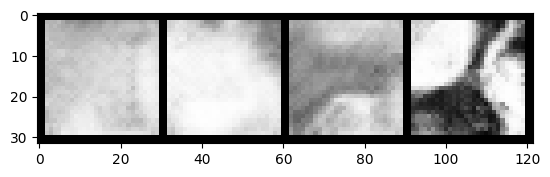

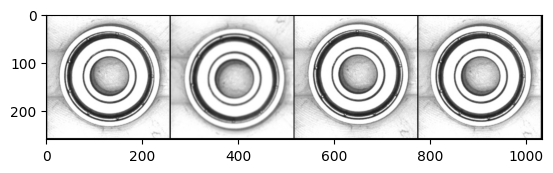

 83%|████████▎ | 280/338 [00:08<00:01, 32.84it/s]

Epoch 261, step 88500: Generator loss: 2.984212976098062, discriminator loss: 0.20474377810209998


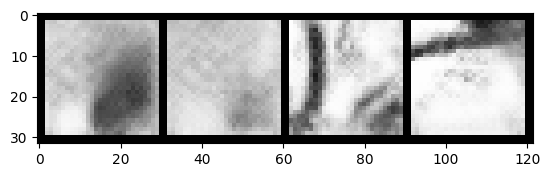

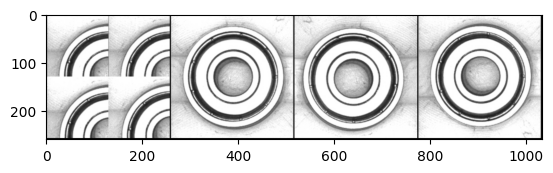

 31%|███       | 104/338 [00:03<00:07, 32.96it/s]

Epoch 263, step 89000: Generator loss: 3.1033777643442195, discriminator loss: 0.19928224071860282


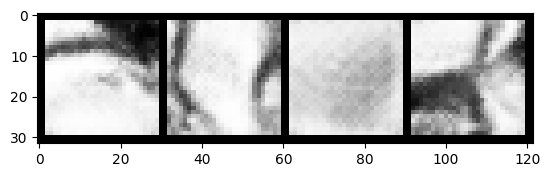

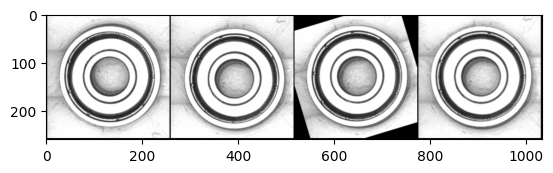

 79%|███████▉  | 268/338 [00:07<00:02, 34.17it/s]

Epoch 264, step 89500: Generator loss: 3.074754592299463, discriminator loss: 0.2066773941367864


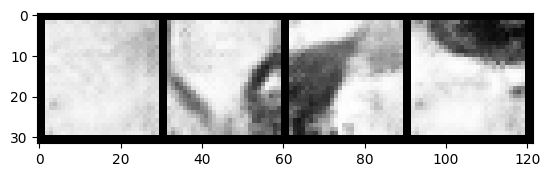

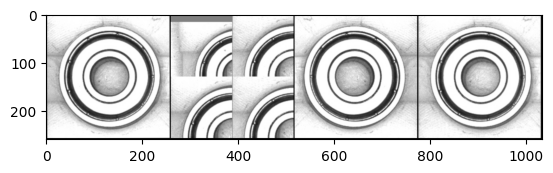

 27%|██▋       | 92/338 [00:02<00:07, 34.72it/s]

Epoch 266, step 90000: Generator loss: 3.0292783312797567, discriminator loss: 0.21126454914361226


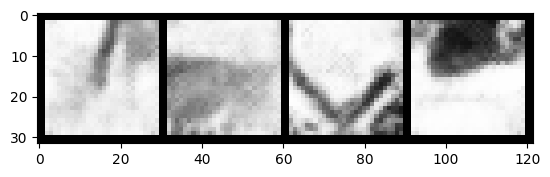

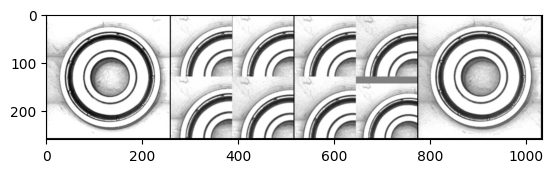

 75%|███████▍  | 252/338 [00:07<00:02, 32.07it/s]

Epoch 267, step 90500: Generator loss: 3.0700332922935476, discriminator loss: 0.21781350275129072


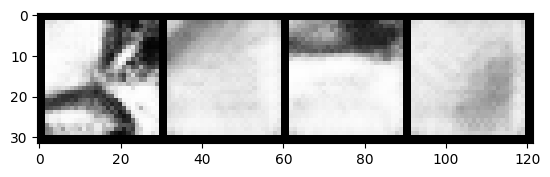

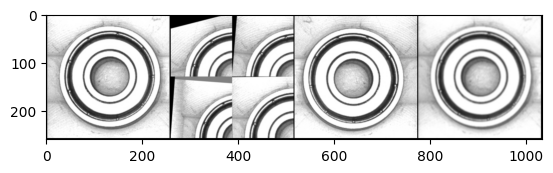

 22%|██▏       | 76/338 [00:02<00:07, 34.01it/s]

Epoch 269, step 91000: Generator loss: 3.088834536552427, discriminator loss: 0.20870971395075327


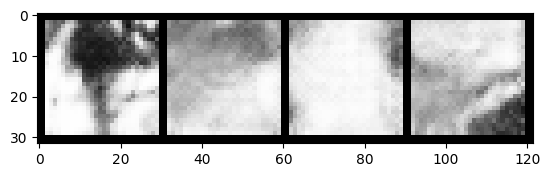

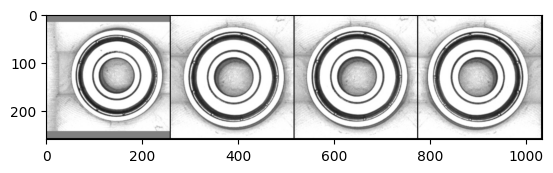

 71%|███████   | 240/338 [00:07<00:02, 34.47it/s]

Epoch 270, step 91500: Generator loss: 3.123722908854481, discriminator loss: 0.21137039234489213


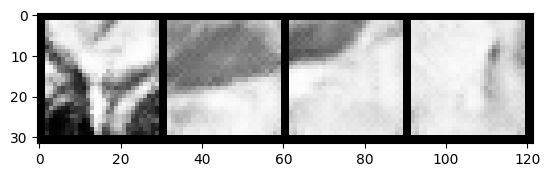

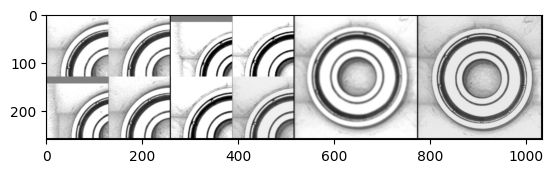

 19%|█▉        | 64/338 [00:01<00:08, 33.61it/s]

Epoch 272, step 92000: Generator loss: 3.108557692527772, discriminator loss: 0.20551710788905606


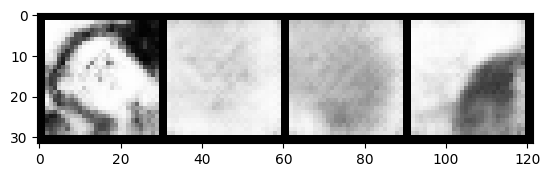

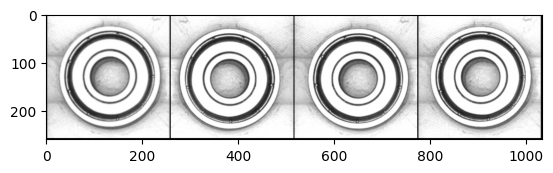

 66%|██████▋   | 224/338 [00:06<00:03, 33.46it/s]

Epoch 273, step 92500: Generator loss: 3.1509524651765863, discriminator loss: 0.20678356307744994


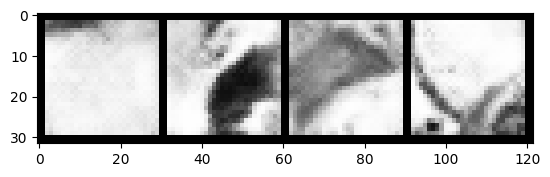

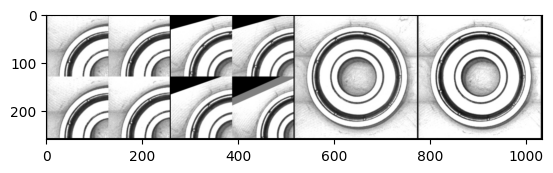

 14%|█▍        | 48/338 [00:01<00:08, 35.29it/s]

Epoch 275, step 93000: Generator loss: 3.1731534762382503, discriminator loss: 0.20505103564262386


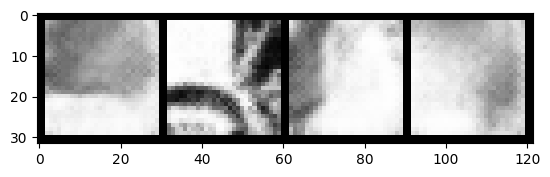

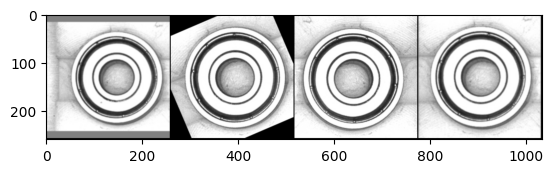

 63%|██████▎   | 212/338 [00:06<00:03, 34.62it/s]

Epoch 276, step 93500: Generator loss: 3.18788922381401, discriminator loss: 0.2099321898445485


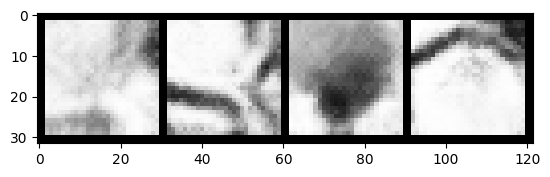

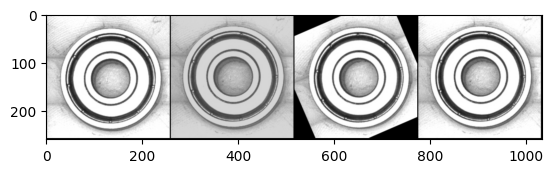

 11%|█         | 36/338 [00:01<00:08, 34.11it/s]

Epoch 278, step 94000: Generator loss: 3.121529616951942, discriminator loss: 0.21151139935106048


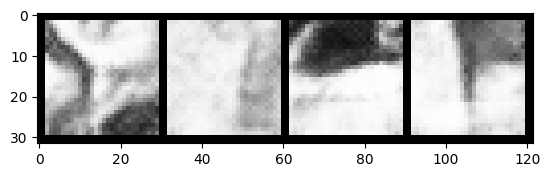

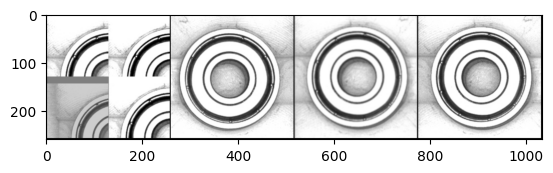

 58%|█████▊    | 196/338 [00:05<00:04, 34.64it/s]

Epoch 279, step 94500: Generator loss: 3.2280419963598264, discriminator loss: 0.20466396763920794


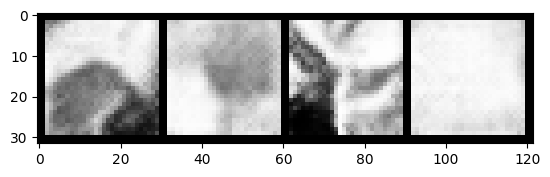

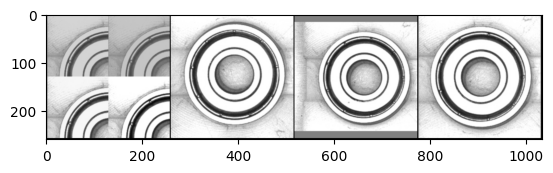

  6%|▌         | 20/338 [00:00<00:09, 34.53it/s]

Epoch 281, step 95000: Generator loss: 3.1586003901958453, discriminator loss: 0.21068400275707236


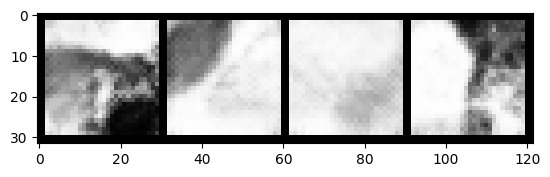

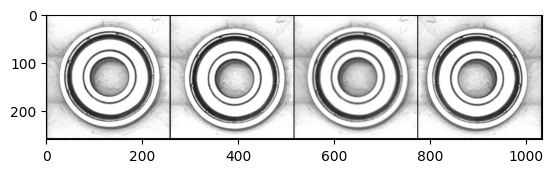

 54%|█████▍    | 184/338 [00:05<00:04, 33.90it/s]

Epoch 282, step 95500: Generator loss: 3.037066349625588, discriminator loss: 0.20358162757009288


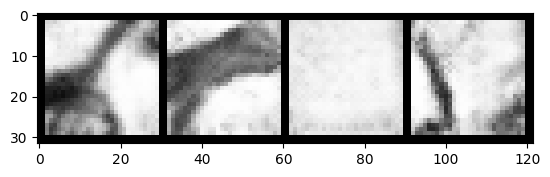

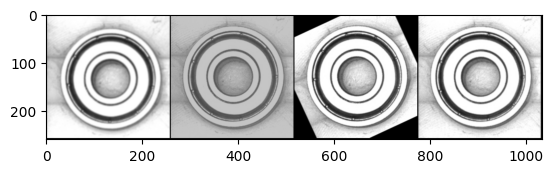

  2%|▏         | 8/338 [00:00<00:09, 33.17it/s]

Epoch 284, step 96000: Generator loss: 3.2081905381679543, discriminator loss: 0.2065787621140479


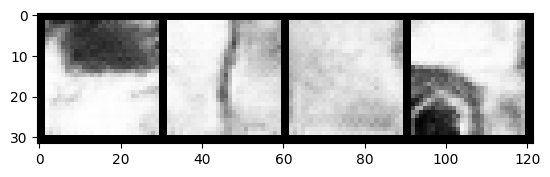

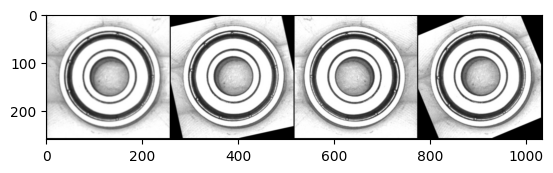

 49%|████▉     | 167/338 [00:04<00:04, 34.22it/s]

Epoch 285, step 96500: Generator loss: 3.1547178859710634, discriminator loss: 0.2056251515001058


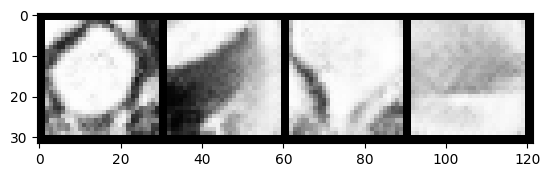

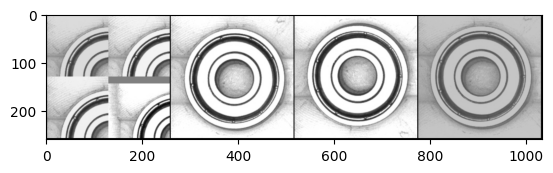

 98%|█████████▊| 332/338 [00:09<00:00, 34.77it/s]

Epoch 286, step 97000: Generator loss: 3.056710688114165, discriminator loss: 0.21267121943086376


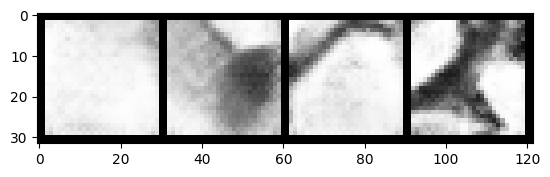

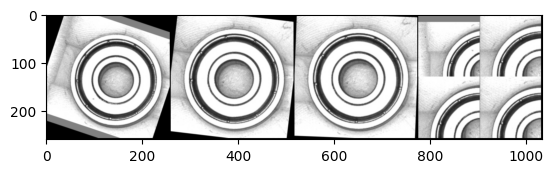

 46%|████▌     | 156/338 [00:04<00:05, 34.07it/s]

Epoch 288, step 97500: Generator loss: 3.1629324519634245, discriminator loss: 0.21059574415534718


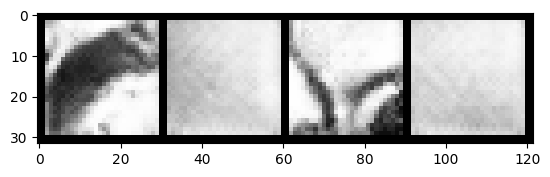

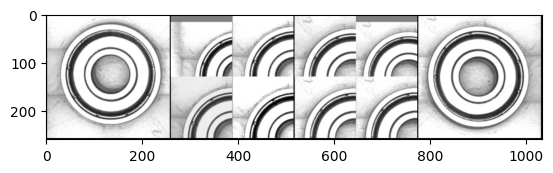

 93%|█████████▎| 316/338 [00:09<00:00, 33.15it/s]

Epoch 289, step 98000: Generator loss: 3.0638671257495886, discriminator loss: 0.20386954164505017


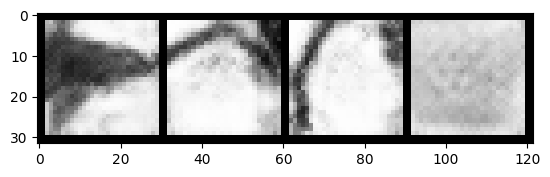

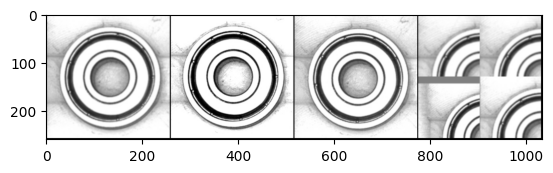

 41%|████▏     | 140/338 [00:04<00:05, 34.14it/s]

Epoch 291, step 98500: Generator loss: 3.1233261537551877, discriminator loss: 0.21367589403688889


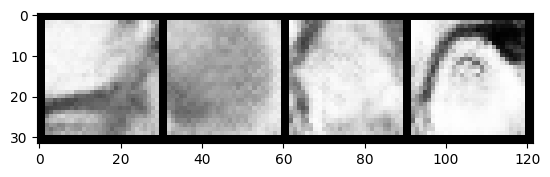

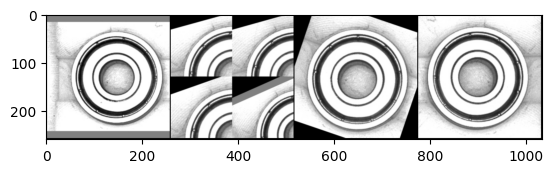

 90%|████████▉ | 304/338 [00:08<00:00, 34.93it/s]

Epoch 292, step 99000: Generator loss: 3.149490362405779, discriminator loss: 0.21405949250608675


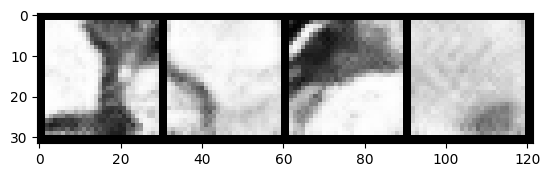

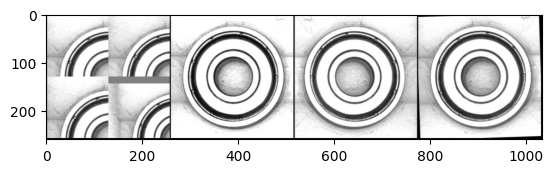

 38%|███▊      | 128/338 [00:03<00:06, 33.18it/s]

Epoch 294, step 99500: Generator loss: 3.12639108300209, discriminator loss: 0.21613297600299136


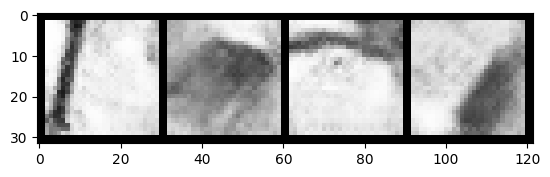

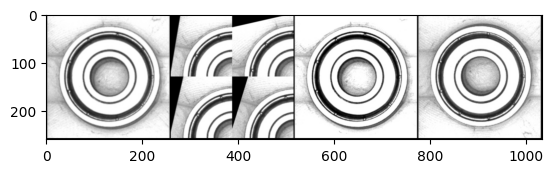

 85%|████████▌ | 288/338 [00:08<00:01, 33.13it/s]

Epoch 295, step 100000: Generator loss: 3.1604756895303727, discriminator loss: 0.21365965687483546


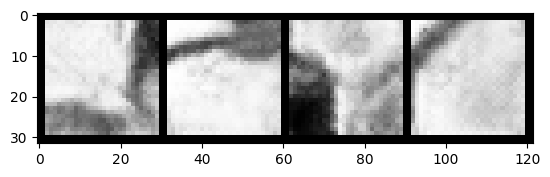

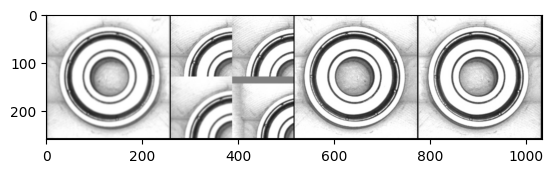

 33%|███▎      | 112/338 [00:03<00:06, 33.73it/s]

Epoch 297, step 100500: Generator loss: 3.118037761926654, discriminator loss: 0.2047878213971854


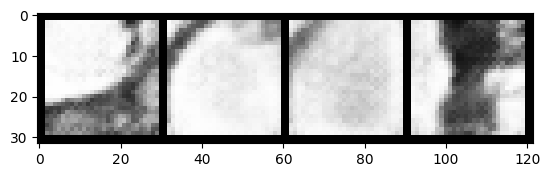

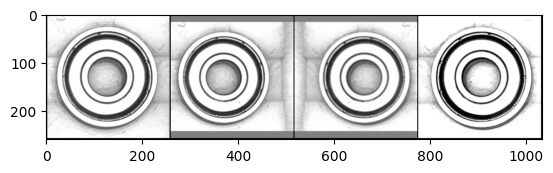

 82%|████████▏ | 276/338 [00:08<00:01, 34.76it/s]

Epoch 298, step 101000: Generator loss: 3.1059122684001936, discriminator loss: 0.22060699415206908


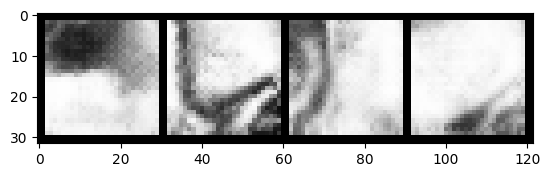

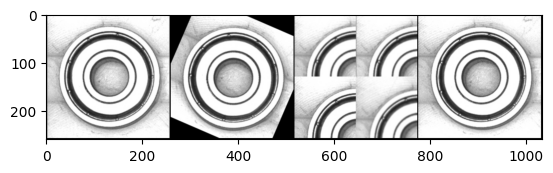

 30%|██▉       | 100/338 [00:03<00:07, 32.30it/s]

Epoch 300, step 101500: Generator loss: 3.1803919506073006, discriminator loss: 0.22372500568628298


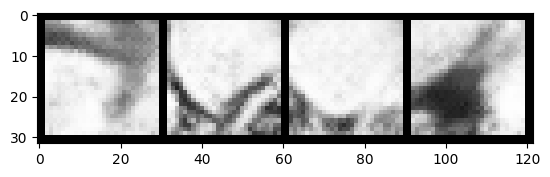

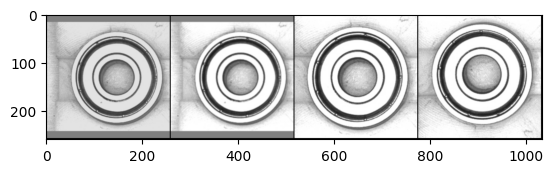

 77%|███████▋  | 260/338 [00:07<00:02, 34.85it/s]

Epoch 301, step 102000: Generator loss: 3.1336085931062683, discriminator loss: 0.22258457812666912


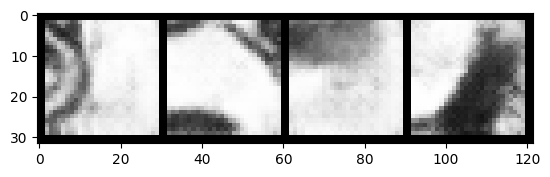

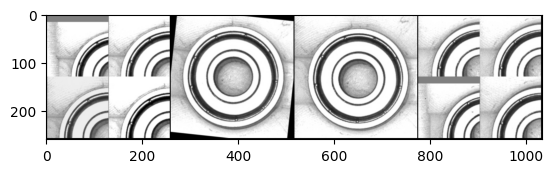

 25%|██▍       | 84/338 [00:02<00:07, 35.67it/s]

Epoch 303, step 102500: Generator loss: 3.140037359833716, discriminator loss: 0.21805494293570504


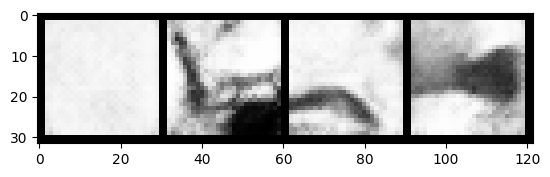

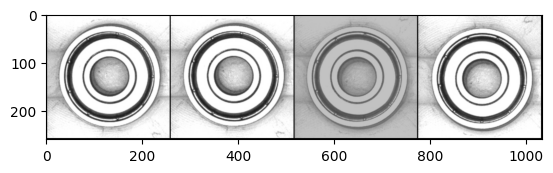

 73%|███████▎  | 248/338 [00:07<00:02, 33.52it/s]

Epoch 304, step 103000: Generator loss: 3.1214024915695218, discriminator loss: 0.21458008383214477


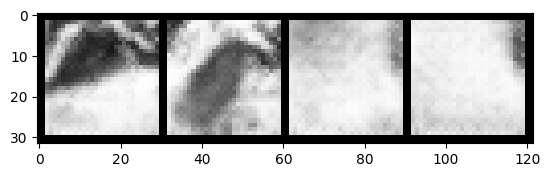

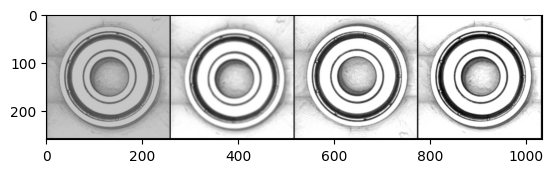

 21%|██▏       | 72/338 [00:02<00:07, 34.47it/s]

Epoch 306, step 103500: Generator loss: 3.101888818740847, discriminator loss: 0.20875764936208716


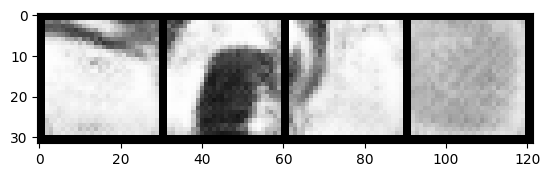

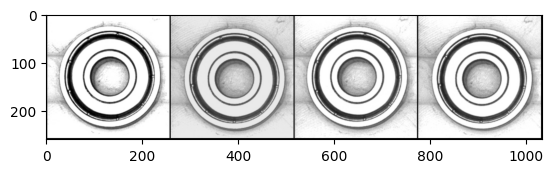

 69%|██████▊   | 232/338 [00:06<00:03, 32.71it/s]

Epoch 307, step 104000: Generator loss: 3.1562043434381497, discriminator loss: 0.2036538418903946


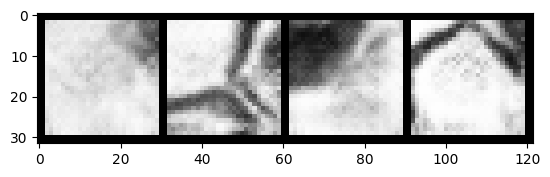

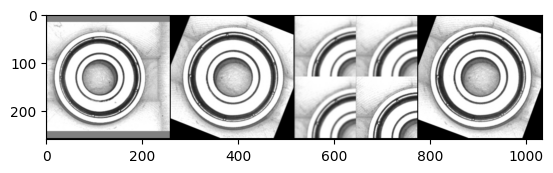

 17%|█▋        | 56/338 [00:01<00:08, 34.94it/s]

Epoch 309, step 104500: Generator loss: 3.101444317340852, discriminator loss: 0.21397292632609594


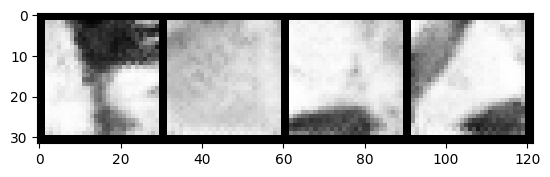

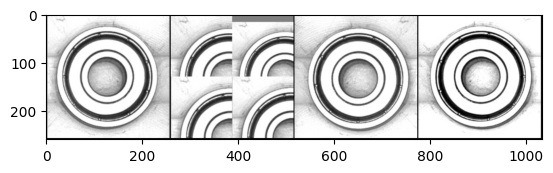

 65%|██████▌   | 220/338 [00:06<00:03, 33.86it/s]

Epoch 310, step 105000: Generator loss: 3.1700595915317513, discriminator loss: 0.21088647492974996


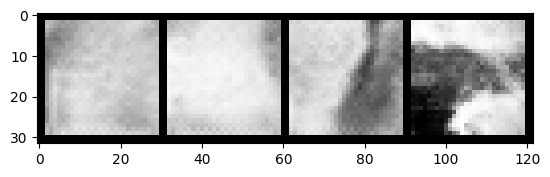

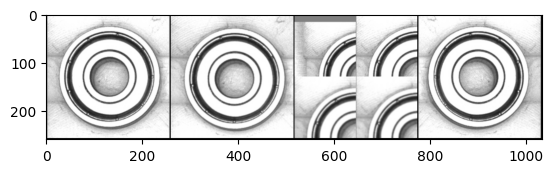

 13%|█▎        | 44/338 [00:01<00:08, 33.55it/s]

Epoch 312, step 105500: Generator loss: 3.1444720754623376, discriminator loss: 0.21964488683640943


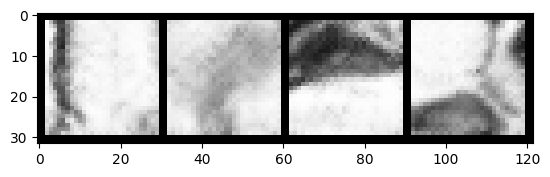

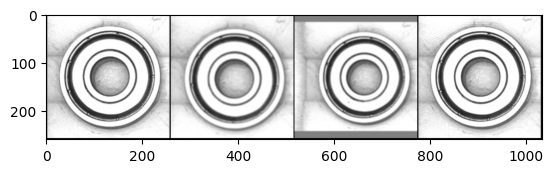

 60%|██████    | 204/338 [00:05<00:03, 34.37it/s]

Epoch 313, step 106000: Generator loss: 3.2269194309711495, discriminator loss: 0.2183787982389331


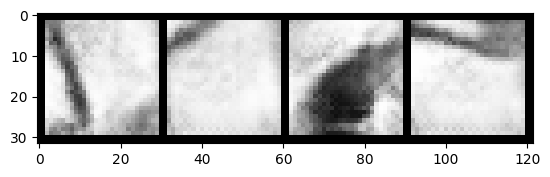

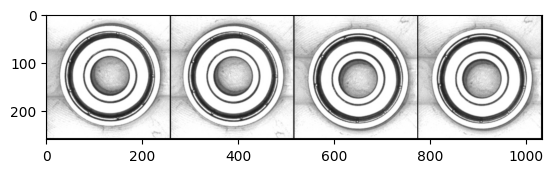

  8%|▊         | 28/338 [00:00<00:09, 33.49it/s]

Epoch 315, step 106500: Generator loss: 3.159039938807487, discriminator loss: 0.2089089213982225


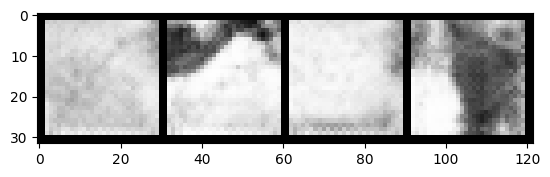

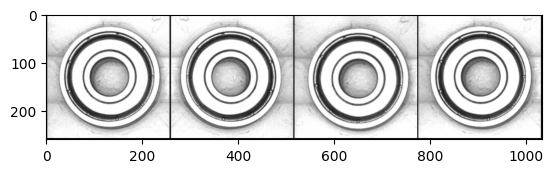

 57%|█████▋    | 192/338 [00:05<00:04, 33.75it/s]

Epoch 316, step 107000: Generator loss: 3.2756859475374194, discriminator loss: 0.20489823735505333


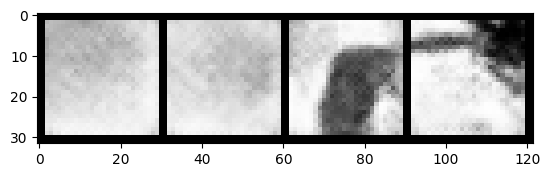

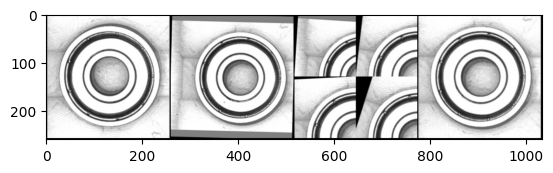

  5%|▍         | 16/338 [00:00<00:09, 34.65it/s]

Epoch 318, step 107500: Generator loss: 3.2128135539293288, discriminator loss: 0.22103002058714635


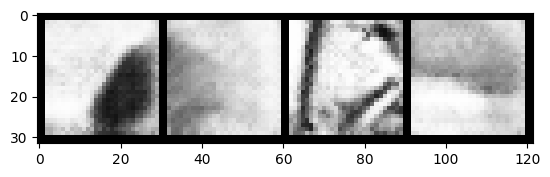

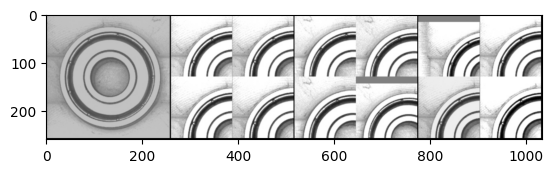

 52%|█████▏    | 176/338 [00:05<00:04, 33.91it/s]

Epoch 319, step 108000: Generator loss: 3.1410826892852795, discriminator loss: 0.2142418227046729


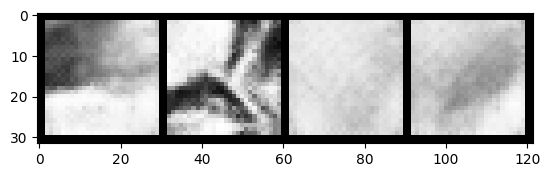

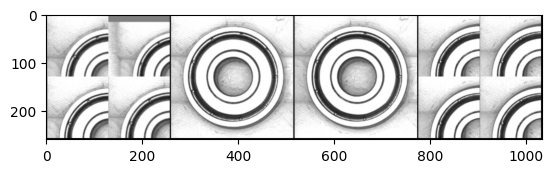

  0%|          | 0/338 [00:00<?, ?it/s]

Epoch 321, step 108500: Generator loss: 3.17392085587978, discriminator loss: 0.21930735381692645


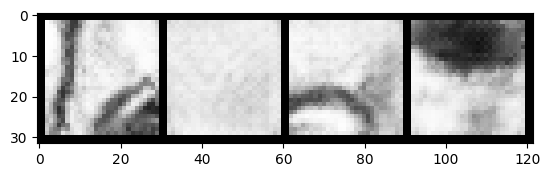

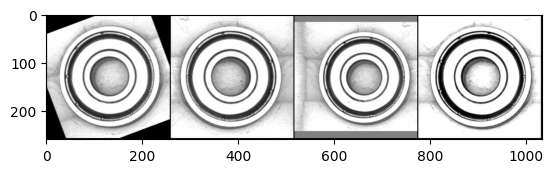

 48%|████▊     | 161/338 [00:04<00:05, 34.14it/s]

Epoch 322, step 109000: Generator loss: 3.081781019449234, discriminator loss: 0.20925238736718899


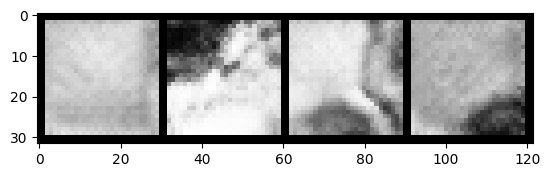

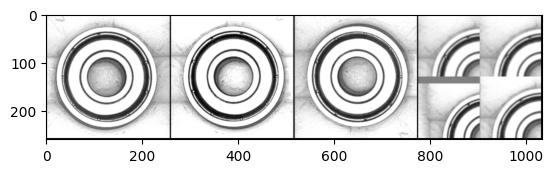

 96%|█████████▌| 324/338 [00:09<00:00, 33.59it/s]

Epoch 323, step 109500: Generator loss: 3.1903843080997474, discriminator loss: 0.19890648341178896


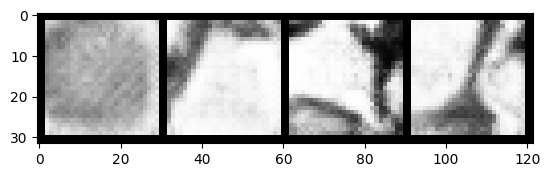

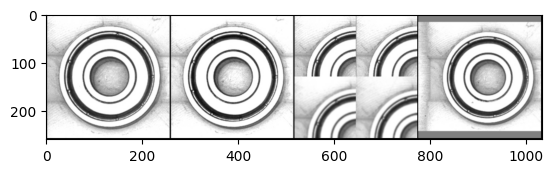

 44%|████▍     | 148/338 [00:04<00:05, 34.12it/s]

Epoch 325, step 110000: Generator loss: 3.1663946969509174, discriminator loss: 0.20026989919692273


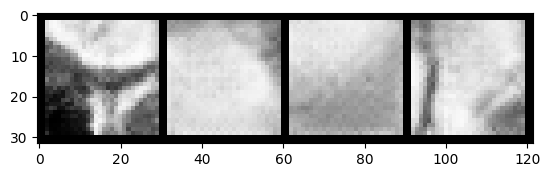

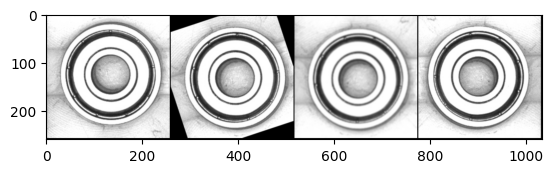

 92%|█████████▏| 312/338 [00:09<00:00, 33.84it/s]

Epoch 326, step 110500: Generator loss: 3.215116102457051, discriminator loss: 0.21771866812556986


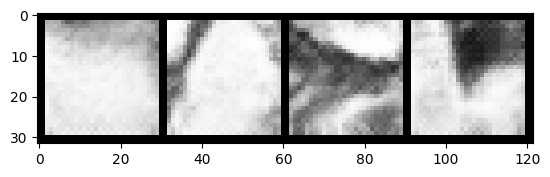

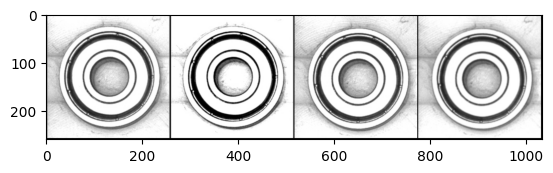

 40%|████      | 136/338 [00:03<00:05, 34.27it/s]

Epoch 328, step 111000: Generator loss: 3.199723926544191, discriminator loss: 0.216758059255779


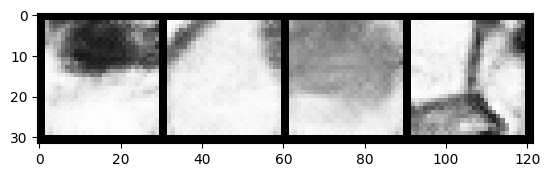

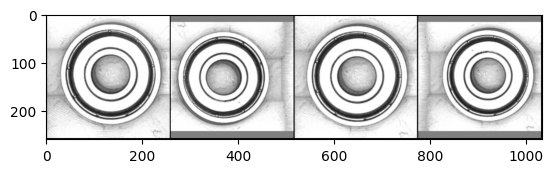

 88%|████████▊ | 296/338 [00:08<00:01, 34.17it/s]

Epoch 329, step 111500: Generator loss: 3.248071300506593, discriminator loss: 0.2160279178470373


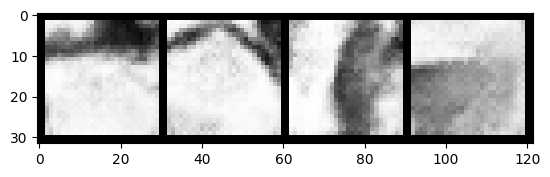

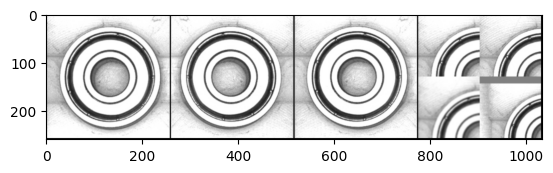

 36%|███▌      | 120/338 [00:03<00:06, 33.76it/s]

Epoch 331, step 112000: Generator loss: 3.183310289859771, discriminator loss: 0.21771852155029767


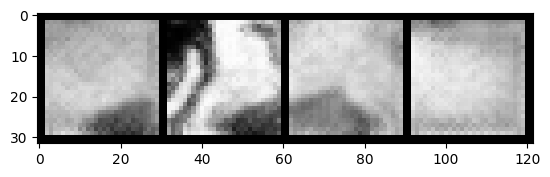

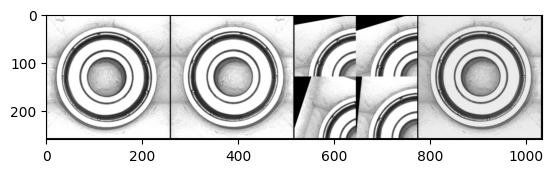

 84%|████████▍ | 284/338 [00:08<00:01, 33.79it/s]

Epoch 332, step 112500: Generator loss: 3.1344074801206583, discriminator loss: 0.2144296190813183


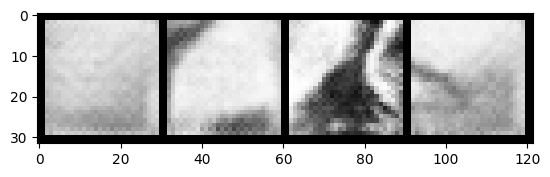

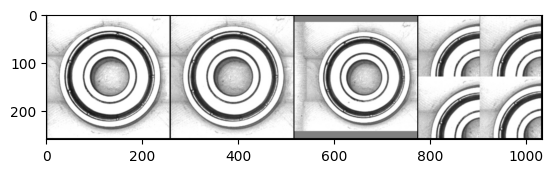

 32%|███▏      | 108/338 [00:03<00:06, 33.76it/s]

Epoch 334, step 113000: Generator loss: 3.207714055895801, discriminator loss: 0.21899860110878927


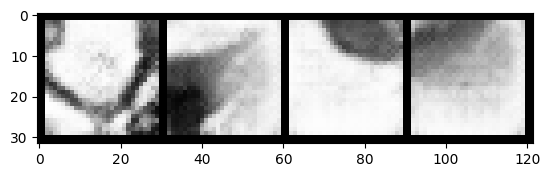

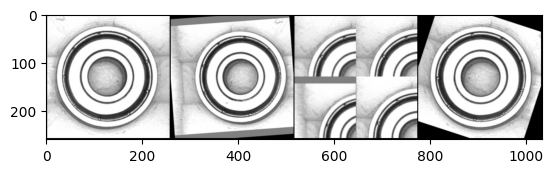

 79%|███████▉  | 267/338 [00:07<00:02, 33.38it/s]

Epoch 335, step 113500: Generator loss: 3.2387588138580305, discriminator loss: 0.23301706732809543


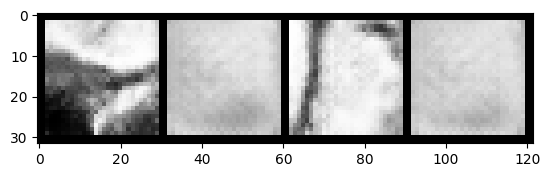

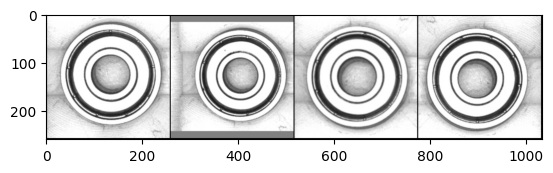

 27%|██▋       | 92/338 [00:02<00:07, 34.07it/s]

Epoch 337, step 114000: Generator loss: 3.1131297947168344, discriminator loss: 0.22109572315961126


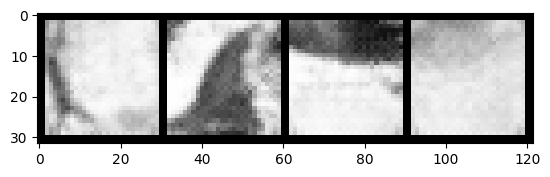

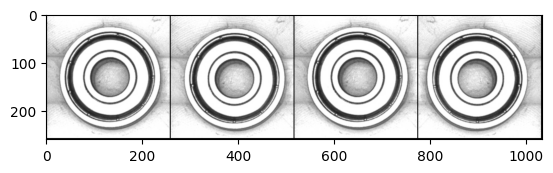

 76%|███████▌  | 256/338 [00:07<00:02, 33.38it/s]

Epoch 338, step 114500: Generator loss: 3.1942908561229713, discriminator loss: 0.21829759378731253


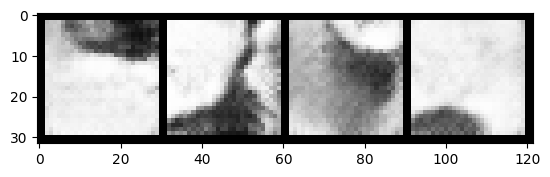

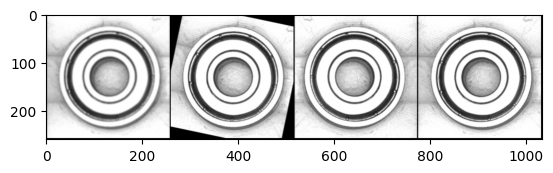

 24%|██▎       | 80/338 [00:02<00:07, 34.41it/s]

Epoch 340, step 115000: Generator loss: 3.2025518761873237, discriminator loss: 0.21752033773064597


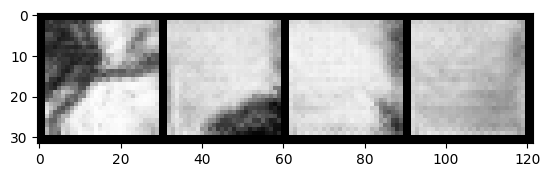

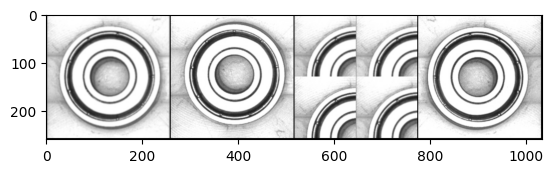

 71%|███████   | 240/338 [00:07<00:02, 33.02it/s]

Epoch 341, step 115500: Generator loss: 3.2696582889556907, discriminator loss: 0.2073896682858467


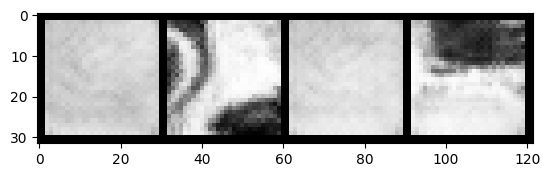

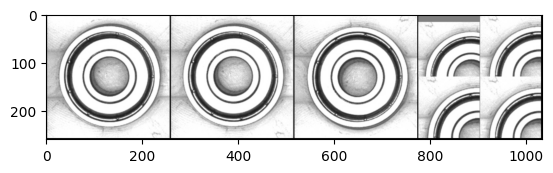

 19%|█▉        | 64/338 [00:01<00:08, 34.07it/s]

Epoch 343, step 116000: Generator loss: 3.198494724750519, discriminator loss: 0.21423476554453366


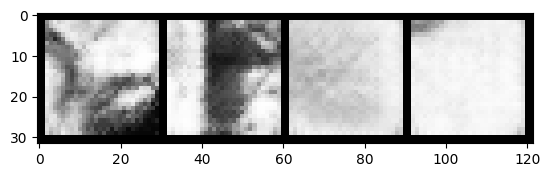

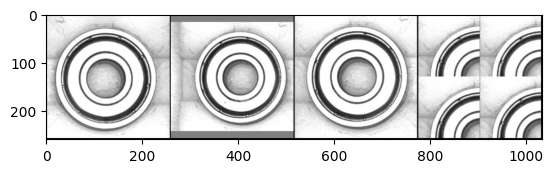

 67%|██████▋   | 228/338 [00:06<00:03, 33.53it/s]

Epoch 344, step 116500: Generator loss: 3.0680070354938516, discriminator loss: 0.22765423183888195


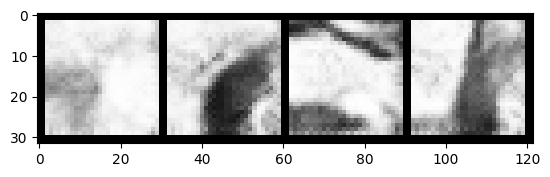

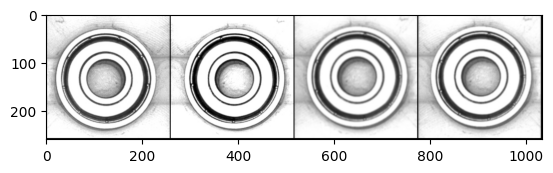

 15%|█▌        | 52/338 [00:01<00:08, 34.12it/s]

Epoch 346, step 117000: Generator loss: 3.138856431007387, discriminator loss: 0.21613630090653882


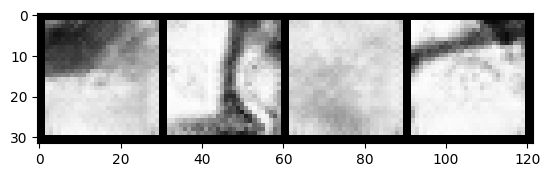

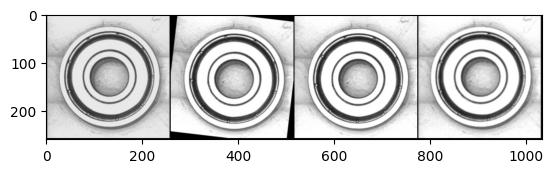

 63%|██████▎   | 212/338 [00:06<00:03, 33.33it/s]

Epoch 347, step 117500: Generator loss: 3.1303273701667766, discriminator loss: 0.21333051007986073


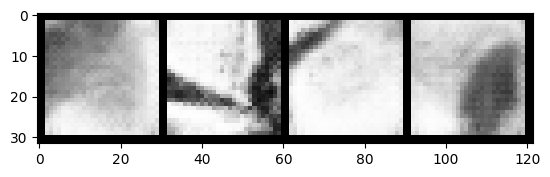

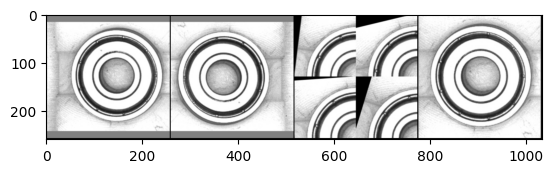

 11%|█         | 36/338 [00:01<00:08, 34.05it/s]

Epoch 349, step 118000: Generator loss: 3.2704489055871977, discriminator loss: 0.2242769650295379


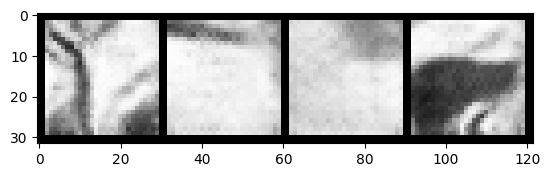

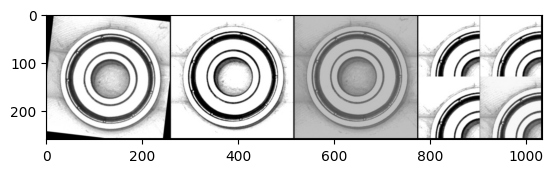

 59%|█████▉    | 200/338 [00:05<00:04, 31.80it/s]

Epoch 350, step 118500: Generator loss: 3.1999065794944745, discriminator loss: 0.22762599574029452


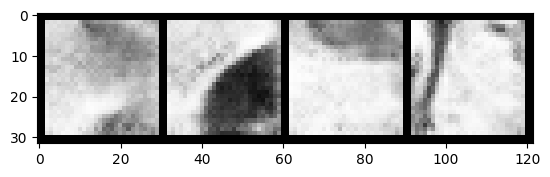

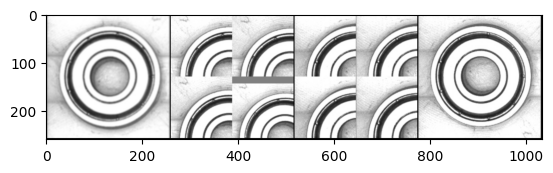

  7%|▋         | 24/338 [00:00<00:09, 33.94it/s]

Epoch 352, step 119000: Generator loss: 3.1698816555738425, discriminator loss: 0.23602941861748722


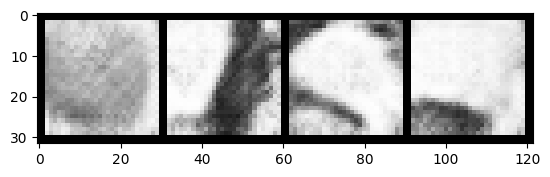

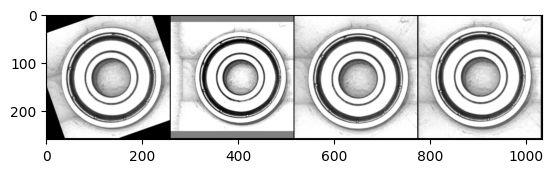

 54%|█████▍    | 183/338 [00:05<00:04, 33.50it/s]

Epoch 353, step 119500: Generator loss: 3.0961707394123064, discriminator loss: 0.21933108408376564


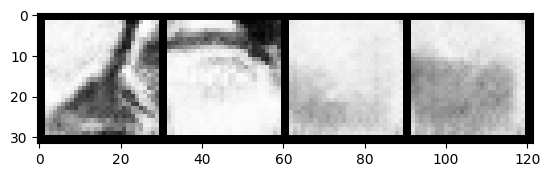

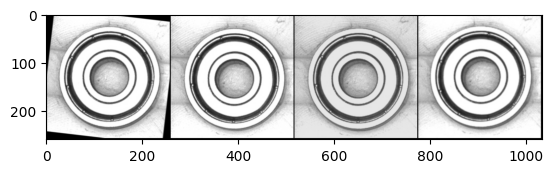

  2%|▏         | 8/338 [00:00<00:09, 35.74it/s]

Epoch 355, step 120000: Generator loss: 3.1225283448696137, discriminator loss: 0.2173593412116168


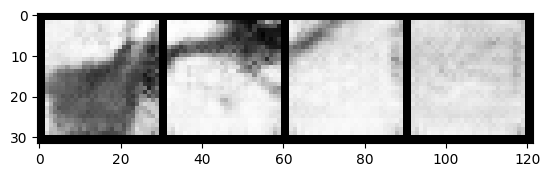

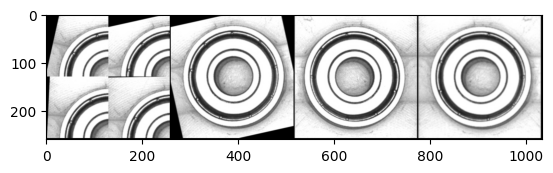

 51%|█████     | 172/338 [00:05<00:05, 32.58it/s]

Epoch 356, step 120500: Generator loss: 3.2544079966545105, discriminator loss: 0.23905456825345753


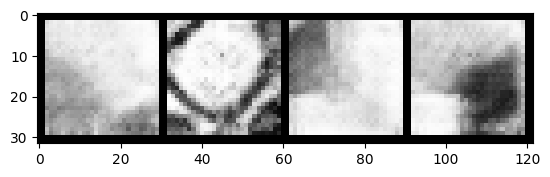

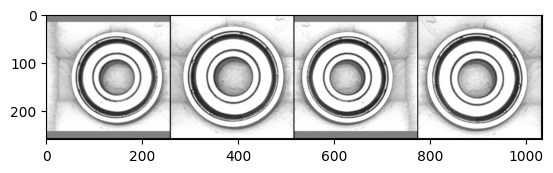

 98%|█████████▊| 332/338 [00:09<00:00, 33.86it/s]

Epoch 357, step 121000: Generator loss: 3.126556069135663, discriminator loss: 0.22577845770120628


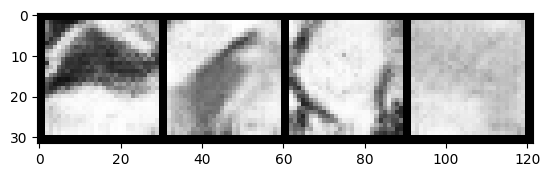

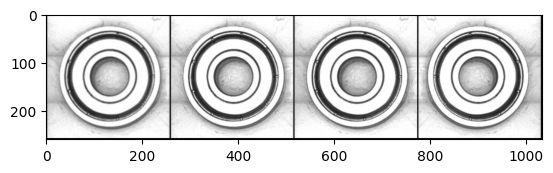

 46%|████▌     | 156/338 [00:04<00:05, 34.39it/s]

Epoch 359, step 121500: Generator loss: 3.118301773071287, discriminator loss: 0.24767133261263363


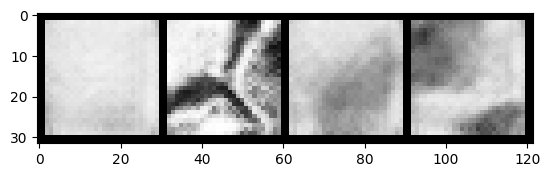

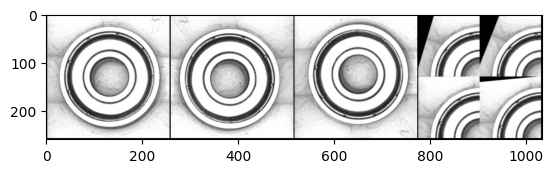

 95%|█████████▍| 320/338 [00:09<00:00, 33.70it/s]

Epoch 360, step 122000: Generator loss: 3.1696053408384337, discriminator loss: 0.21347934713214622


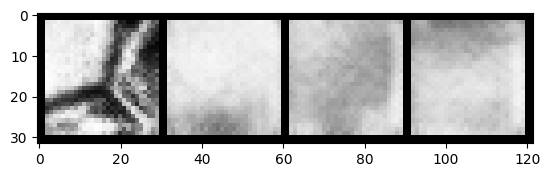

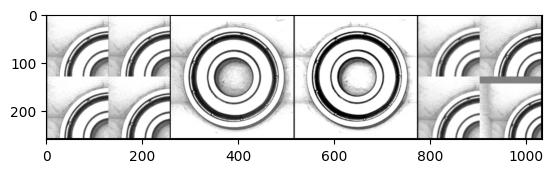

 43%|████▎     | 144/338 [00:04<00:05, 34.98it/s]

Epoch 362, step 122500: Generator loss: 3.16854060089588, discriminator loss: 0.25045087150484313


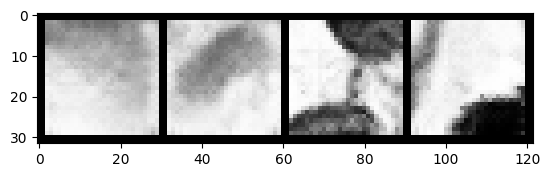

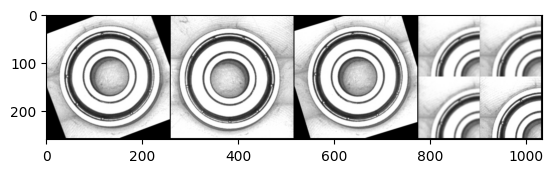

 90%|████████▉ | 304/338 [00:09<00:01, 33.59it/s]

Epoch 363, step 123000: Generator loss: 3.119198474526406, discriminator loss: 0.23684170031547566


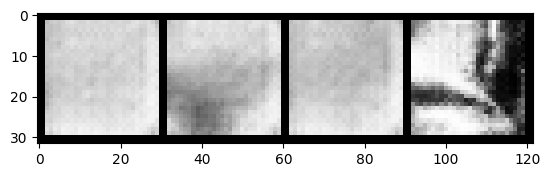

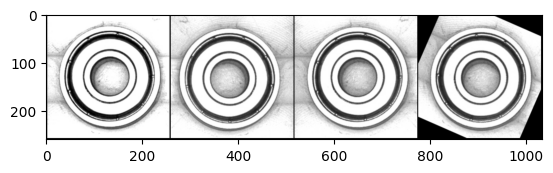

 38%|███▊      | 128/338 [00:03<00:05, 35.19it/s]

Epoch 365, step 123500: Generator loss: 3.120413579940796, discriminator loss: 0.2364468872845171


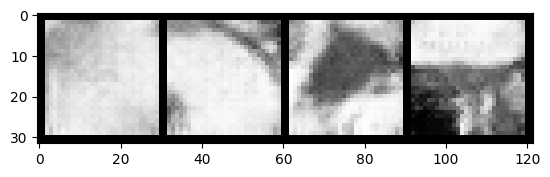

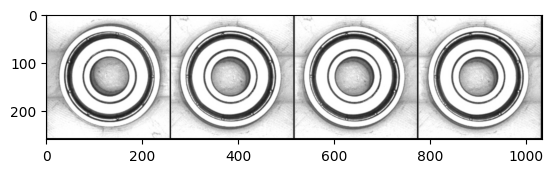

 86%|████████▋ | 292/338 [00:08<00:01, 34.72it/s]

Epoch 366, step 124000: Generator loss: 3.159660469889641, discriminator loss: 0.23302528849244106


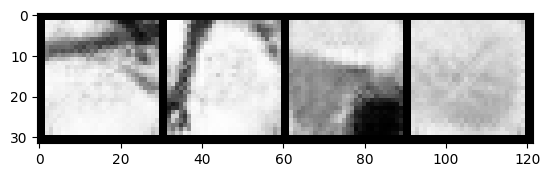

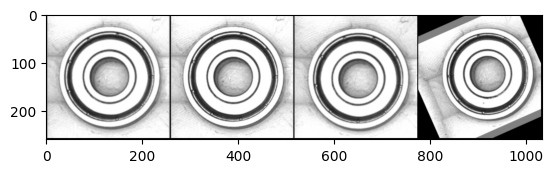

 34%|███▍      | 116/338 [00:03<00:06, 33.41it/s]

Epoch 368, step 124500: Generator loss: 3.039575678050516, discriminator loss: 0.24520542231202153


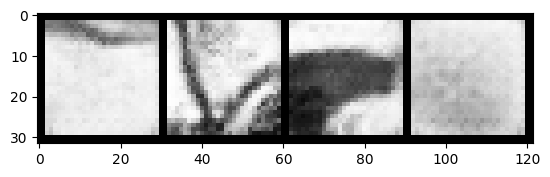

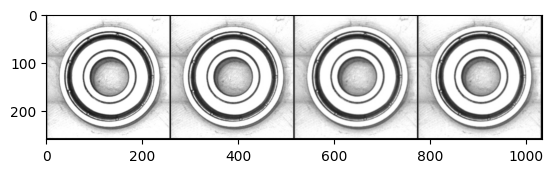

 82%|████████▏ | 276/338 [00:08<00:01, 32.24it/s]

Epoch 369, step 125000: Generator loss: 3.1287685039639452, discriminator loss: 0.25172782487422224


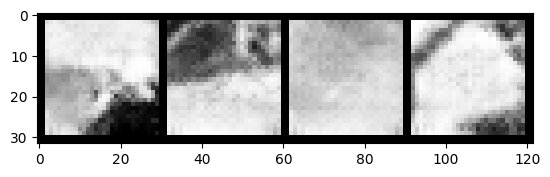

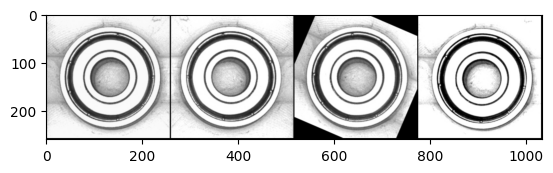

 30%|██▉       | 100/338 [00:02<00:07, 33.27it/s]

Epoch 371, step 125500: Generator loss: 3.0228573315143565, discriminator loss: 0.2555588271692394


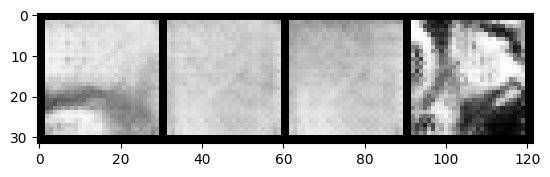

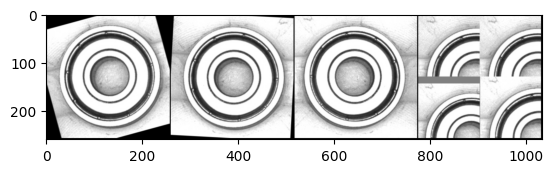

 78%|███████▊  | 264/338 [00:07<00:02, 33.75it/s]

Epoch 372, step 126000: Generator loss: 3.1711976016759866, discriminator loss: 0.25170814713835743


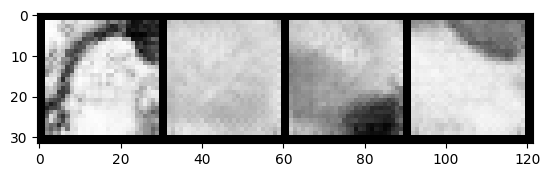

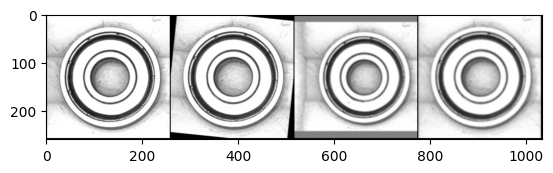

 26%|██▌       | 88/338 [00:02<00:07, 33.40it/s]

Epoch 374, step 126500: Generator loss: 3.180168384313584, discriminator loss: 0.2565408299416304


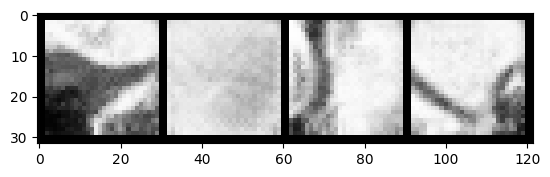

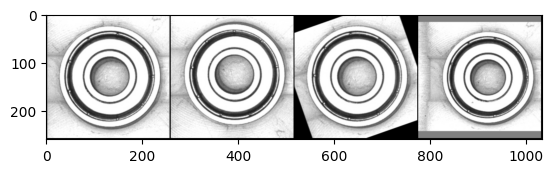

 73%|███████▎  | 248/338 [00:07<00:02, 35.02it/s]

Epoch 375, step 127000: Generator loss: 3.0645418925285357, discriminator loss: 0.23808598133176553


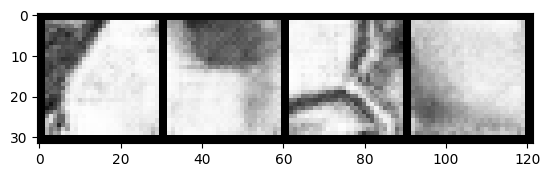

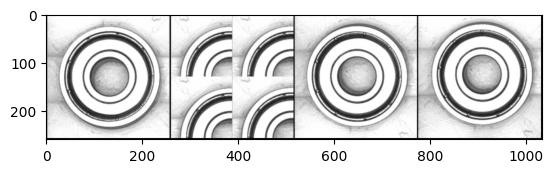

 21%|██▏       | 72/338 [00:02<00:07, 33.72it/s]

Epoch 377, step 127500: Generator loss: 3.1374147793054585, discriminator loss: 0.25430200432240985


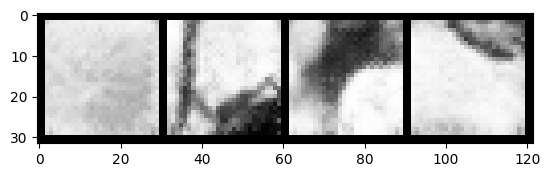

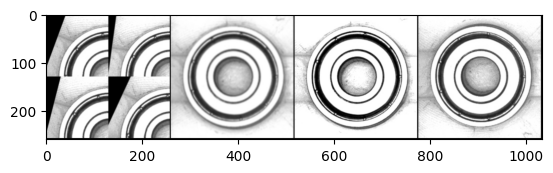

 70%|██████▉   | 236/338 [00:06<00:02, 34.24it/s]

Epoch 378, step 128000: Generator loss: 3.1293779535293593, discriminator loss: 0.24467277257144446


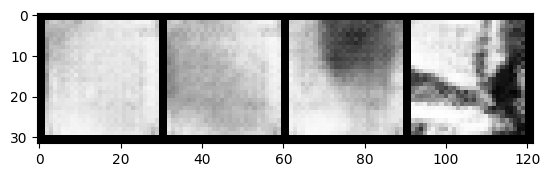

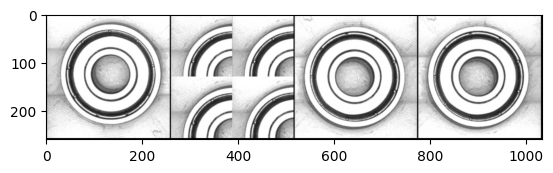

 18%|█▊        | 60/338 [00:01<00:08, 32.65it/s]

Epoch 380, step 128500: Generator loss: 3.134081601023677, discriminator loss: 0.25113033003360036


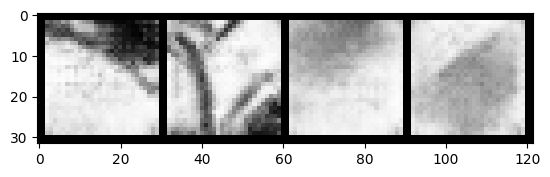

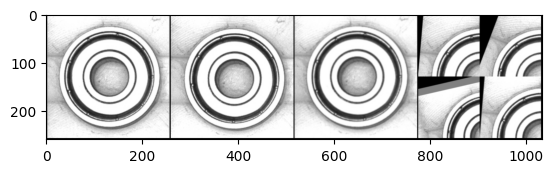

 65%|██████▌   | 220/338 [00:06<00:03, 34.59it/s]

Epoch 381, step 129000: Generator loss: 3.0949011178016663, discriminator loss: 0.2420047735646366


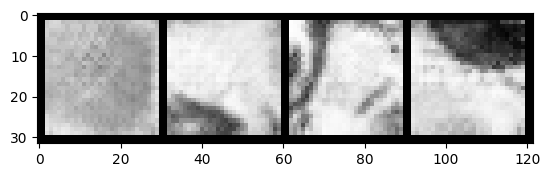

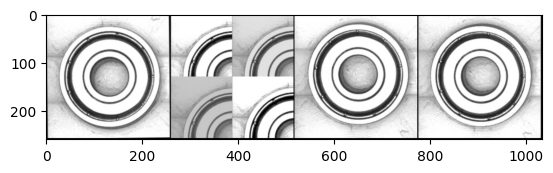

 13%|█▎        | 44/338 [00:01<00:08, 32.79it/s]

Epoch 383, step 129500: Generator loss: 3.091937551617623, discriminator loss: 0.2624408932924271


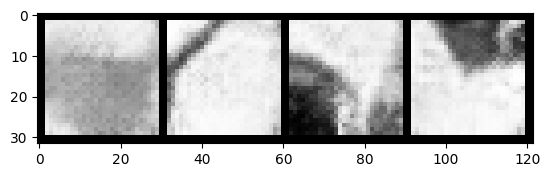

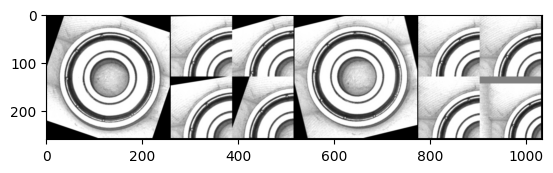

 62%|██████▏   | 208/338 [00:06<00:03, 34.13it/s]

Epoch 384, step 130000: Generator loss: 3.053754292368889, discriminator loss: 0.2615255845338109


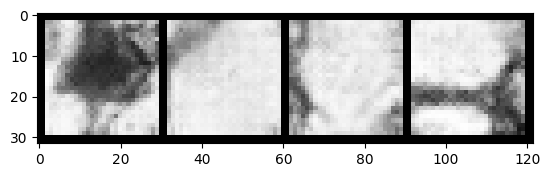

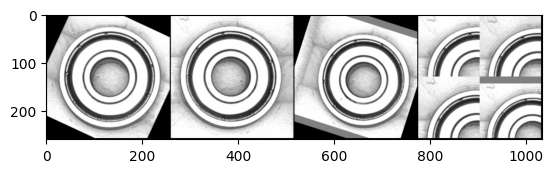

  9%|▉         | 32/338 [00:00<00:08, 34.50it/s]

Epoch 386, step 130500: Generator loss: 3.0756059085130705, discriminator loss: 0.24620435649156555


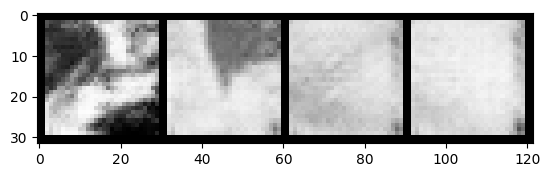

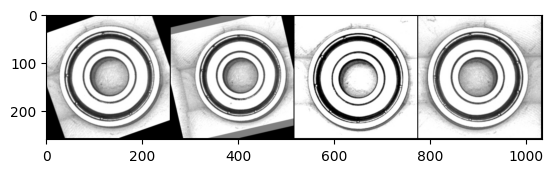

 57%|█████▋    | 192/338 [00:05<00:04, 35.14it/s]

Epoch 387, step 131000: Generator loss: 3.0434758185148256, discriminator loss: 0.2832817537859081


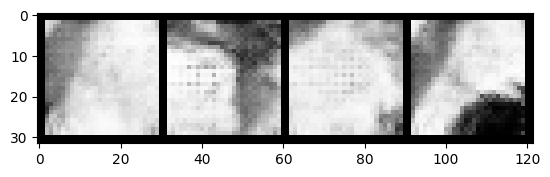

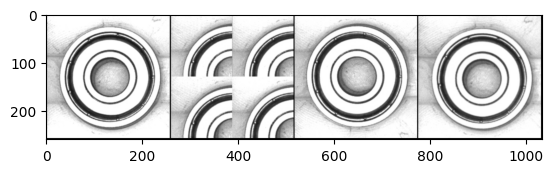

  5%|▍         | 16/338 [00:00<00:09, 34.91it/s]

Epoch 389, step 131500: Generator loss: 2.9625014207959177, discriminator loss: 0.267537400737405


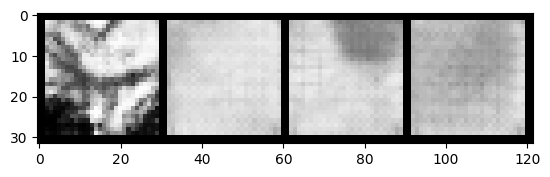

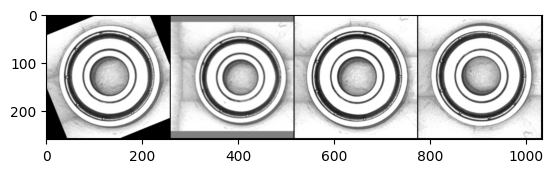

 53%|█████▎    | 179/338 [00:05<00:04, 34.35it/s]

Epoch 390, step 132000: Generator loss: 2.9529307668209053, discriminator loss: 0.25205705352872615


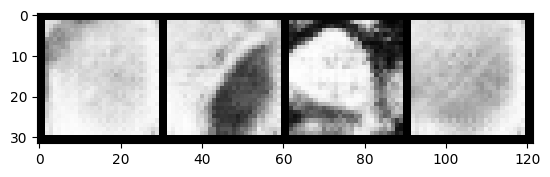

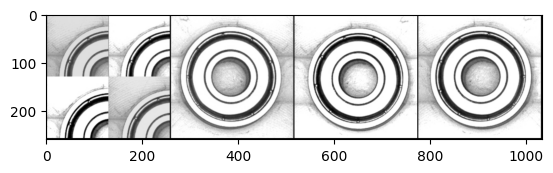

  1%|          | 4/338 [00:00<00:09, 34.63it/s]

Epoch 392, step 132500: Generator loss: 3.0018505660295483, discriminator loss: 0.24389197076112018


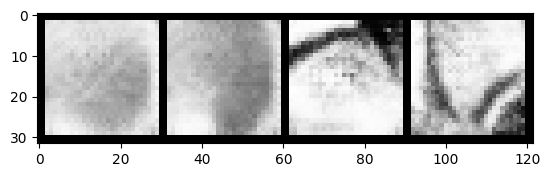

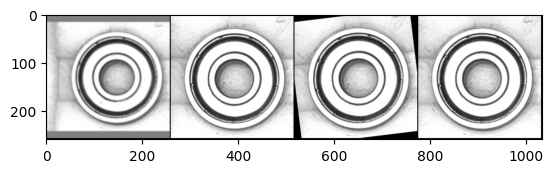

 49%|████▊     | 164/338 [00:04<00:05, 33.19it/s]

Epoch 393, step 133000: Generator loss: 3.032375509500504, discriminator loss: 0.2592292332872751


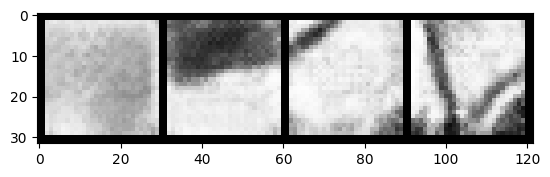

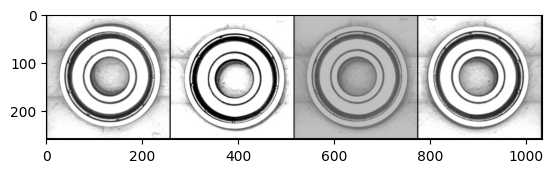

 97%|█████████▋| 328/338 [00:09<00:00, 33.62it/s]

Epoch 394, step 133500: Generator loss: 3.0267788734436034, discriminator loss: 0.2800262623876335


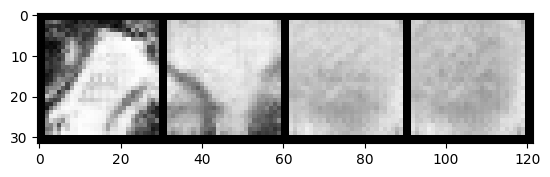

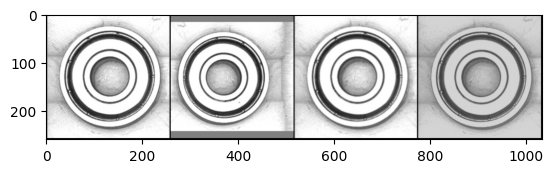

 45%|████▍     | 152/338 [00:04<00:05, 33.91it/s]

Epoch 396, step 134000: Generator loss: 3.0768747482299816, discriminator loss: 0.25699131752550597


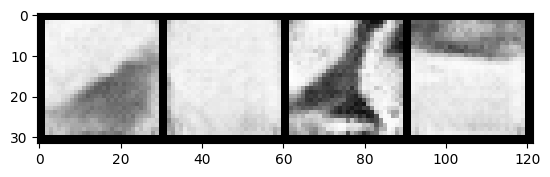

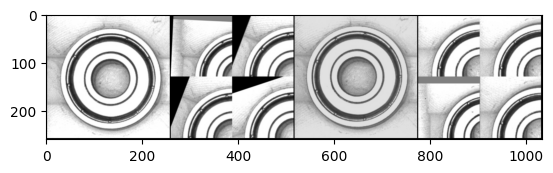

 92%|█████████▏| 312/338 [00:09<00:00, 34.71it/s]

Epoch 397, step 134500: Generator loss: 3.109715229868889, discriminator loss: 0.25961608931422214


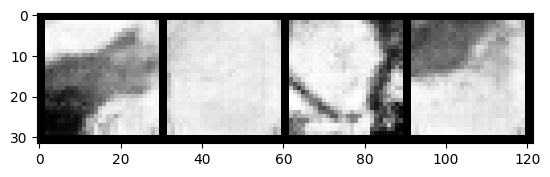

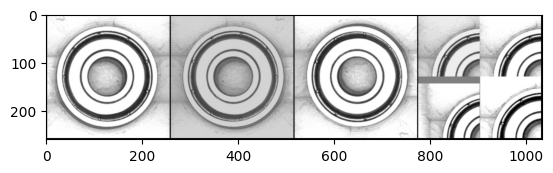

 40%|████      | 136/338 [00:03<00:05, 34.09it/s]

Epoch 399, step 135000: Generator loss: 2.9960020610094054, discriminator loss: 0.26686653267592186


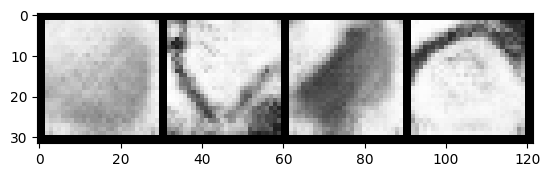

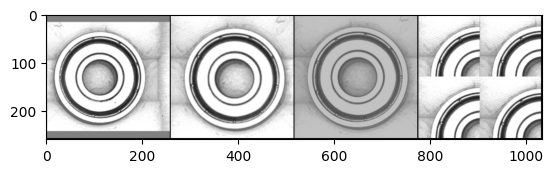

 89%|████████▉ | 300/338 [00:08<00:01, 33.68it/s]

Epoch 400, step 135500: Generator loss: 2.9933568777441977, discriminator loss: 0.26685207827389235


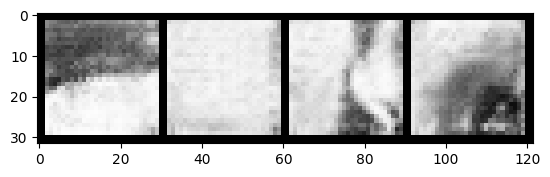

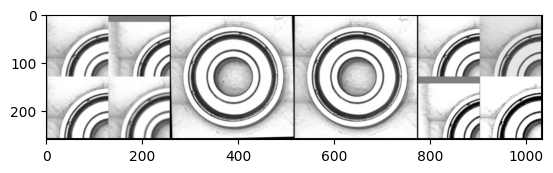

 37%|███▋      | 124/338 [00:03<00:06, 34.67it/s]

Epoch 402, step 136000: Generator loss: 2.987208922266963, discriminator loss: 0.23379183708131318


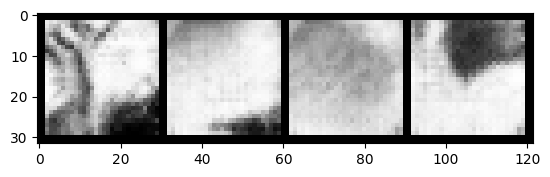

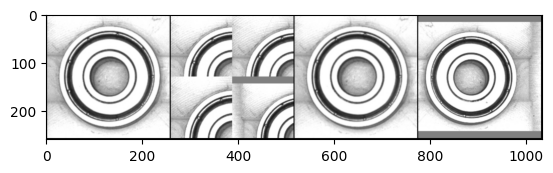

 84%|████████▍ | 284/338 [00:08<00:01, 31.59it/s]

Epoch 403, step 136500: Generator loss: 2.9736151684522634, discriminator loss: 0.2717968118190764


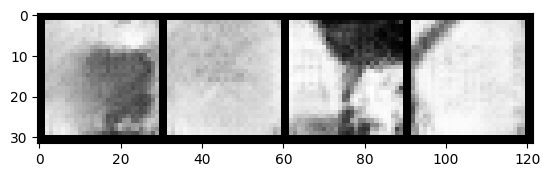

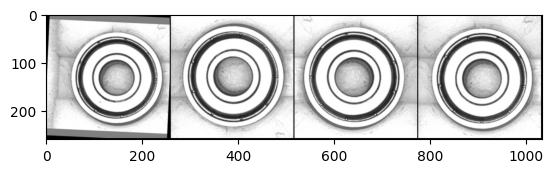

 32%|███▏      | 108/338 [00:03<00:06, 34.51it/s]

Epoch 405, step 137000: Generator loss: 3.004681798219679, discriminator loss: 0.2606440949887036


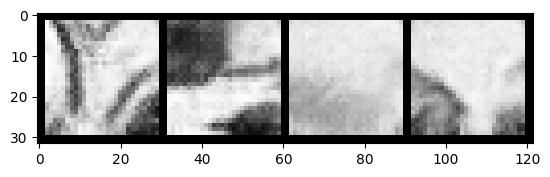

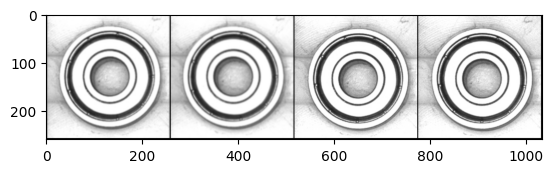

 80%|████████  | 272/338 [00:08<00:02, 32.45it/s]

Epoch 406, step 137500: Generator loss: 3.0556318852901483, discriminator loss: 0.24000367983430615


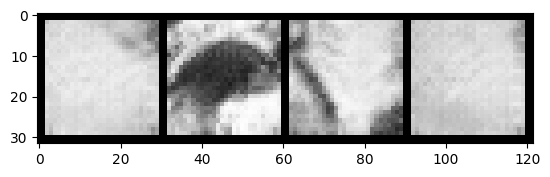

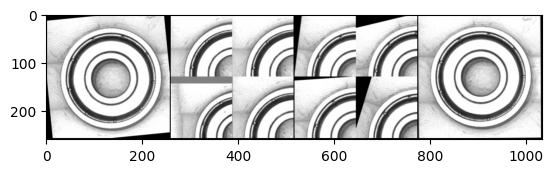

 28%|██▊       | 95/338 [00:02<00:07, 31.28it/s]

Epoch 408, step 138000: Generator loss: 2.9614942010045033, discriminator loss: 0.32025756123662025


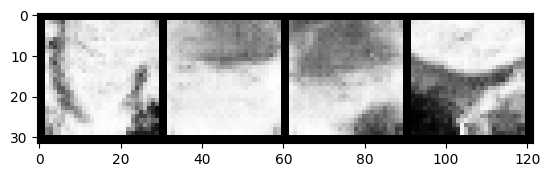

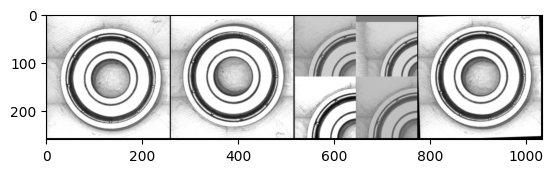

 76%|███████▌  | 256/338 [00:07<00:02, 34.31it/s]

Epoch 409, step 138500: Generator loss: 2.8344695525169357, discriminator loss: 0.25659826691448684


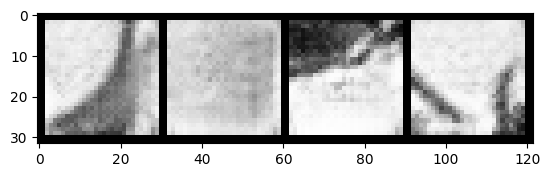

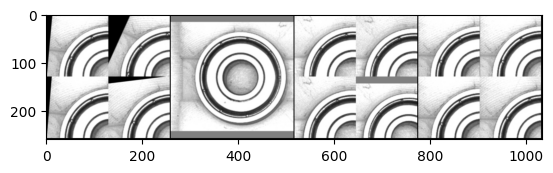

 24%|██▎       | 80/338 [00:02<00:07, 33.28it/s]

Epoch 411, step 139000: Generator loss: 3.023949597358704, discriminator loss: 0.251795361302793


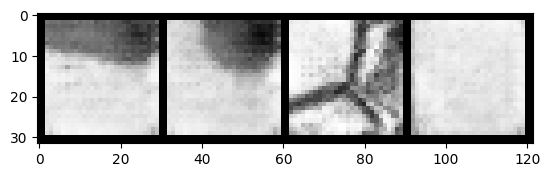

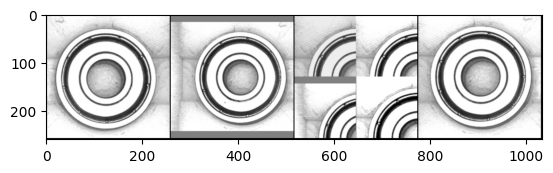

 72%|███████▏  | 244/338 [00:07<00:02, 32.84it/s]

Epoch 412, step 139500: Generator loss: 3.0190866743326223, discriminator loss: 0.24026850841939432


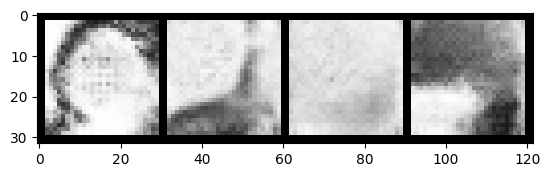

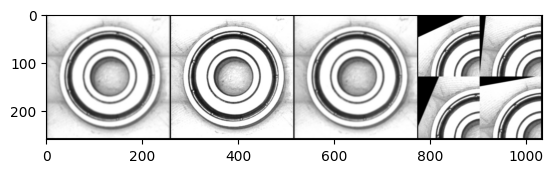

 20%|██        | 68/338 [00:02<00:08, 31.22it/s]

Epoch 414, step 140000: Generator loss: 2.903924743115899, discriminator loss: 0.2604162815734745


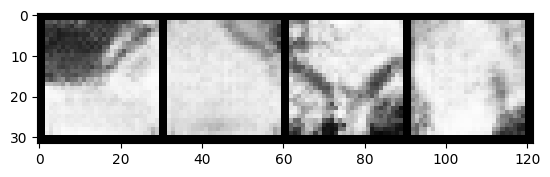

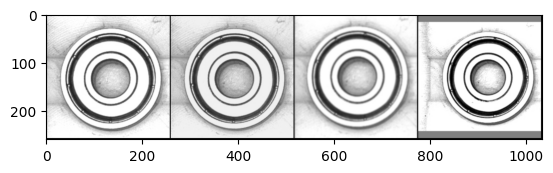

 67%|██████▋   | 228/338 [00:06<00:03, 36.09it/s]

Epoch 415, step 140500: Generator loss: 3.0794080919027293, discriminator loss: 0.23619689520448423


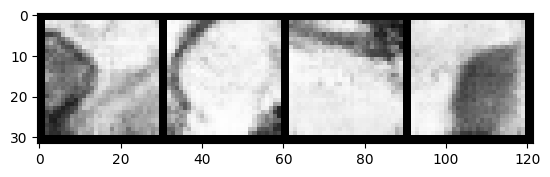

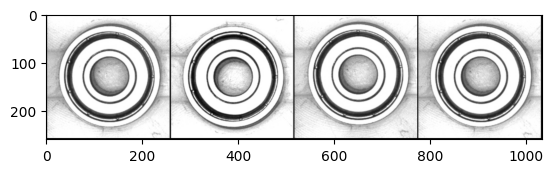

 15%|█▌        | 52/338 [00:01<00:08, 33.88it/s]

Epoch 417, step 141000: Generator loss: 3.058424853801728, discriminator loss: 0.2746809716224672


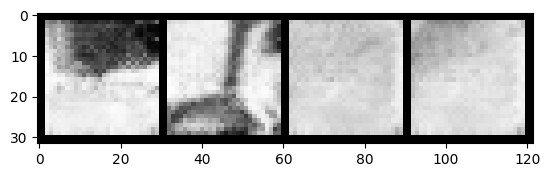

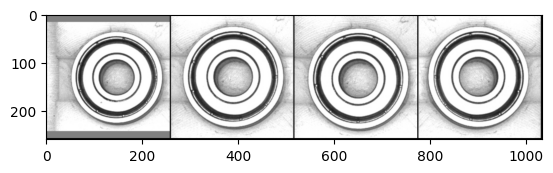

 64%|██████▍   | 216/338 [00:06<00:03, 31.28it/s]

Epoch 418, step 141500: Generator loss: 3.0933480768203725, discriminator loss: 0.29988287274539455


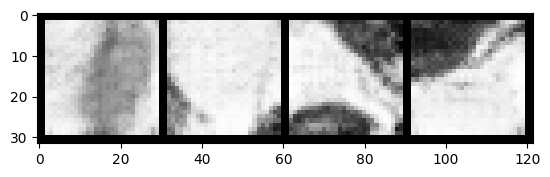

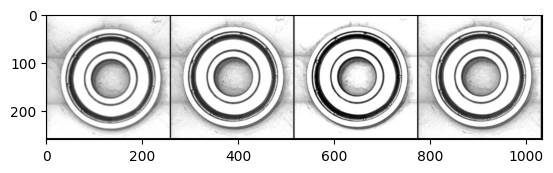

 12%|█▏        | 40/338 [00:01<00:08, 34.26it/s]

Epoch 420, step 142000: Generator loss: 3.0750268193483348, discriminator loss: 0.23578345711529244


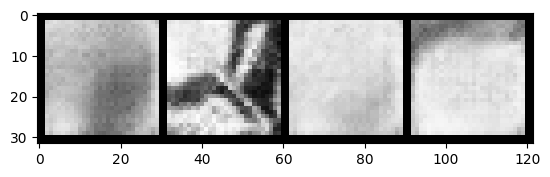

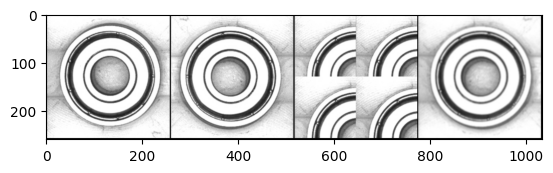

 59%|█████▉    | 200/338 [00:05<00:04, 33.93it/s]

Epoch 421, step 142500: Generator loss: 3.0149736062288266, discriminator loss: 0.23318621177226292


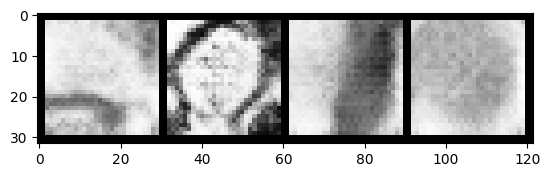

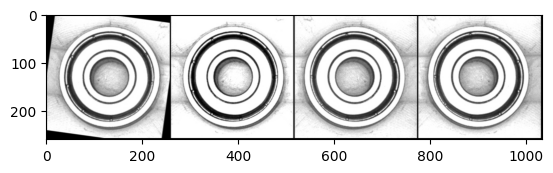

  7%|▋         | 24/338 [00:00<00:09, 34.40it/s]

Epoch 423, step 143000: Generator loss: 2.967500330567363, discriminator loss: 0.2544878442138434


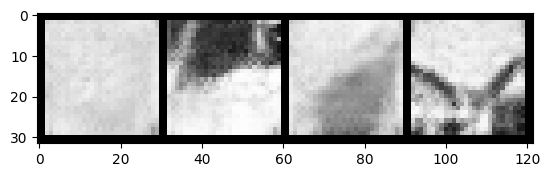

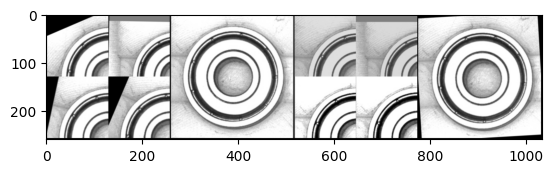

 56%|█████▌    | 188/338 [00:05<00:04, 33.56it/s]

Epoch 424, step 143500: Generator loss: 3.0163380395174015, discriminator loss: 0.2611092684864998


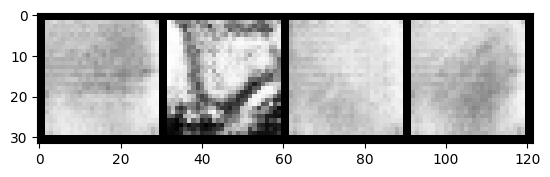

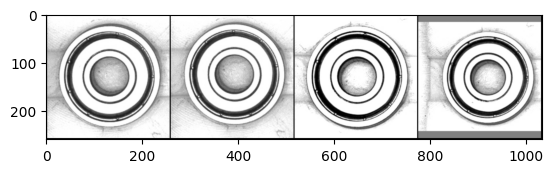

  4%|▎         | 12/338 [00:00<00:09, 33.77it/s]

Epoch 426, step 144000: Generator loss: 3.094279580175876, discriminator loss: 0.26086757460236554


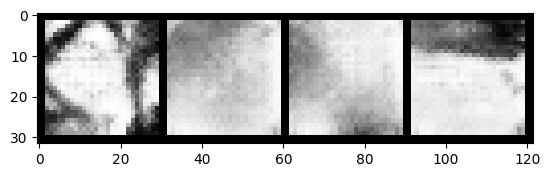

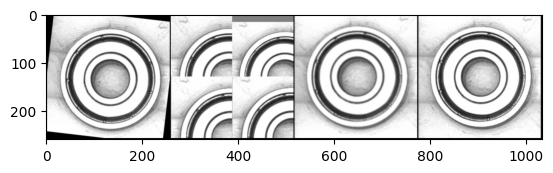

 51%|█████     | 172/338 [00:05<00:04, 33.35it/s]

Epoch 427, step 144500: Generator loss: 2.988283795952799, discriminator loss: 0.23982253578305265


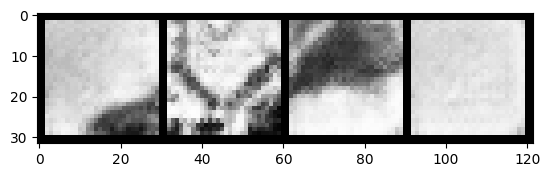

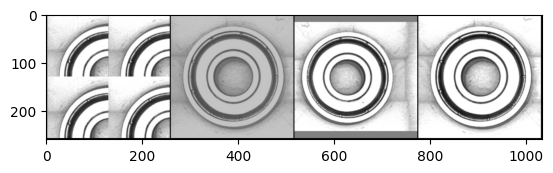

 99%|█████████▉| 336/338 [00:10<00:00, 33.81it/s]

Epoch 428, step 145000: Generator loss: 2.9524550009965904, discriminator loss: 0.2386769643202425


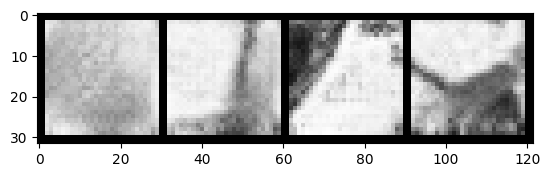

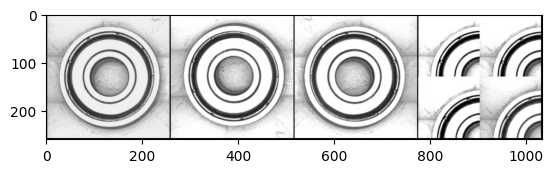

 47%|████▋     | 160/338 [00:04<00:05, 33.70it/s]

Epoch 430, step 145500: Generator loss: 3.0230842044353485, discriminator loss: 0.23437039977312096


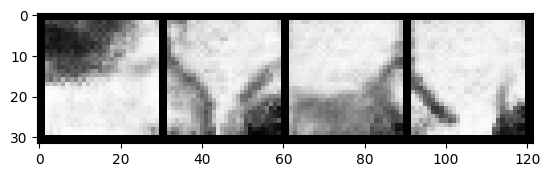

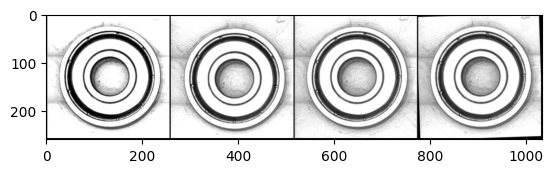

 95%|█████████▍| 320/338 [00:09<00:00, 34.11it/s]

Epoch 431, step 146000: Generator loss: 3.0157564332485216, discriminator loss: 0.24349387438595285


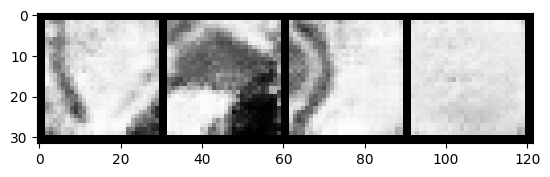

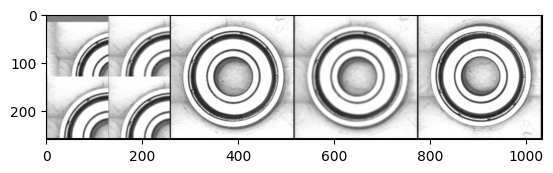

 43%|████▎     | 144/338 [00:04<00:05, 34.39it/s]

Epoch 433, step 146500: Generator loss: 3.182804096221926, discriminator loss: 0.25300866768509156


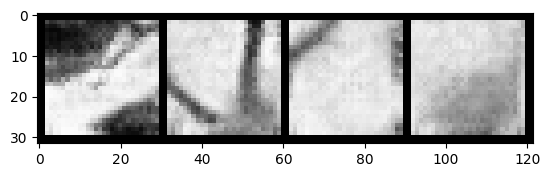

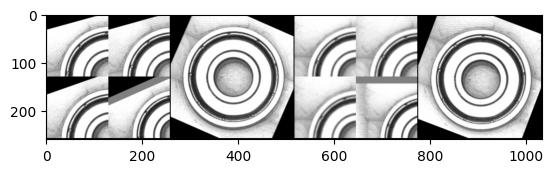

 91%|█████████ | 308/338 [00:09<00:00, 33.86it/s]

Epoch 434, step 147000: Generator loss: 3.0240086387395886, discriminator loss: 0.2822090613543989


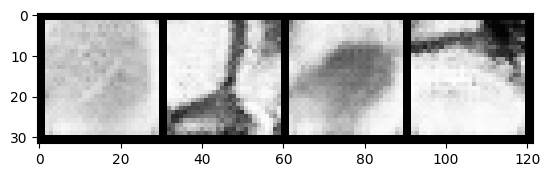

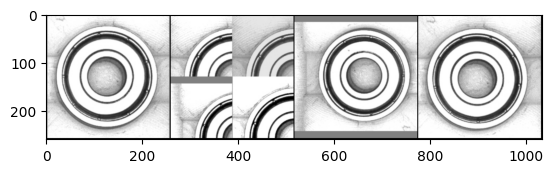

 39%|███▉      | 132/338 [00:03<00:05, 34.50it/s]

Epoch 436, step 147500: Generator loss: 3.1121737859845156, discriminator loss: 0.2459454441145061


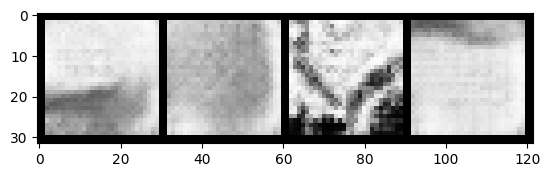

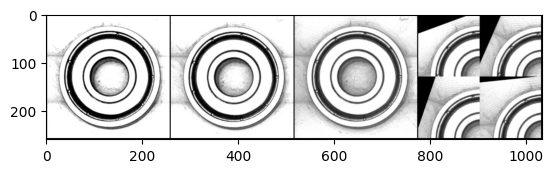

 86%|████████▋ | 292/338 [00:08<00:01, 34.33it/s]

Epoch 437, step 148000: Generator loss: 3.085694885253907, discriminator loss: 0.2964143553823232


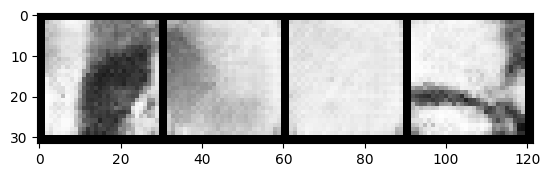

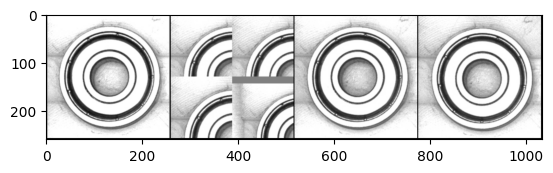

 34%|███▍      | 115/338 [00:03<00:06, 33.71it/s]

Epoch 439, step 148500: Generator loss: 3.1514088991880382, discriminator loss: 0.23577399438619626


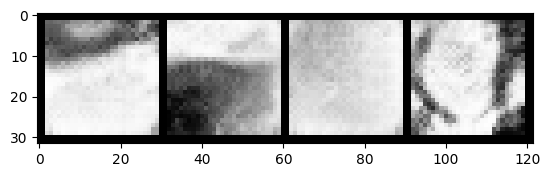

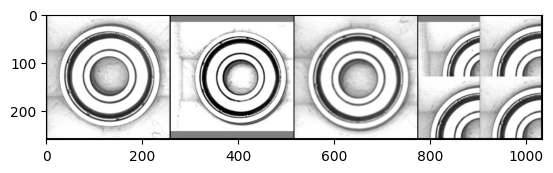

 83%|████████▎ | 280/338 [00:08<00:01, 34.07it/s]

Epoch 440, step 149000: Generator loss: 3.049231122493742, discriminator loss: 0.2423022312298418


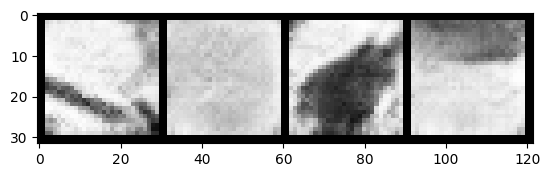

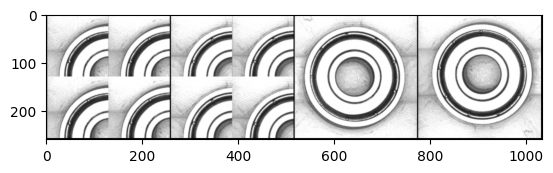

 31%|███       | 104/338 [00:03<00:06, 34.00it/s]

Epoch 442, step 149500: Generator loss: 3.0589900321960473, discriminator loss: 0.24544650021195438


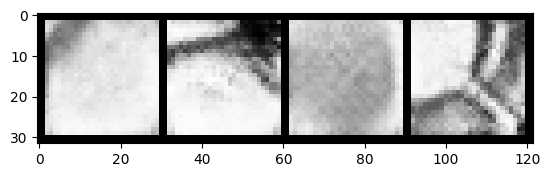

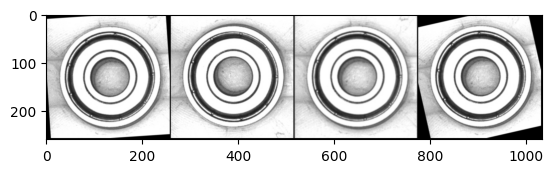

 78%|███████▊  | 264/338 [00:07<00:02, 34.74it/s]

Epoch 443, step 150000: Generator loss: 3.0888736338615446, discriminator loss: 0.2311525004729629


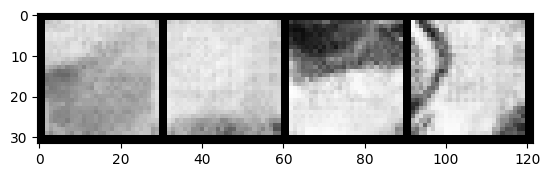

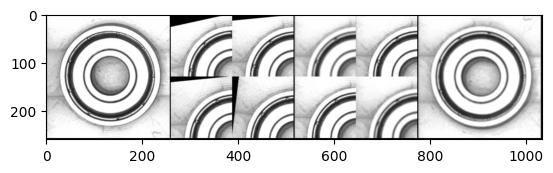

 26%|██▌       | 88/338 [00:02<00:07, 32.48it/s]

Epoch 445, step 150500: Generator loss: 3.0961509540080994, discriminator loss: 0.24527810417115675


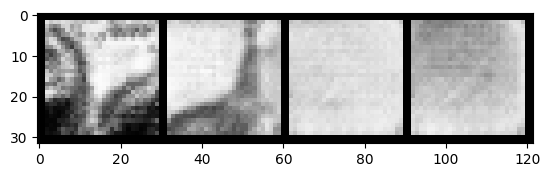

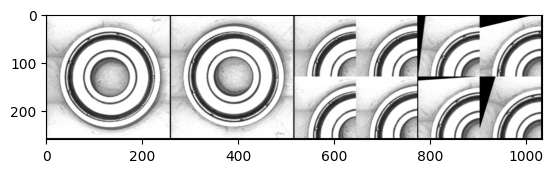

 75%|███████▍  | 252/338 [00:07<00:02, 34.14it/s]

Epoch 446, step 151000: Generator loss: 3.2343973835706694, discriminator loss: 0.2471568057760597


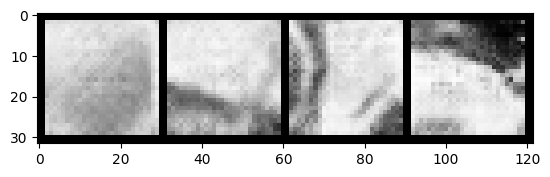

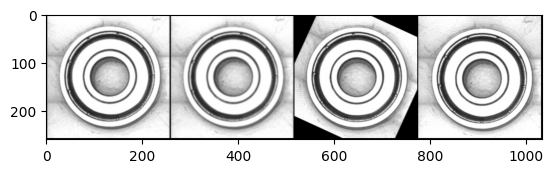

 22%|██▏       | 76/338 [00:02<00:07, 34.55it/s]

Epoch 448, step 151500: Generator loss: 3.1567086367607144, discriminator loss: 0.24637168801575926


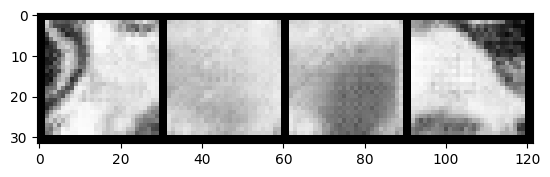

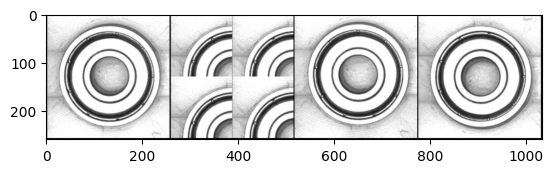

 70%|██████▉   | 236/338 [00:06<00:02, 35.00it/s]

Epoch 449, step 152000: Generator loss: 2.9102357833385475, discriminator loss: 0.2582646267712115


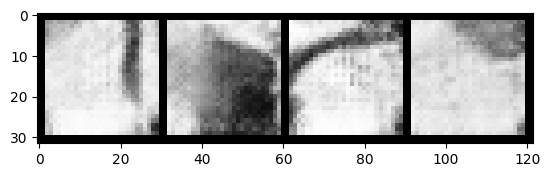

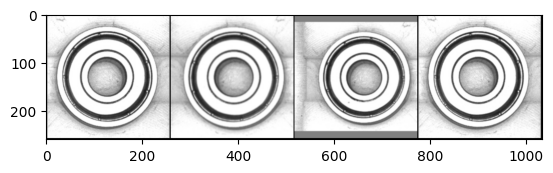

 18%|█▊        | 60/338 [00:01<00:08, 33.23it/s]

Epoch 451, step 152500: Generator loss: 3.0131394916772836, discriminator loss: 0.24135436969995494


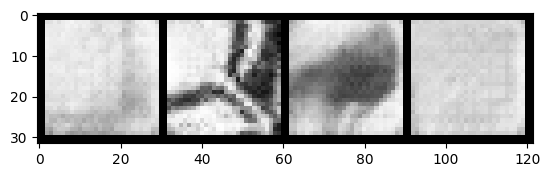

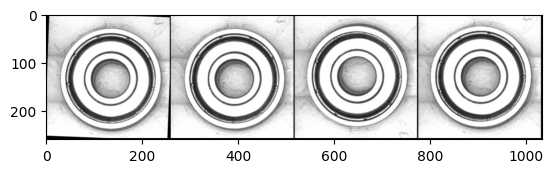

 66%|██████▋   | 224/338 [00:06<00:03, 34.95it/s]

Epoch 452, step 153000: Generator loss: 3.0747631598711, discriminator loss: 0.2722344261407851


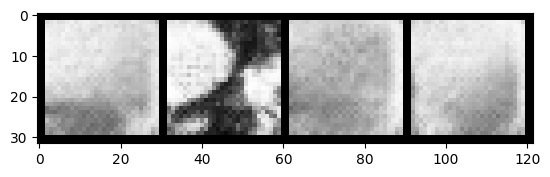

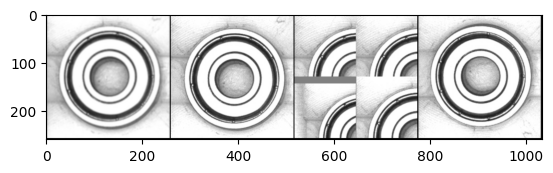

 14%|█▍        | 48/338 [00:01<00:08, 34.50it/s]

Epoch 454, step 153500: Generator loss: 3.0795730775594694, discriminator loss: 0.2423800285607575


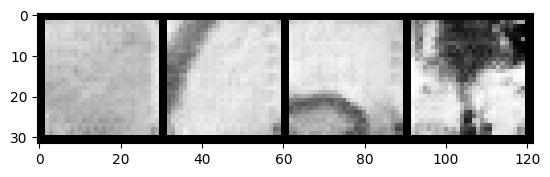

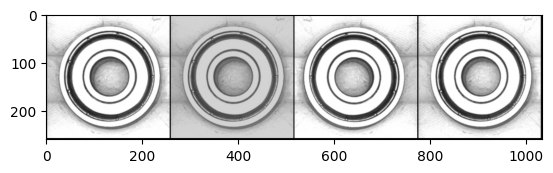

 62%|██████▏   | 208/338 [00:06<00:04, 31.21it/s]

Epoch 455, step 154000: Generator loss: 3.1189832824468615, discriminator loss: 0.2353408942520619


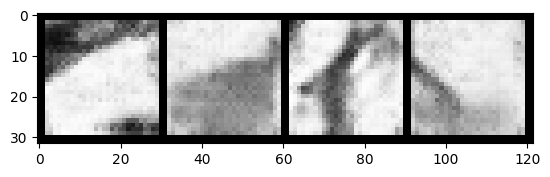

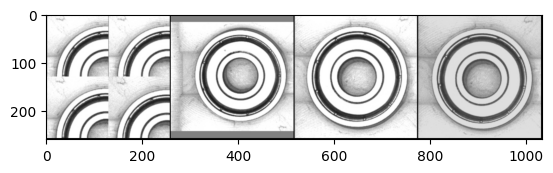

  9%|▉         | 32/338 [00:00<00:09, 33.20it/s]

Epoch 457, step 154500: Generator loss: 3.02312048280239, discriminator loss: 0.2502932930365204


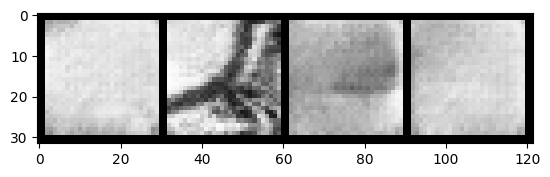

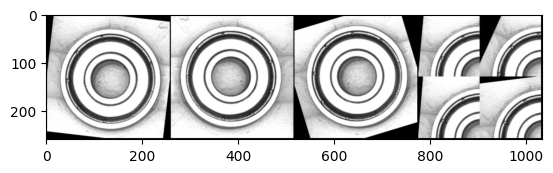

 58%|█████▊    | 196/338 [00:05<00:04, 33.59it/s]

Epoch 458, step 155000: Generator loss: 3.029093783497811, discriminator loss: 0.24364268768578776


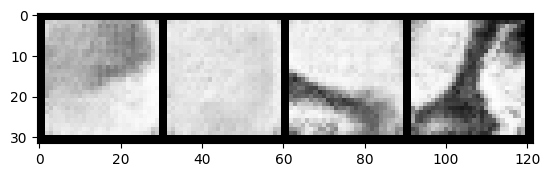

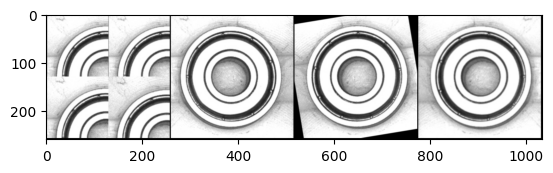

  6%|▌         | 19/338 [00:00<00:09, 34.03it/s]

Epoch 460, step 155500: Generator loss: 3.13346234369278, discriminator loss: 0.2320786723420021


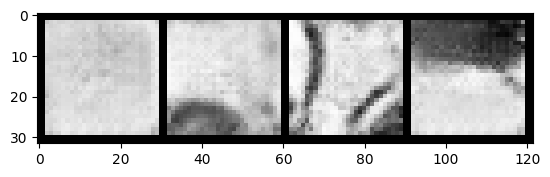

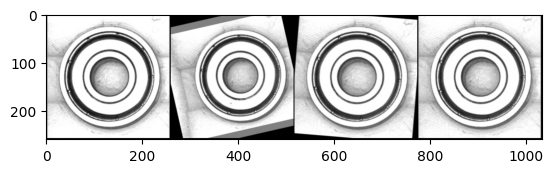

 53%|█████▎    | 180/338 [00:05<00:04, 34.43it/s]

Epoch 461, step 156000: Generator loss: 3.019252934575084, discriminator loss: 0.2455067398697138


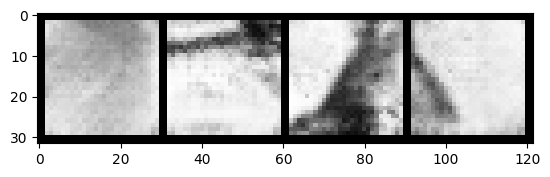

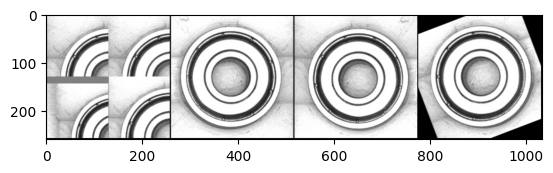

  1%|          | 4/338 [00:00<00:09, 34.41it/s]

Epoch 463, step 156500: Generator loss: 3.0150350651740996, discriminator loss: 0.2808214877024292


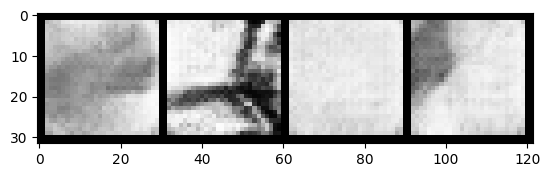

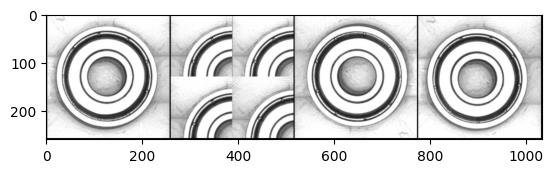

 50%|████▉     | 168/338 [00:05<00:05, 32.91it/s]

Epoch 464, step 157000: Generator loss: 3.025760493516923, discriminator loss: 0.2297577138841152


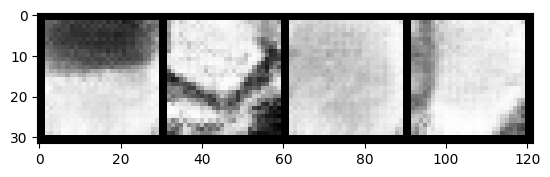

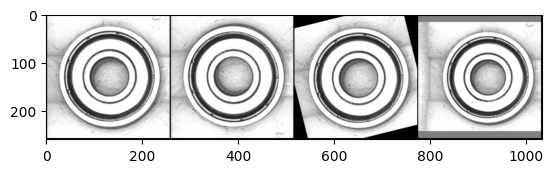

 97%|█████████▋| 328/338 [00:09<00:00, 29.89it/s]

Epoch 465, step 157500: Generator loss: 3.1590545916557335, discriminator loss: 0.24517773028463138


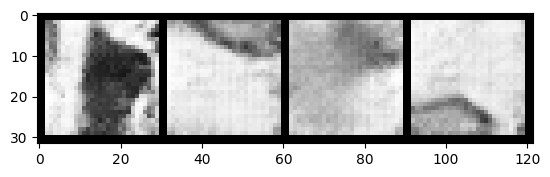

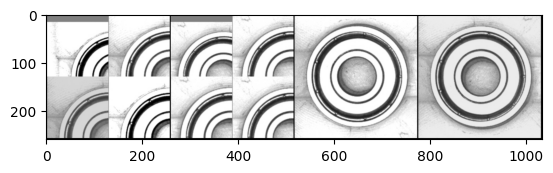

 45%|████▍     | 152/338 [00:04<00:05, 34.18it/s]

Epoch 467, step 158000: Generator loss: 2.8062792665958387, discriminator loss: 0.28693501643836516


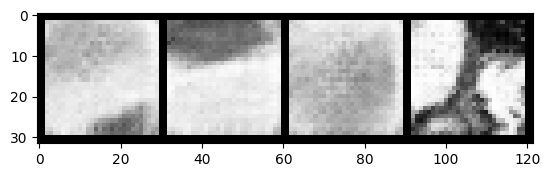

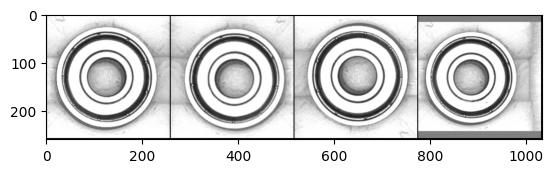

 93%|█████████▎| 315/338 [00:09<00:00, 33.36it/s]

Epoch 468, step 158500: Generator loss: 2.8182664134502375, discriminator loss: 0.2694166815131905


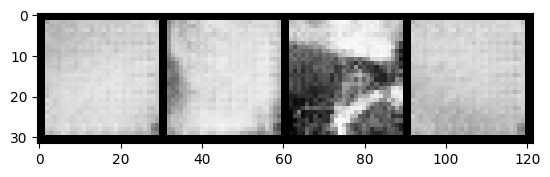

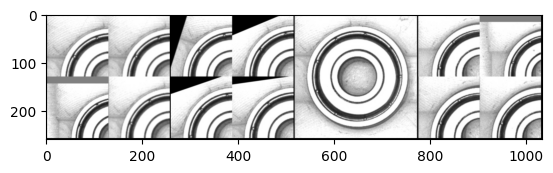

 41%|████▏     | 140/338 [00:04<00:05, 34.39it/s]

Epoch 470, step 159000: Generator loss: 2.917694724559781, discriminator loss: 0.2587956128939986


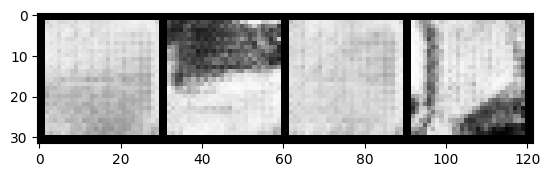

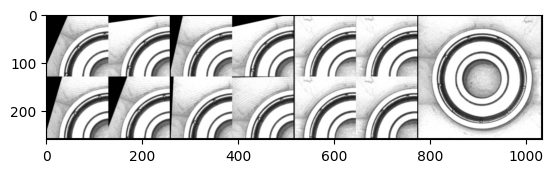

 89%|████████▉ | 300/338 [00:08<00:01, 33.33it/s]

Epoch 471, step 159500: Generator loss: 2.92240489923954, discriminator loss: 0.2572725688815115


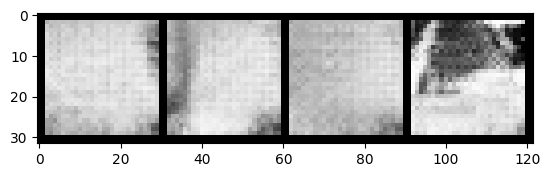

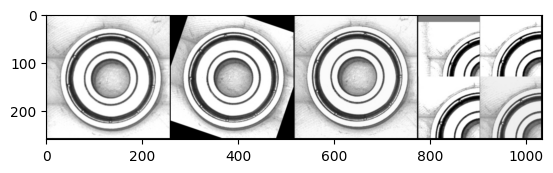

 37%|███▋      | 124/338 [00:03<00:06, 32.77it/s]

Epoch 473, step 160000: Generator loss: 2.8144312963485723, discriminator loss: 0.25808745100349173


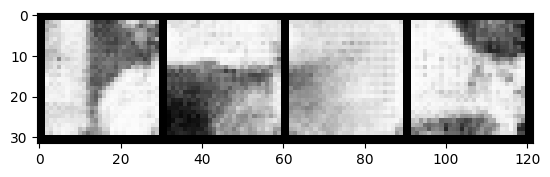

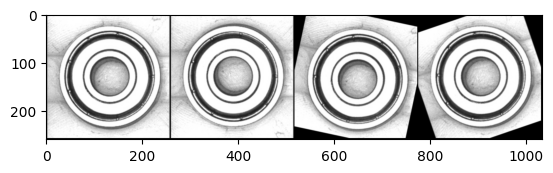

 85%|████████▌ | 288/338 [00:08<00:01, 33.66it/s]

Epoch 474, step 160500: Generator loss: 2.9456790947914087, discriminator loss: 0.27095007812976835


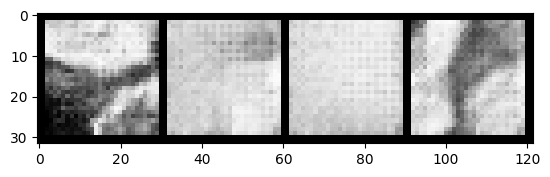

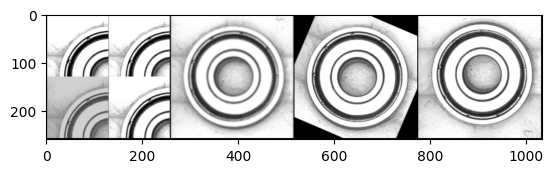

 33%|███▎      | 112/338 [00:03<00:06, 34.23it/s]

Epoch 476, step 161000: Generator loss: 2.933535345315932, discriminator loss: 0.2549675932228565


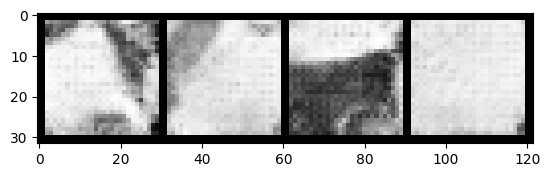

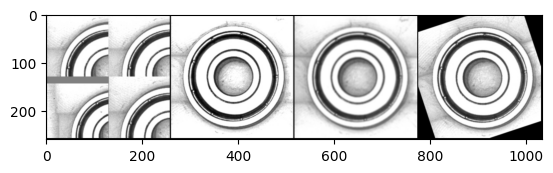

 80%|████████  | 272/338 [00:07<00:01, 33.61it/s]

Epoch 477, step 161500: Generator loss: 2.960023570775984, discriminator loss: 0.25188907469809063


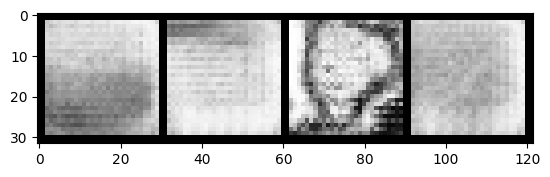

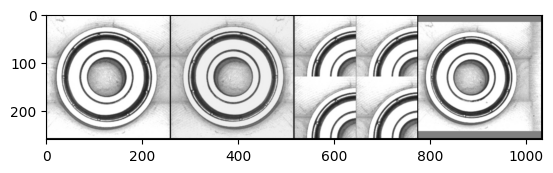

 28%|██▊       | 96/338 [00:02<00:07, 34.47it/s]

Epoch 479, step 162000: Generator loss: 3.0751617465019208, discriminator loss: 0.2642602542936802


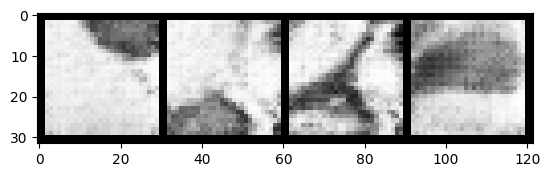

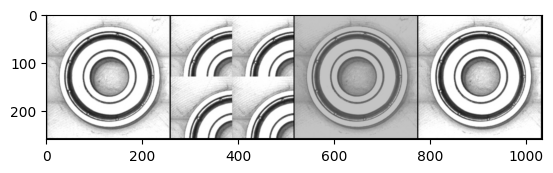

 77%|███████▋  | 260/338 [00:07<00:02, 33.69it/s]

Epoch 480, step 162500: Generator loss: 3.066205137968061, discriminator loss: 0.24018346574902522


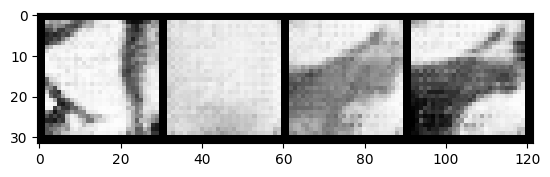

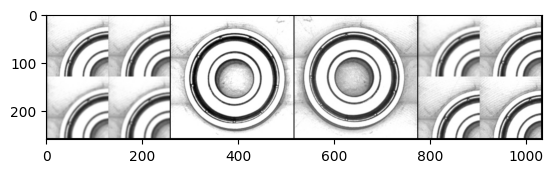

 25%|██▍       | 84/338 [00:02<00:07, 34.54it/s]

Epoch 482, step 163000: Generator loss: 3.0613997461795814, discriminator loss: 0.23929954461753358


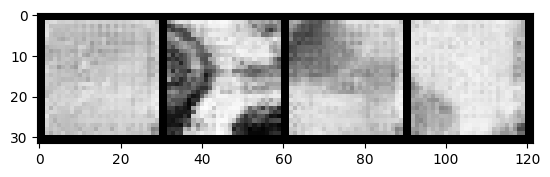

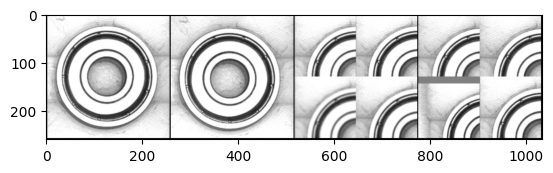

 72%|███████▏  | 244/338 [00:07<00:02, 33.70it/s]

Epoch 483, step 163500: Generator loss: 2.8828952543735475, discriminator loss: 0.2511564698964356


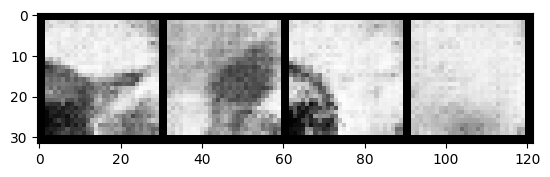

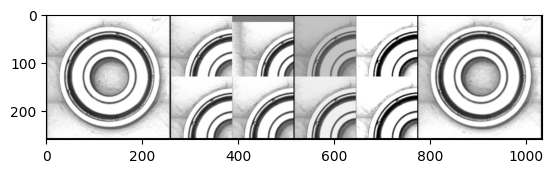

 20%|██        | 68/338 [00:02<00:07, 34.53it/s]

Epoch 485, step 164000: Generator loss: 2.9893301377296413, discriminator loss: 0.2171506122499704


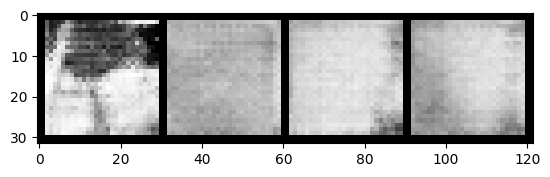

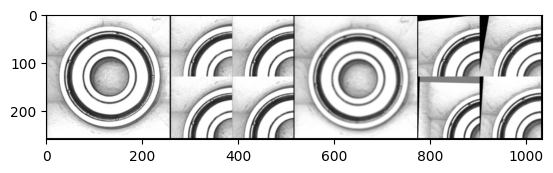

 68%|██████▊   | 231/338 [00:06<00:03, 32.51it/s]

Epoch 486, step 164500: Generator loss: 3.1354877879619605, discriminator loss: 0.22474949975311748


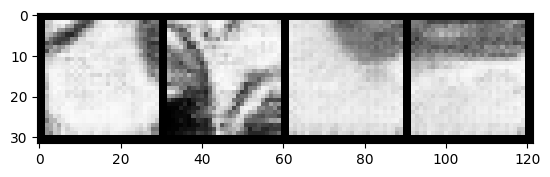

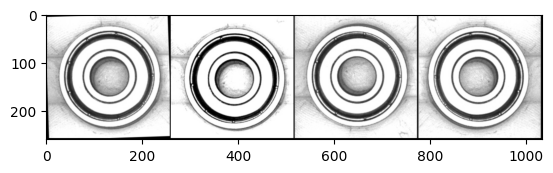

 17%|█▋        | 56/338 [00:01<00:08, 33.83it/s]

Epoch 488, step 165000: Generator loss: 3.026197420835497, discriminator loss: 0.2381432118564846


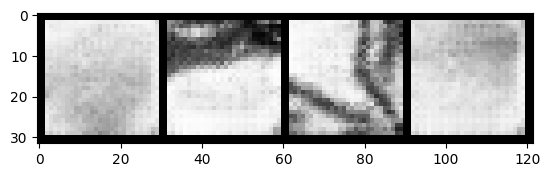

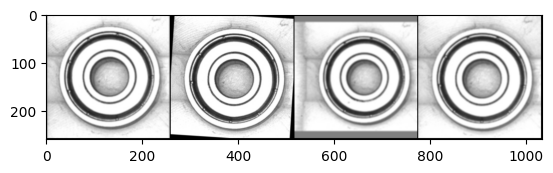

 64%|██████▍   | 216/338 [00:06<00:03, 34.88it/s]

Epoch 489, step 165500: Generator loss: 3.0986067070960996, discriminator loss: 0.22666215077787624


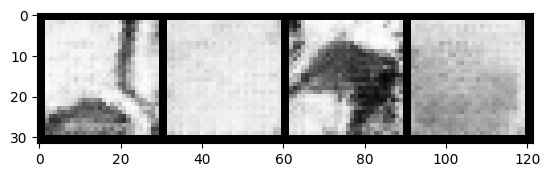

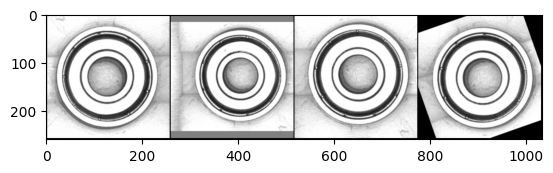

 12%|█▏        | 40/338 [00:01<00:08, 35.55it/s]

Epoch 491, step 166000: Generator loss: 3.09367488694191, discriminator loss: 0.23047559346258625


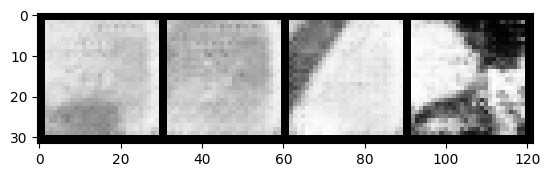

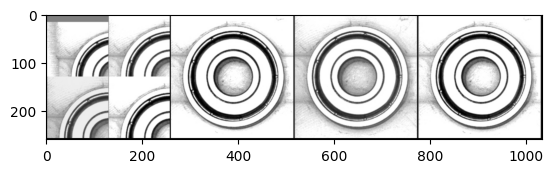

 60%|██████    | 204/338 [00:06<00:03, 33.65it/s]

Epoch 492, step 166500: Generator loss: 3.1004237928390515, discriminator loss: 0.22072041068971157


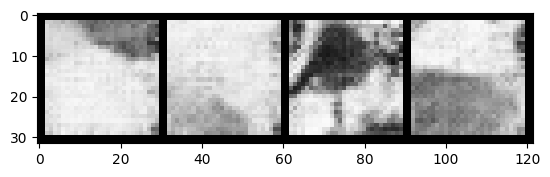

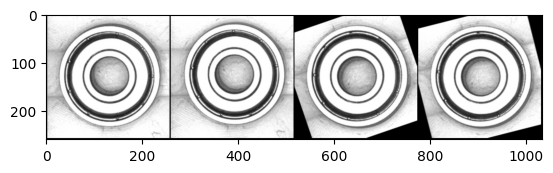

  8%|▊         | 28/338 [00:00<00:09, 32.41it/s]

Epoch 494, step 167000: Generator loss: 3.0830753695964854, discriminator loss: 0.24282009963691248


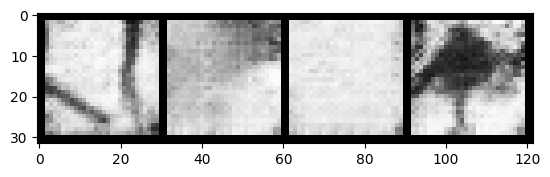

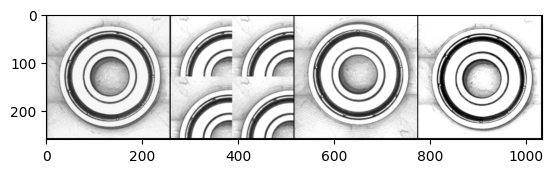

 56%|█████▌    | 188/338 [00:05<00:04, 33.66it/s]

Epoch 495, step 167500: Generator loss: 3.161799650788306, discriminator loss: 0.2294695012420416


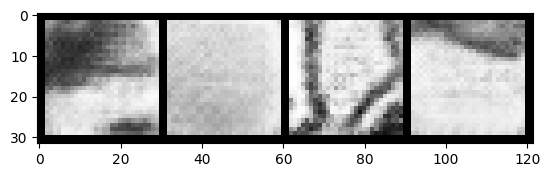

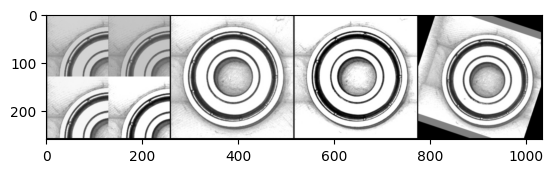

  4%|▎         | 12/338 [00:00<00:09, 33.12it/s]

Epoch 497, step 168000: Generator loss: 3.2209268630742995, discriminator loss: 0.23187262283265592


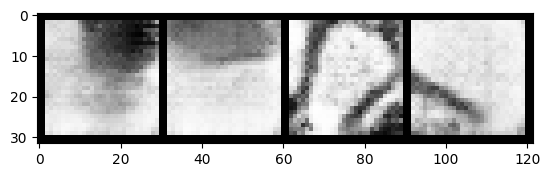

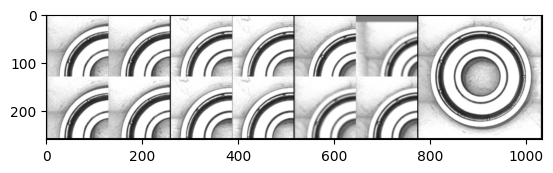

 52%|█████▏    | 176/338 [00:05<00:04, 33.61it/s]

Epoch 498, step 168500: Generator loss: 3.0954448992013925, discriminator loss: 0.2558997163549066


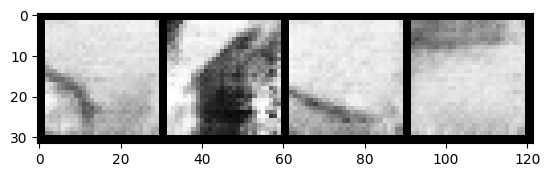

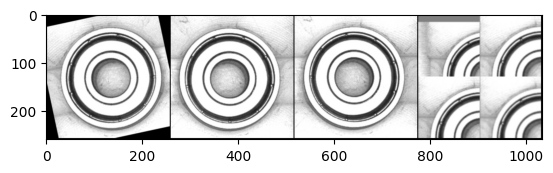

100%|██████████| 338/338 [00:09<00:00, 33.96it/s]


In [23]:
n_epochs = 500
cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        ## Update discriminator ##
        disc_opt.zero_grad()
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        fake = gen(fake_noise)
        disc_fake_pred = disc(fake.detach())
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_pred = disc(real)
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2

        # Keep track of the average discriminator loss
        mean_discriminator_loss += disc_loss.item() / display_step
        # Update gradients
        disc_loss.backward(retain_graph=True)
        # Update optimizer
        disc_opt.step()

        ## Update generator ##
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        disc_fake_pred = disc(fake_2)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the average generator loss
        mean_generator_loss += gen_loss.item() / display_step

        ## Visualization code ##
        if cur_step % display_step == 0 and cur_step > 0:
            print(f"Epoch {epoch}, step {cur_step}: Generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}")
            show_tensor_images(fake)
            show_tensor_images(real)
            mean_generator_loss = 0
            mean_discriminator_loss = 0
        cur_step += 1
